# Imports and Utils

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

In [ ]:
import pandas as pd
import re
from tqdm import tqdm
tqdm.pandas()

import warnings
warnings.filterwarnings(action='ignore')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
basepath = "/content/drive/MyDrive/DataMining22Gruppo8/data/dataset"

In [ ]:
!sudo apt-get install texlive-latex-extra texlive-fonts-recommended dvipng cm-super

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following additional packages will be installed:
  cm-super-minimal fonts-droid-fallback fonts-lato fonts-lmodern
  fonts-noto-mono fonts-texgyre ghostscript gsfonts javascript-common
  libcupsfilters1 libcupsimage2 libgs9 libgs9-common libijs-0.35 libjbig2dec0
  libjs-jquery libkpathsea6 libpotrace0 libptexenc1 libruby2.5 libsynctex1
  libtexlua52 libtexluajit2 libzzip-0-13 lmodern pfb2t1c2pfb poppler-data
  preview-latex-style rake ruby ruby-did-you-mean ruby-minitest
  ruby-net-telnet ruby-power-assert ruby-test-unit ruby2.5
  rubygems-integration t1utils tex-common tex-gyre texlive-base
  texlive-binaries texlive-latex-base texlive-latex-recommended
  texlive-pictures texlive-plain-generic tipa
Suggested packages:
  fonts-noto ghostscript-x apach

In [ ]:
!pip install tslearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 875 kB 5.0 MB/s 


#Visualization functions

In [ ]:
def visualize(data=None, x=None, y=None, xlabel=None, ylabel=None, title=None, plot_type="plot", ax=None, **kwargs):
  plts = ['plot', 'hist', 'scatter', 'boxplot', 'barplot']
  if plot_type not in plts:
      raise ValueError("Invalid plot type. Expected one of: %s" % plts)
  
  if(plot_type == "scatter"):
    sns.scatterplot(data=data, x=x, y=y, ax=ax, **kwargs)
  elif(plot_type == "plot"):
    sns.lineplot(data=data, x=x, y=y, ax=ax, **kwargs)
  elif(plot_type == "hist"):
    sns.histplot(data=data, x=x, y=y, ax=ax, **kwargs)
  elif(plot_type == "boxplot"):
    sns.boxplot(data=data, x=x, y=y, ax=ax, **kwargs)
  elif(plot_type == "barplot"):
    sns.barplot(data=data, x=x, y=y, ax=ax, **kwargs)

  plt.xlabel(xlabel, fontsize=14)
  plt.ylabel(ylabel, fontsize=14)
  plt.title(title, fontsize=16)
  plt.tick_params(axis='both', which='major', labelsize=14)

In [ ]:
class Correlation():
  def __init__(self,df):
    self.df = df

  def compute(self,frac):
    self.mx = self.df.sample(frac=frac).corr()
  
  def heatmap(self, dim):
    fig, ax = plt.subplots(figsize=(dim, dim))
    im = ax.imshow(self.mx)
    im.set_clim(-1,1)
    fig.colorbar(im, orientation='vertical', fraction = 0.05)

    # Show and rotate ticks
    plt.xticks(np.arange(len(self.mx.columns)),self.mx.columns, rotation=90, fontsize=15)
    plt.yticks(np.arange(len(self.mx.index)),self.mx.index, rotation=0, fontsize=15)

    # Add numerical values
    for i in range(len(self.mx.columns)):
        for j in range(len(self.mx.index)):
            text = ax.text(j, i, round(self.mx.to_numpy()[i, j], 1),
                          ha="center", va="center", color="black")

    plt.show()


In [ ]:
from itertools import combinations

def cluster_plots(df): 
  plots = list(combinations([key for key in df.keys()], 2))
  
  for x,y in plots:
    plt.figure(figsize=(9,6))
    visualize(x=df[x][dbscan.labels_ != -1], y=df[y][dbscan.labels_ != -1], 
            plot_type='scatter', c=dbscan.labels_[dbscan.labels_ != -1], xlabel=x, ylabel=y,
            title="{} over {}".format(x, y)) 
    plt.show

# 2 Clustering

## 2.1 Determining users' metrics for clustering

In [ ]:
users_full = pd.read_csv(basepath + '/users_full_1.9.9.csv', lineterminator='\n', index_col=0, parse_dates=['sign_up_date'])

We want to select the feature for clustering. Let's start with the entropies of the various columns. We prefer attributes with higher entropies since they carry more information

In [ ]:
from math import e

In [ ]:
def column_entropy(column):
    vc = pd.Series(column).value_counts(normalize=True, sort=False) #Take the frequency of each value
    return -(vc * np.log2(vc)).sum()

In [ ]:
columns = users_full.keys()
entropies = [-column_entropy(users_full[column].tolist()) for column in columns]
entropies, columns = zip(*sorted(zip(entropies, columns)))
entropies = [-x for x in entropies]
columns = [column for column in columns]

In [ ]:
[len(users_full[column].value_counts()) for column in columns]

[11402,
 11357,
 11369,
 10996,
 10185,
 9016,
 7096,
 6875,
 5573,
 7398,
 7203,
 6506,
 6506,
 5814,
 5814,
 3917,
 2237,
 5406,
 4842,
 2065,
 4817,
 5238,
 4758,
 1443,
 4102,
 1416,
 1158,
 1055,
 1965,
 4108,
 3320,
 1506,
 2554,
 729,
 363,
 1696,
 679,
 234,
 386,
 2,
 18,
 223,
 126,
 72,
 10,
 3]

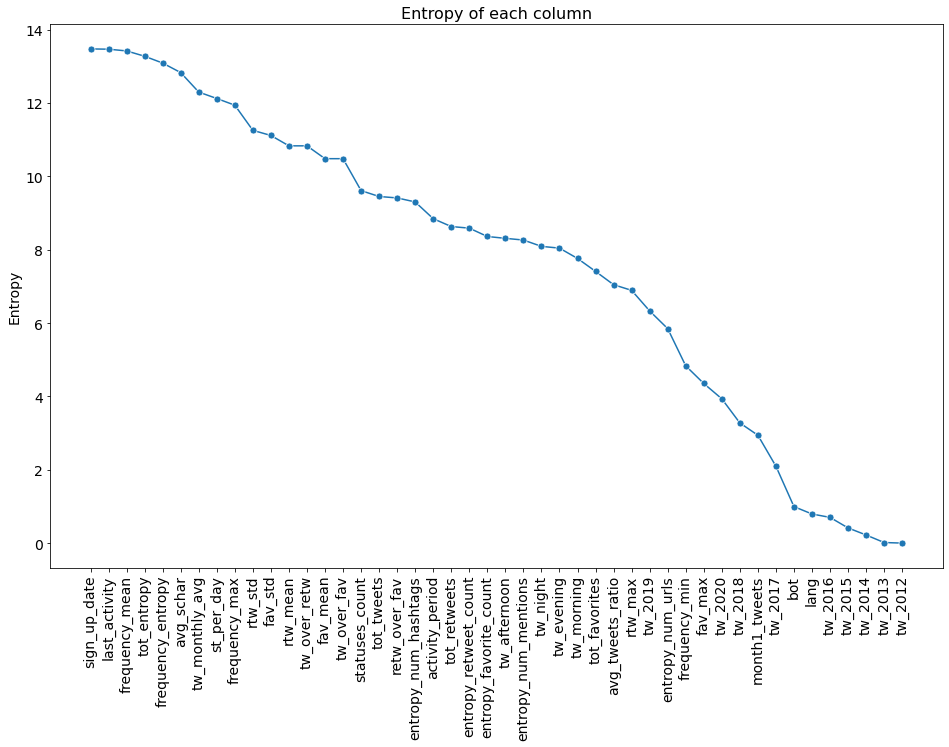

In [ ]:
plt.figure(figsize=(16, 10))
visualize(x=columns, y=entropies, ylabel='Entropy', title='Entropy of each column',
          plot_type="plot", marker='.', markersize=14)
plt.xticks(rotation=90)
plt.show()

We obviously drop categorical columns (bot), non-numerical columns (lang, sign_up_date and last_activity) and columns with low entropy.

In [ ]:
users_full.drop(columns=columns[-10:], inplace=True)

In [ ]:
users_full.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11487 entries, 2353593986 to 933183398
Data columns (total 36 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   sign_up_date            11487 non-null  datetime64[ns]
 1   statuses_count          11487 non-null  float64       
 2   st_per_day              11487 non-null  float64       
 3   tot_tweets              11487 non-null  int64         
 4   tot_favorites           11487 non-null  float64       
 5   tot_retweets            11487 non-null  float64       
 6   fav_std                 11487 non-null  float64       
 7   rtw_std                 11487 non-null  float64       
 8   fav_max                 11487 non-null  float64       
 9   rtw_max                 11487 non-null  float64       
 10  fav_mean                11487 non-null  float64       
 11  rtw_mean                11487 non-null  float64       
 12  retw_over_fav           11487 non

In [ ]:
users_full.drop(columns=["sign_up_date", "last_activity"], inplace=True)

Now we analyze attributes correlation

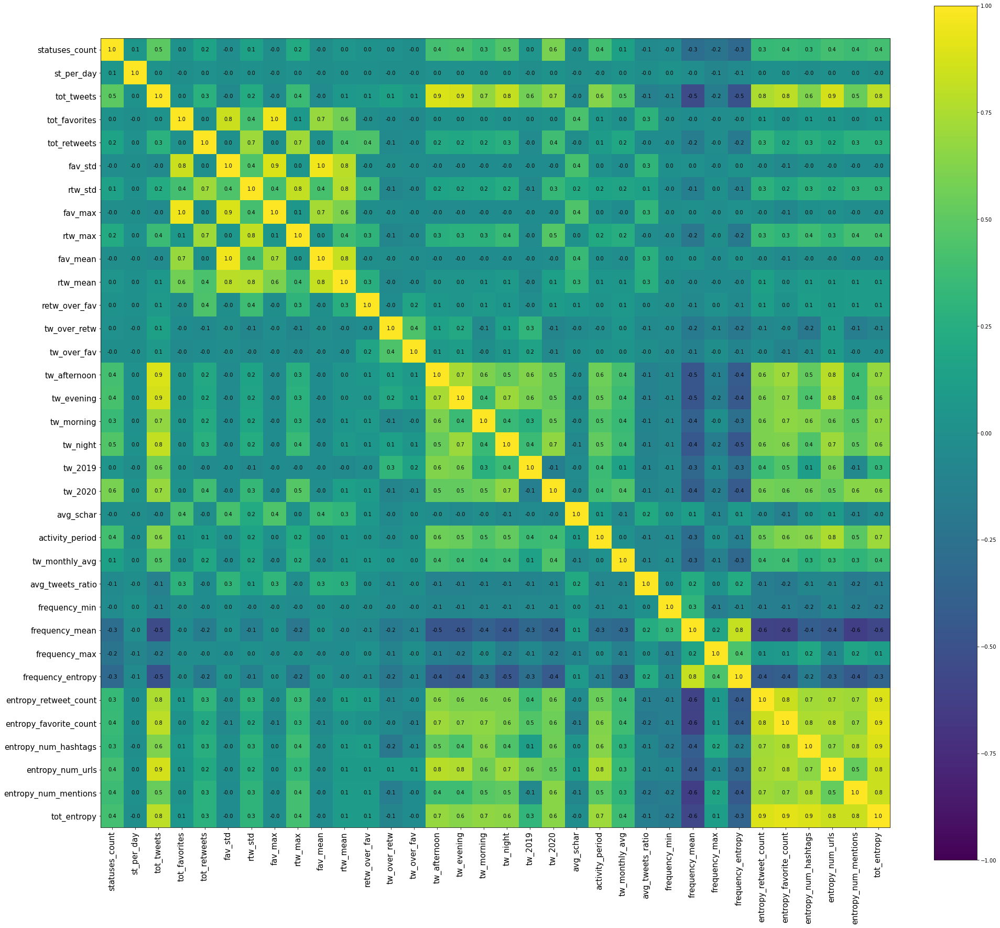

In [ ]:
users_correlation_matrix = Correlation(users_full)
users_correlation_matrix.compute(1)
users_correlation_matrix.heatmap(30)

We can observe a lot of correlations. First of all, there is a square in the right-lower corner of the matrix. The entropies are higly correlated and almost all of them are higly correlated with tot_tweets. In general these columns have other non-negligible correlations. So, we decide to drop them all but tot_entropy:

In [ ]:
users_full.drop(columns=["entropy_num_mentions", "entropy_num_urls", "entropy_num_hashtags", "entropy_favorite_count", "entropy_retweet_count"], inplace=True)

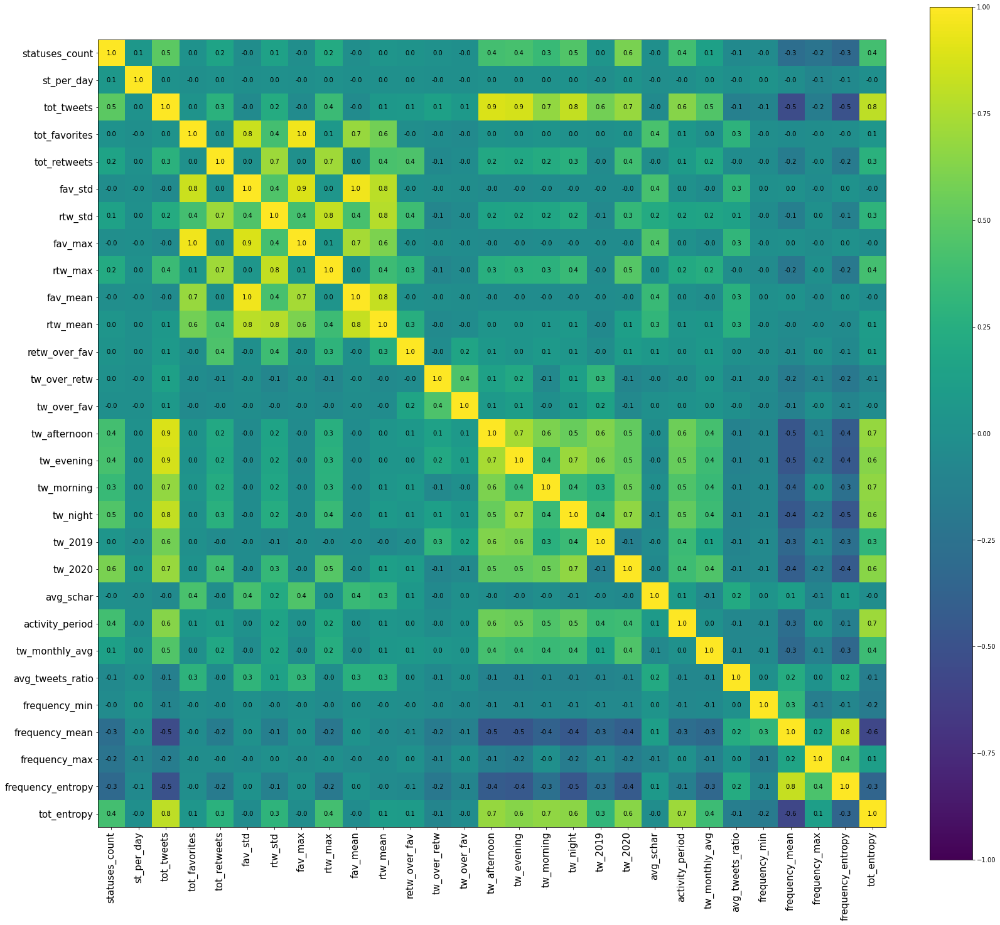

In [ ]:
users_correlation_matrix = Correlation(users_full)
users_correlation_matrix.compute(1)
users_correlation_matrix.heatmap(25)

In [ ]:
users_full.drop(columns=["fav_max", "fav_std"], inplace=True)

In [ ]:
users_full.drop(columns=["rtw_std"], inplace=True)

In [ ]:
users_full.drop(columns=["tw_afternoon", "tw_evening", "tw_morning", "tw_night"], inplace=True)

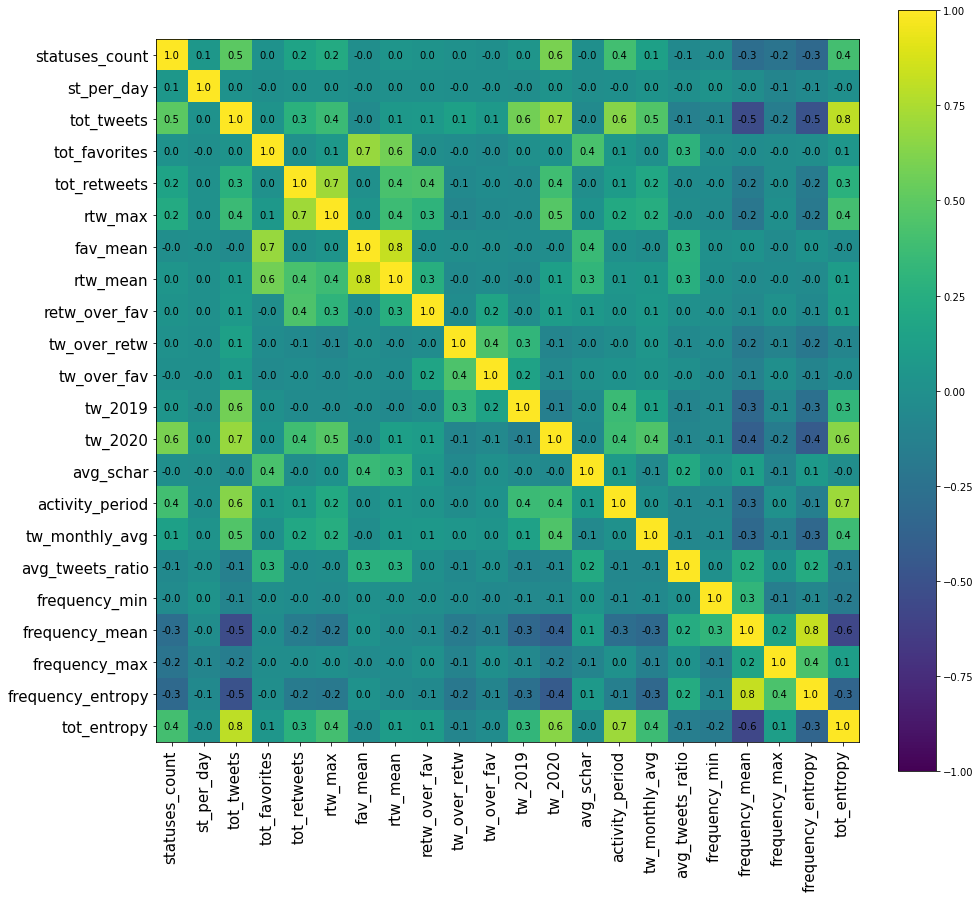

In [ ]:
users_correlation_matrix = Correlation(users_full)
users_correlation_matrix.compute(1)
users_correlation_matrix.heatmap(14)

In [ ]:
users_full.drop(columns=["tw_2019", "tw_2020"], inplace=True)

Let's now measure how much the columns are skewed:

In [ ]:
users_full.skew(axis = 0, skipna = True)

statuses_count        8.137604
st_per_day           74.583568
tot_tweets            1.121011
tot_favorites        15.768399
tot_retweets         12.307066
rtw_max               6.411452
fav_mean             30.598800
rtw_mean             19.839329
retw_over_fav        32.467349
tw_over_retw         19.615019
tw_over_fav          26.425497
avg_schar             7.304018
activity_period       1.238543
tw_monthly_avg       12.308755
avg_tweets_ratio      7.638004
frequency_min        11.214585
frequency_mean        1.060147
frequency_max        -4.177822
frequency_entropy    -0.043437
tot_entropy           0.454558
dtype: float64

We can see high skewness so we will clearly need to normalize/standardize the data in order to operate K-means

In [ ]:
#users_full.to_csv(basepath+"/pp_users_full.csv")

In [ ]:
users_full = pd.read_csv(basepath + '/pp_users_full.csv')

## 2.2 K-means

### 2.2.1 Preprocessing

Kmeans works well with symmetric distribution of variables, same means and same variances. So we are going to standardize the data.

Let's start by making all the skewed distributions symmetric:

In [ ]:
# all the variables have skewed distributions
# symmetric_metrics = users_metrics.apply(lambda x: np.log(x+1))

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import davies_bouldin_score, silhouette_score

In [ ]:
#scaler = MinMaxScaler()
scaler = StandardScaler()
X = scaler.fit_transform(users_full.values)

### 2.2.2 Useful functions

In [ ]:
def clusters_features_plot(values_list, ylabel):
    visualize(x=range(2, len(values_list) + 1), y=values_list[1:], xlabel='K', ylabel=ylabel, plot_type="plot")
    plt.xticks(range(1, len(values_list) + 1))
    plt.show()

In [ ]:
def find_k(sse_list):
    plt.plot(range(1, len(sse_list) + 1), sse_list, label="SSE")
    plt.plot(range(2, len(sse_list) + 1), -10*(np.diff(np.array(sse_list))),label="-10 ${d}\over{dk}$ SSE")
    plt.rcParams['text.usetex'] = True
    plt.plot(range(3, len(sse_list) + 1), 10*np.diff(np.diff(np.array(sse_list))),label="${10}{{d^2}\over{dk^2}}$ SSE")# d^2 dk^2

    plt.xlabel('K', fontsize=22)
    plt.xticks(range(1, len(sse_list) + 1))
    plt.legend(fontsize=15)
    plt.gcf().set_size_inches(12, 7)
    plt.show()

### 2.2.3 Running K-means (standard scaler)

In [ ]:
sse_list = list()
separations = list()
silouettes_ = list()

max_k = 16
for k in range(1, max_k):
    print(k, end='...') # see working progress
    kmeans = KMeans(n_clusters=k, n_init=100, max_iter=300)
    kmeans.fit(X)
    
    sse = kmeans.inertia_
    sse_list.append(sse)
    if k>1:
      separations.append(davies_bouldin_score(X, kmeans.labels_))
      silouettes_.append(silhouette_score(X, kmeans.labels_))

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...

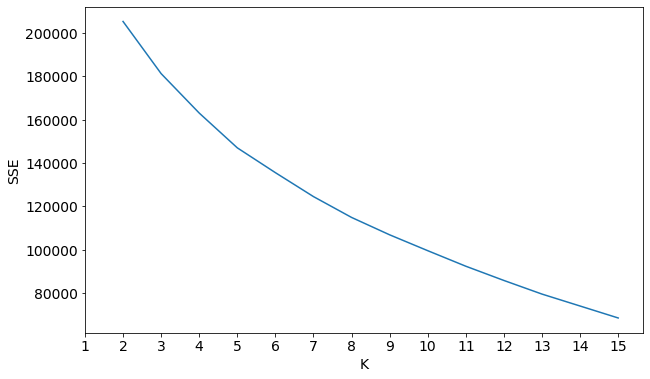

In [ ]:
plt.figure(figsize=(10,6))
clusters_features_plot(sse_list, "SSE")

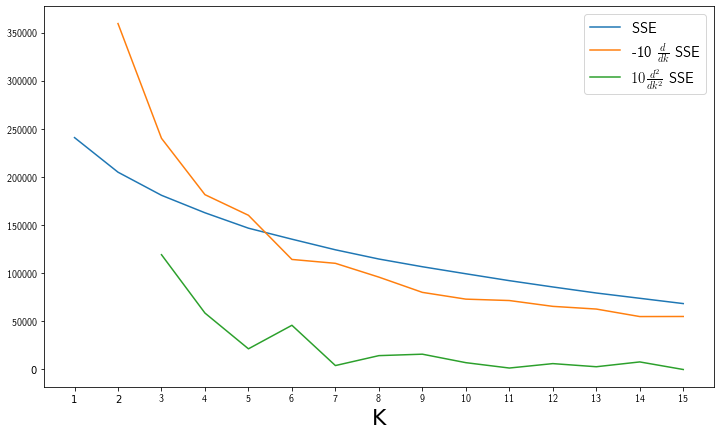

In [ ]:
find_k(sse_list)

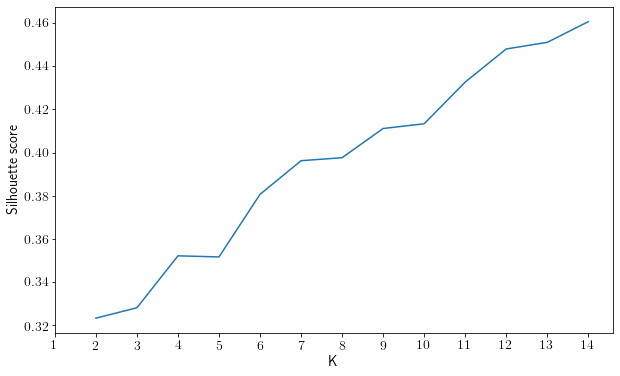

In [ ]:
plt.figure(figsize=(10,6))
clusters_features_plot(silouettes_, "Silhouette score")

Let's take a look at the separation of the clusters:

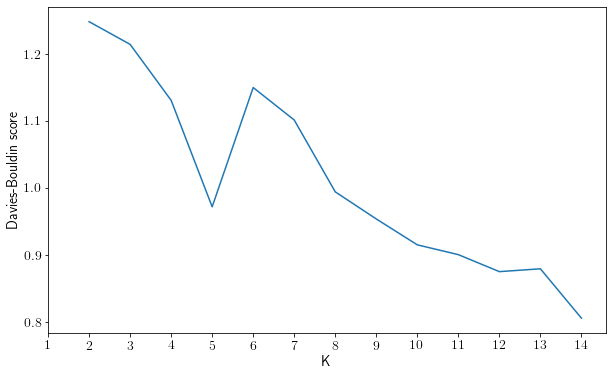

In [ ]:
plt.figure(figsize=(10,6))
clusters_features_plot(separations, "Davies-Bouldin score")

Here we can see that the separation improves (i.e. the Davis-Bouldin score decreases toward 0) at almost every step. The only steps where it increases are K=6 and K=13.

Summing up the information enlighted by the plots above, K=9 seems to be a good value (the silhouette has a good increasing from 8 to 9 and K=9 is the smallest value after the local minimum in K=5, for which the Davies-Bouldin score is smaller than the minimum for the smaller K values)

In [ ]:
selected_k = 9

In [ ]:
kmeans = KMeans(n_clusters=selected_k, n_init=100, max_iter=500)
kmeans.fit(X)

KMeans(max_iter=500, n_clusters=9, n_init=100)

In [ ]:
centers = scaler.inverse_transform(kmeans.cluster_centers_)

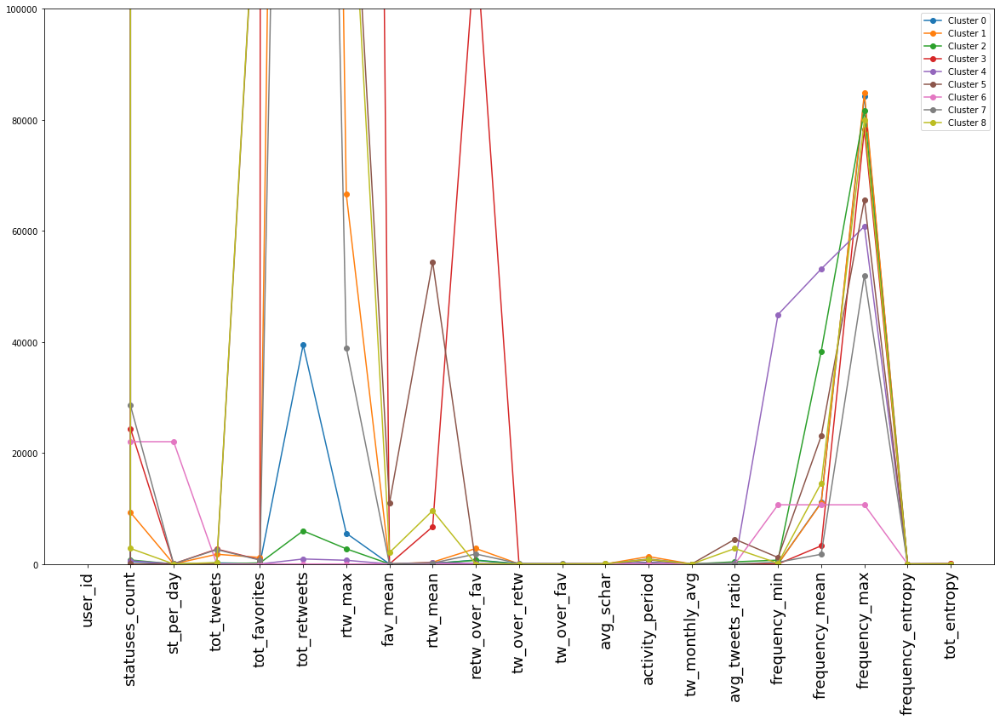

In [ ]:
plt.figure(figsize=(20, 12))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(users_full.columns)), users_full.columns, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.ylim(0,100000)
plt.show()
plt.rcParams["text.usetex"] = False

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8], dtype=int32),
 array([2803, 3491, 3955,   10,  143,  105,   29,    2,  949]))

We can see that 3 clusters are too small, so they can be deleted/joined with other cluster. Other 2 clusters are small with respect to the other (105 and 143 points respectively)

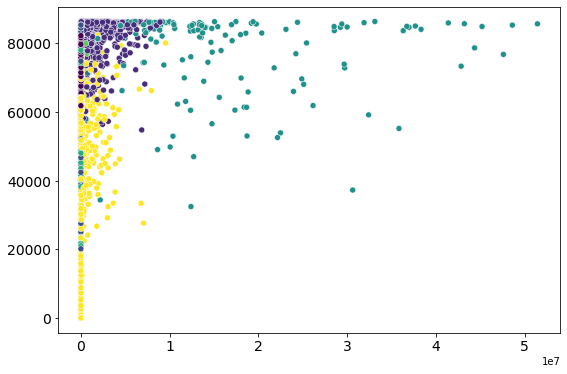

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['tot_retweets'], y=users_full['frequency_max'], plot_type='scatter', c=kmeans.labels_) 

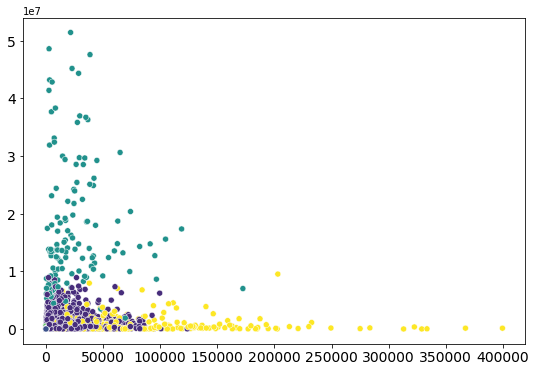

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['tot_retweets'], plot_type='scatter', c=kmeans.labels_) 

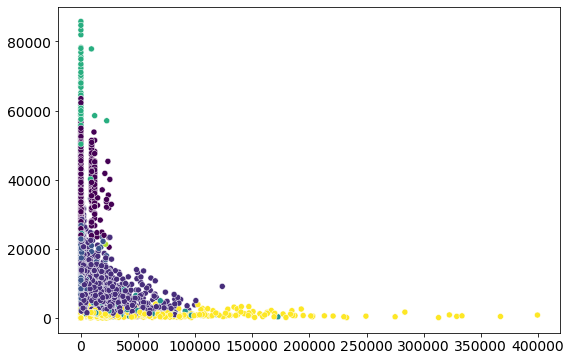

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_)

In [ ]:
from mpl_toolkits import mplot3d

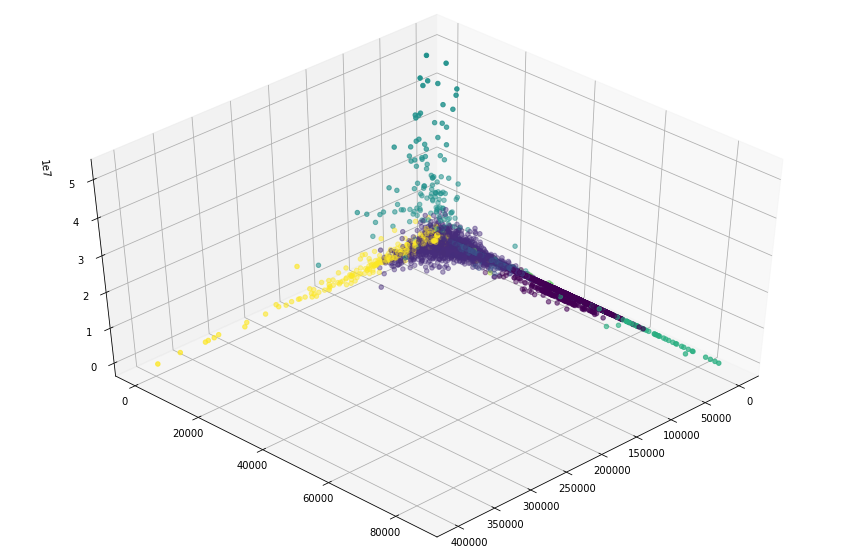

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['statuses_count'], users_full['frequency_mean'], users_full['tot_retweets'], c=kmeans.labels_);
ax.view_init(45, 45)
plt.draw()

Since we have small cluster, we now try to assign the points in the three smallest clusters to their nearest centroid (we are talking of 10+29+2=41 points) and then repeat the plots

In [ ]:
for i in range(len(users_full)):
    if kmeans.labels_[i] in {3,6,7}:
        min_dist = 1e10
        index = -1
        for j in range(len(centers)):
            if np.linalg.norm(users_full.iloc[i].tolist()-centers[j]) < min_dist:
                min_dist = np.linalg.norm(users_full.iloc[i].tolist()-centers[j])
                index = j
        kmeans.labels_[i] = j

In [ ]:
users_full["center"] = kmeans.labels_

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 4, 5, 8], dtype=int32),
 array([2803, 3491, 3955,  143,  105,  990]))

In [ ]:
centers_list = centers.tolist()

In [ ]:
del centers_list[3]
del centers_list[5]
del centers_list[5]

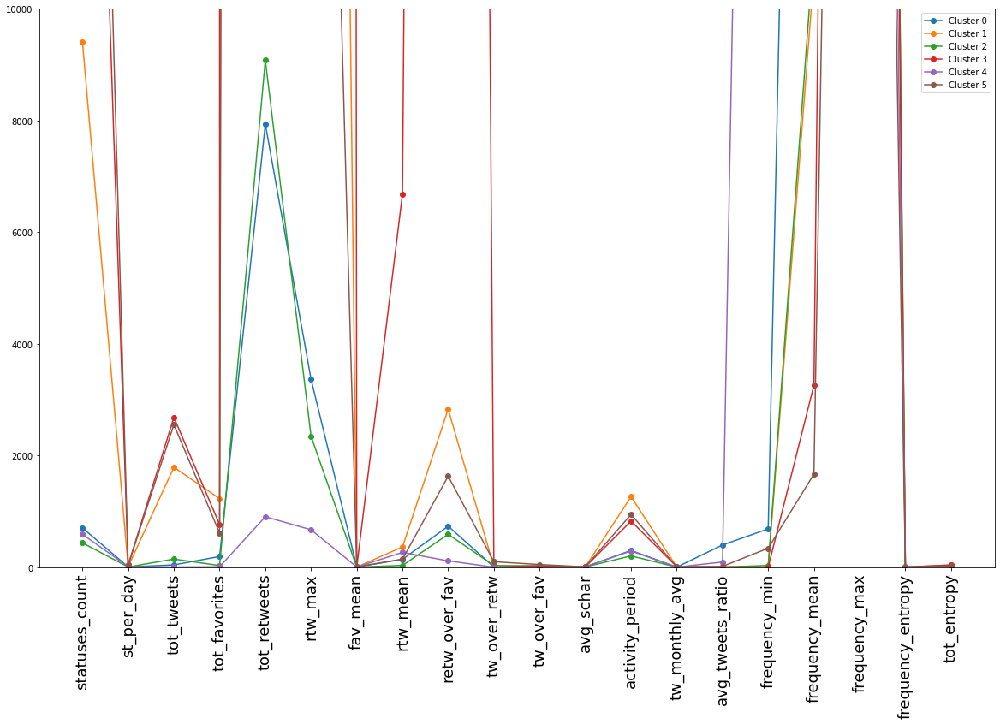

In [ ]:
plt.figure(figsize=(20, 12))
for i in range(0, len(centers_list)):
    plt.plot(centers_list[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(users_full.columns)), users_full.columns, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.ylim(0,10000)
plt.show()
plt.rcParams["text.usetex"] = False

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 4, 5, 8], dtype=int32),
 array([2803, 3491, 3955,  143,  105,  990]))

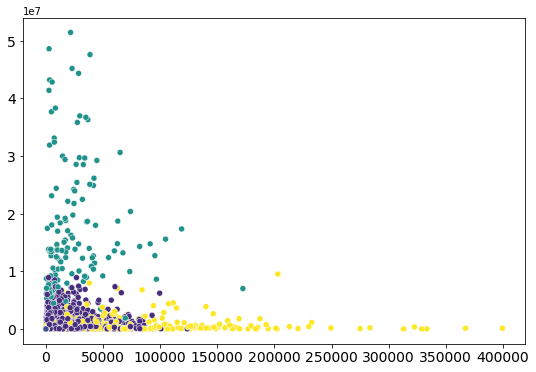

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['tot_retweets'], plot_type='scatter', c=kmeans.labels_) 

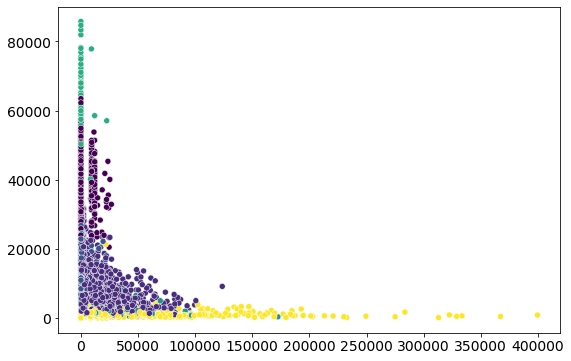

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_)

In [ ]:
from mpl_toolkits import mplot3d

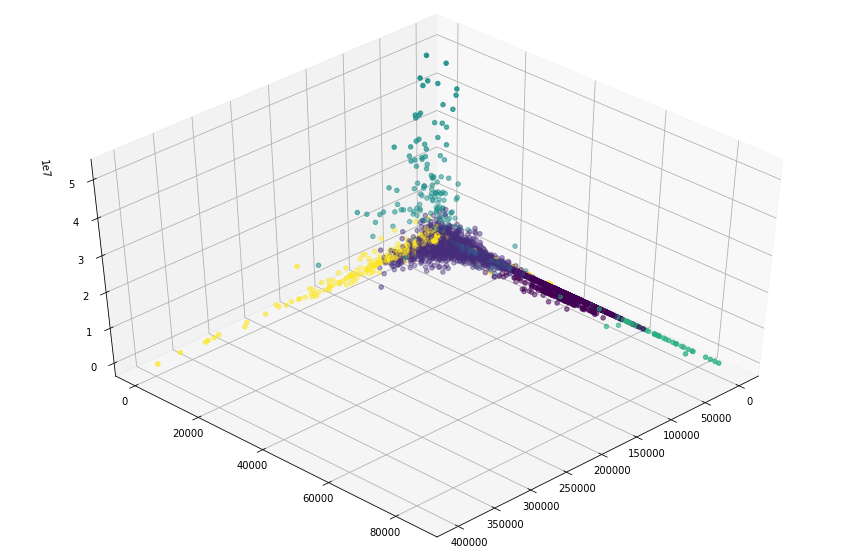

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['statuses_count'], users_full['frequency_mean'], users_full['tot_retweets'], c=kmeans.labels_);
ax.view_init(45, 45)
plt.draw()

Graphically we don't even see the difference

In [ ]:
cluster_df = users_full

In [ ]:
#cluster_df.to_csv(basepath+"/5means_df.csv")

### 2.2.4 Clusters analysis (K = 9)

In [ ]:
df = pd.read_csv(basepath + '/5means_df.csv', lineterminator='\n', index_col=0)

In [ ]:
users_full = pd.read_csv(basepath + '/users_full_1.9.9.csv', lineterminator='\n', index_col=0, parse_dates=['sign_up_date'])

In [ ]:
df = users_full.merge(df, how='left', on='user_id')

We reassign class labels so that the range becomes [0,5]

In [ ]:
df.center.value_counts()

2    3955
1    3491
0    2803
8     990
4     143
5     105
Name: center, dtype: int64

In [ ]:
df.center[df.center==4] = 3
df.center[df.center==5] = 4
df.center[df.center==8] = 5

<ipython-input-164-2dd8fa7c7a2f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.center[df.center==4] = 3
<ipython-input-164-2dd8fa7c7a2f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.center[df.center==5] = 4
<ipython-input-164-2dd8fa7c7a2f>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.center[df.center==8] = 5


In [ ]:
df.rename(columns={"center":"cluster_class"}, inplace=True)

Let's now visualize the distribution of users' attributes per cluster

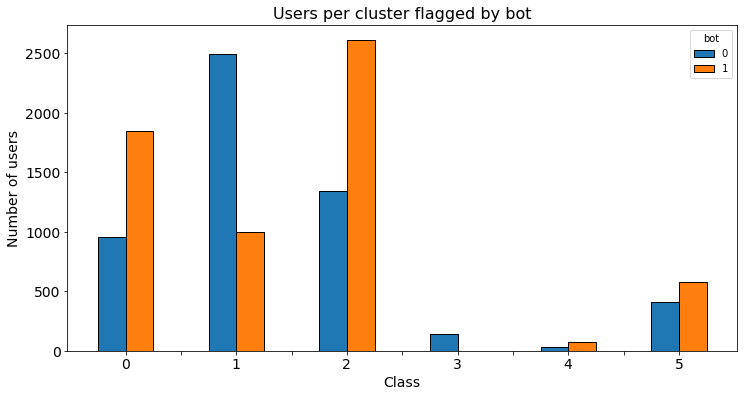

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by bot", plot_type="hist", ax=None, hue=df.bot, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.xticks([0,1,2,3,4,5,6,7,8,9,10],['0','','1','','2','','3','','4','','5',''])
plt.show()

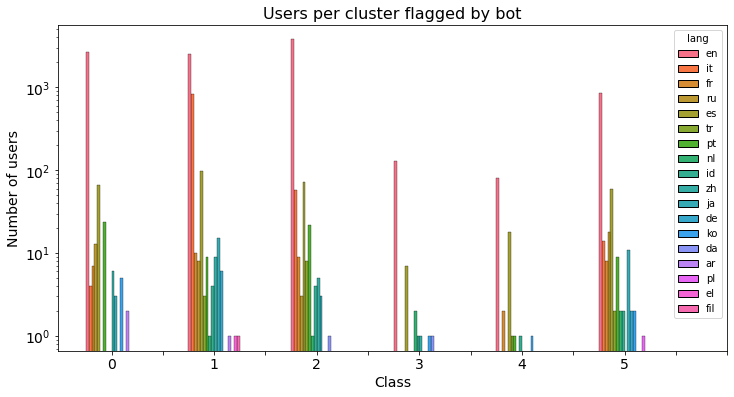

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by language", plot_type="hist", ax=None, hue=df.lang, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.xticks([0,1,2,3,4,5,6,7,8,9,10,11,12],['0','','1','','2','','3','','4','','5','','',''])
plt.yscale('log')
plt.show()

In [ ]:
df["creation_year"]=df.sign_up_date.apply(lambda x: x.year)

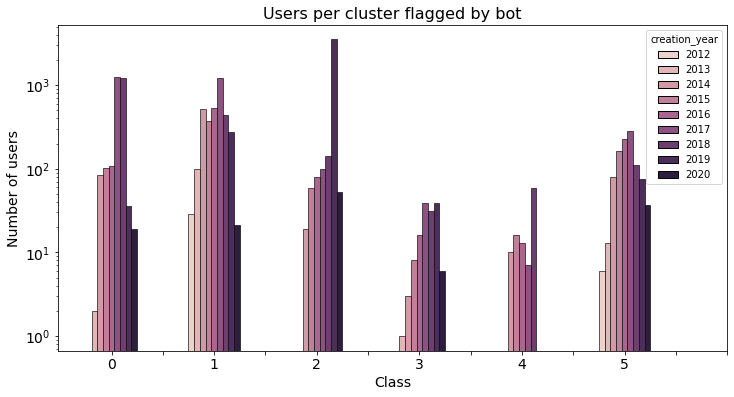

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by year of creation", plot_type="hist", ax=None, hue=df.creation_year, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.yscale('log')
plt.xticks([0,1,2,3,4,5,6,7,8,9,10,11,12],['0','','1','','2','','3','','4','','5','','',''])
plt.show()

We can see that the clusters does not clearly discriminate between categorical attributes (otherwise we wouldn't need classification)

### 2.2.5 Try other K values

Before we run this we have to re-upload users_full and re-run the metrics selection

#### 2.2.5.1 K = 14

In [ ]:
selected_k = 14

In [ ]:
kmeans = KMeans(n_clusters=selected_k, n_init=100, max_iter=500)
kmeans.fit(X)

KMeans(max_iter=500, n_clusters=14, n_init=100)

In [ ]:
centers = scaler.inverse_transform(kmeans.cluster_centers_)

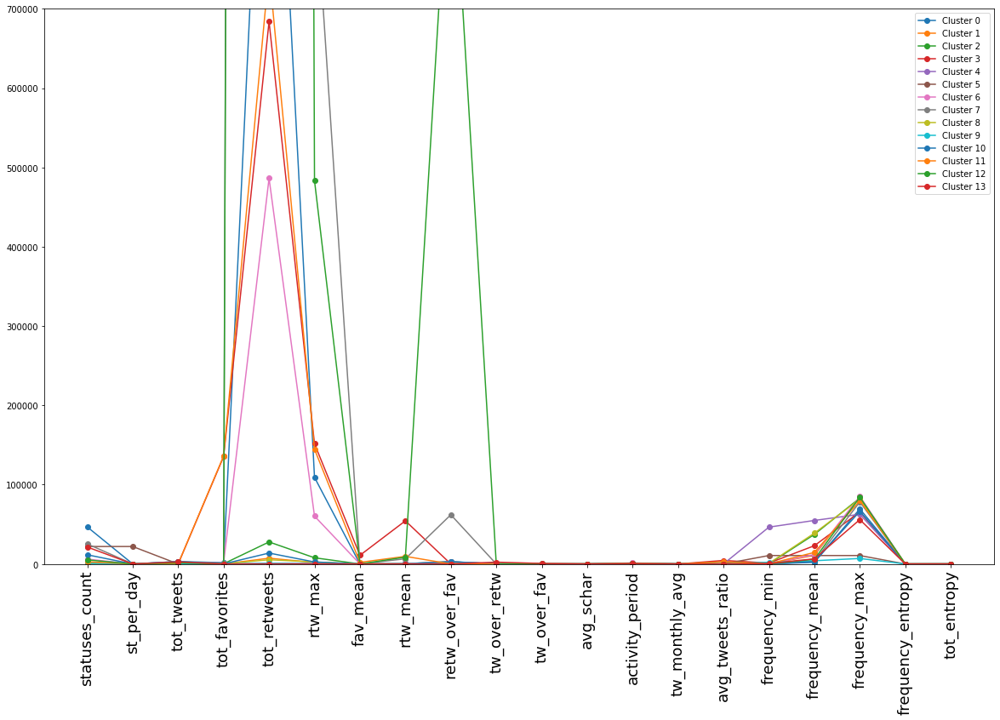

In [ ]:
plt.figure(figsize=(20, 12))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(users_full.columns)), users_full.columns, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.ylim(0,700000)
plt.show()
plt.rcParams["text.usetex"] = False

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13],
       dtype=int32),
 array([ 768, 3830,  385,   10,   98,    2, 3121,  135, 2416,  206,  474,
          29,    8,    5]))

We can see that 6 clusters are too small, so they can be deleted/joined with other clusters. Other clusters are small with respect to the others

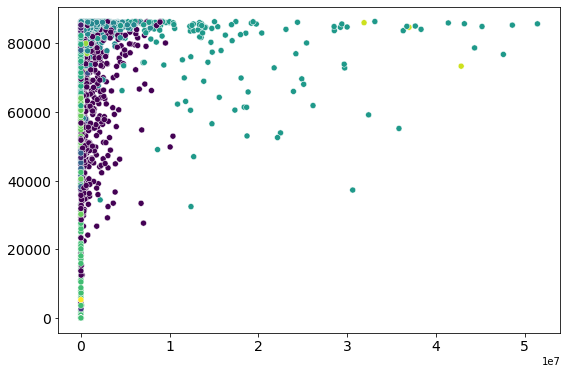

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['tot_retweets'], y=users_full['frequency_max'], plot_type='scatter', c=kmeans.labels_) 

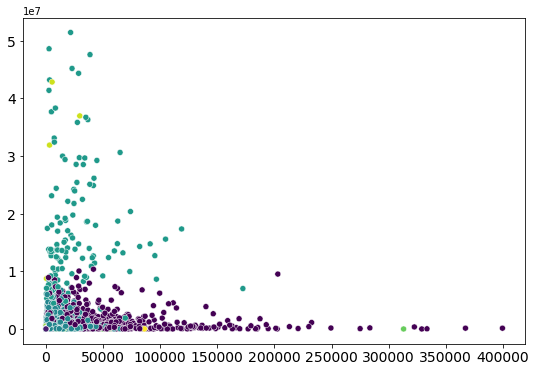

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['tot_retweets'], plot_type='scatter', c=kmeans.labels_) 

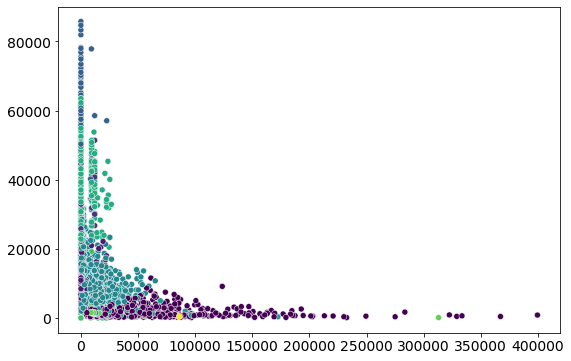

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_)

In [ ]:
from mpl_toolkits import mplot3d

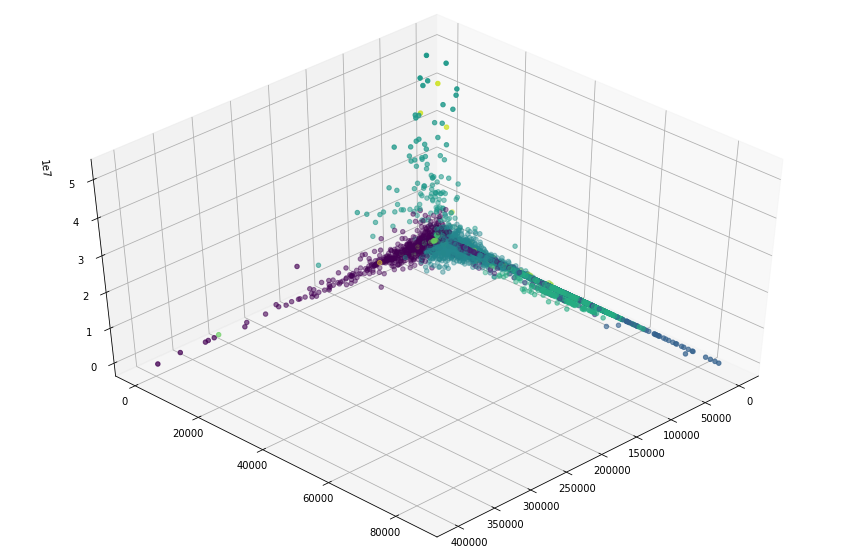

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['statuses_count'], users_full['frequency_mean'], users_full['tot_retweets'], c=kmeans.labels_);
ax.view_init(45, 45)
plt.draw()

Since we have small cluster, we now try to assign the points in the three smallest clusters to their nearest centroid and then repeat the plots

In [ ]:
for i in range(len(users_full)):
    if kmeans.labels_[i] in {3,4,5,11,12,13}:
        min_dist = 1e10
        index = -1
        for j in range(len(centers)):
            if np.linalg.norm(users_full.iloc[i].tolist()-centers[j]) < min_dist:
                min_dist = np.linalg.norm(users_full.iloc[i].tolist()-centers[j])
                index = j
        kmeans.labels_[i] = j

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([ 0,  1,  2,  6,  7,  8,  9, 10, 13], dtype=int32),
 array([ 768, 3830,  385, 3121,  135, 2416,  206,  474,  152]))

In [ ]:
centers_list = centers.tolist()

In [ ]:
del centers_list[3]
del centers_list[3]
del centers_list[3]
del centers_list[8]
del centers_list[8]
del centers_list[8]

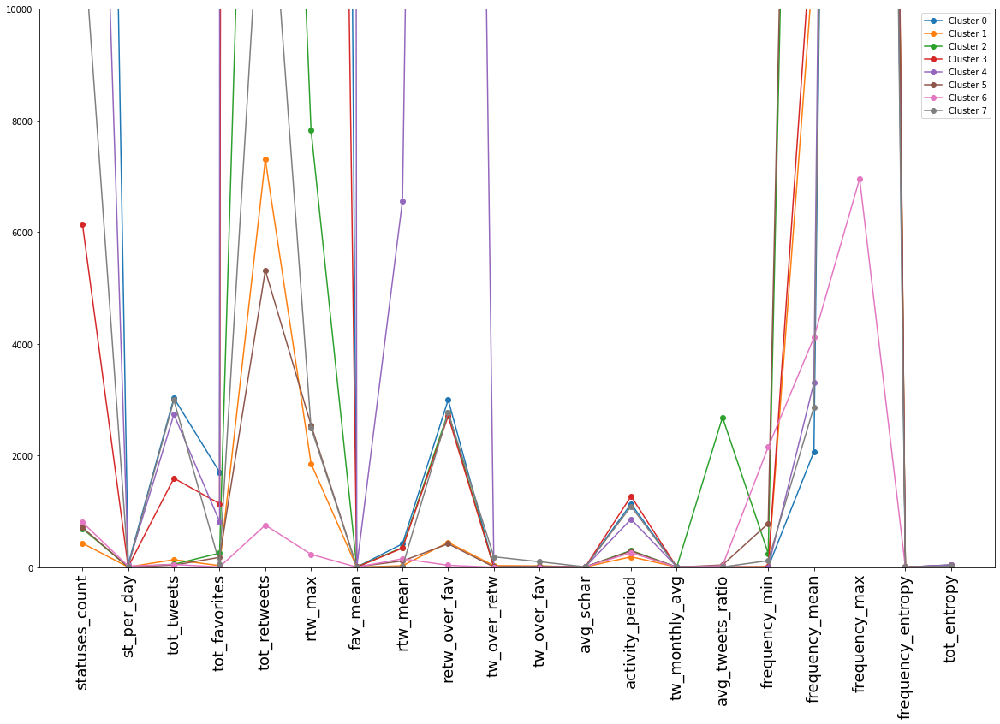

In [ ]:
plt.figure(figsize=(20, 12))
for i in range(0, len(centers_list)):
    plt.plot(centers_list[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(users_full.columns)), users_full.columns, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.ylim(0,10000)
plt.show()
plt.rcParams["text.usetex"] = False

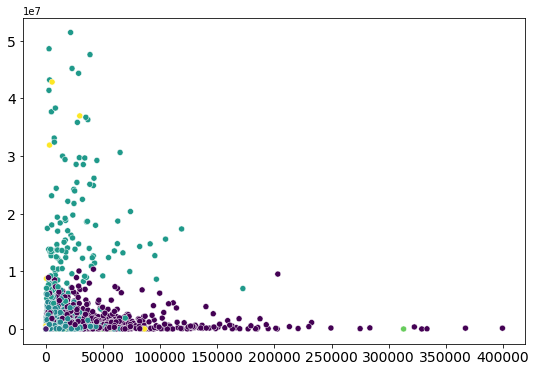

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['tot_retweets'], plot_type='scatter', c=kmeans.labels_) 

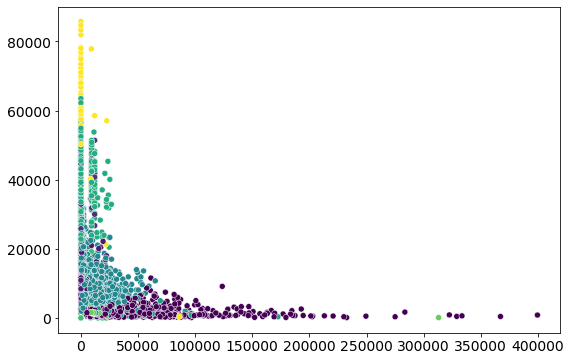

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_)

In [ ]:
from mpl_toolkits import mplot3d

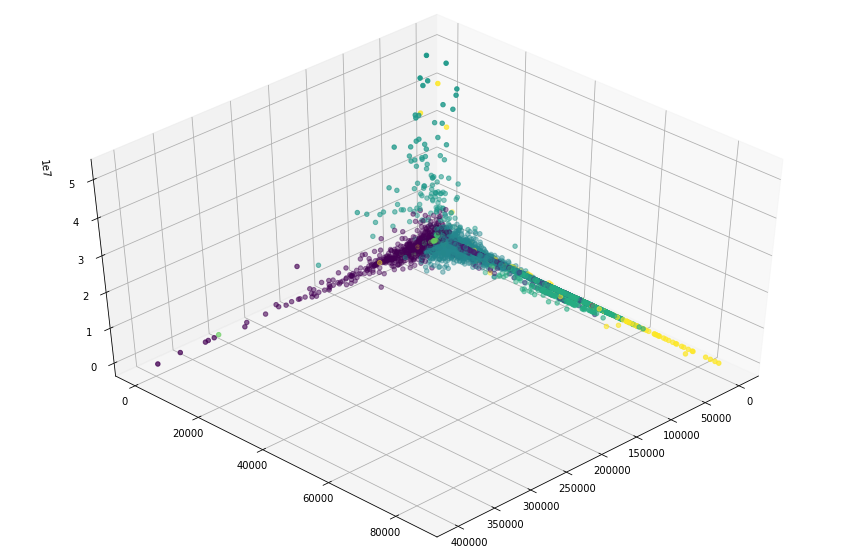

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['statuses_count'], users_full['frequency_mean'], users_full['tot_retweets'], c=kmeans.labels_);
ax.view_init(45, 45)
plt.draw()

The main clusters with K=14 are more or less the same as K=9, there are 4 big cluster of which 3 very big and one with a little less than 1000 points. So, using big values ok K does not improve the clustering. Therefore, we can try the value K=4

#### 2.2.5.2 K = 4

In [ ]:
selected_k = 4

In [ ]:
kmeans = KMeans(n_clusters=selected_k, n_init=100, max_iter=500)
kmeans.fit(X)

KMeans(max_iter=500, n_clusters=4, n_init=100)

In [ ]:
centers = scaler.inverse_transform(kmeans.cluster_centers_)

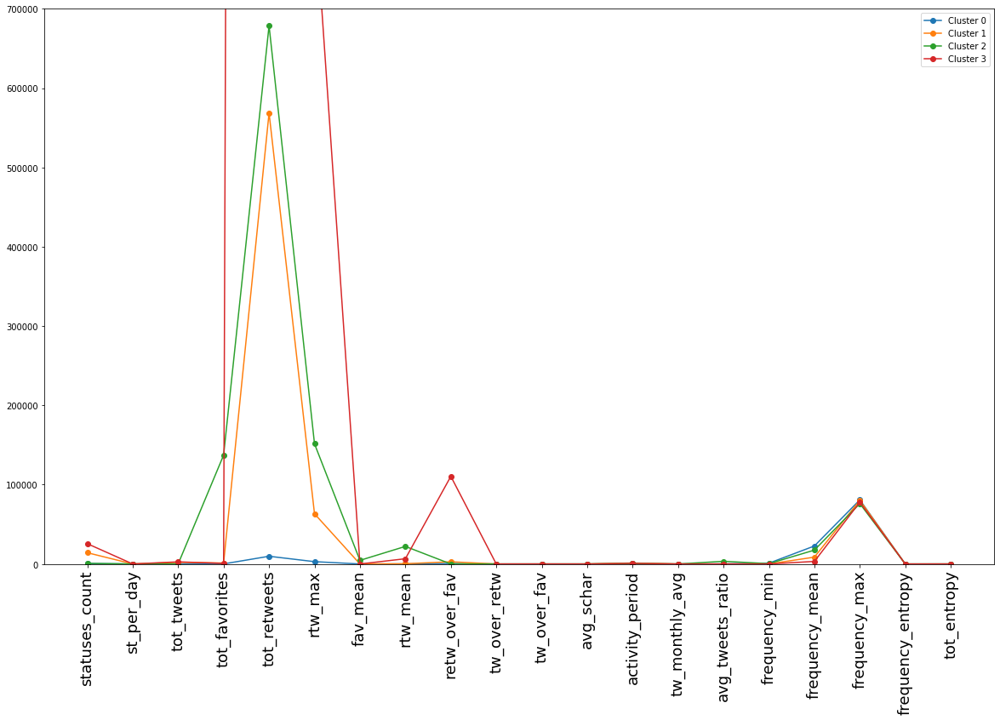

In [ ]:
plt.figure(figsize=(20, 12))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(users_full.columns)), users_full.columns, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.ylim(0,700000)
plt.show()
plt.rcParams["text.usetex"] = False

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3], dtype=int32), array([7054, 4251,   37,  145]))

With K=4 the number of clusters is just 2, so maybe this is not very interesting. Let's take a look at the plots

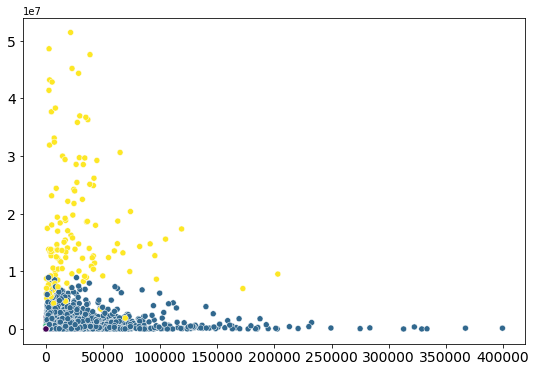

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['tot_retweets'], plot_type='scatter', c=kmeans.labels_) 

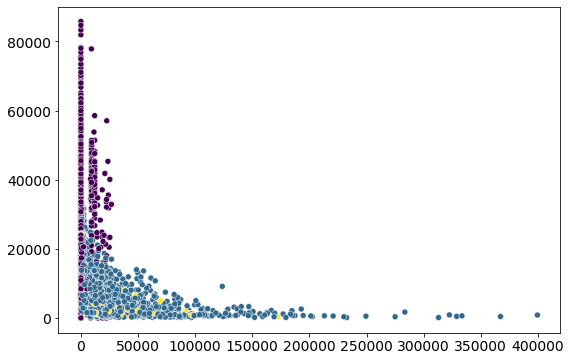

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_)

In [ ]:
from mpl_toolkits import mplot3d

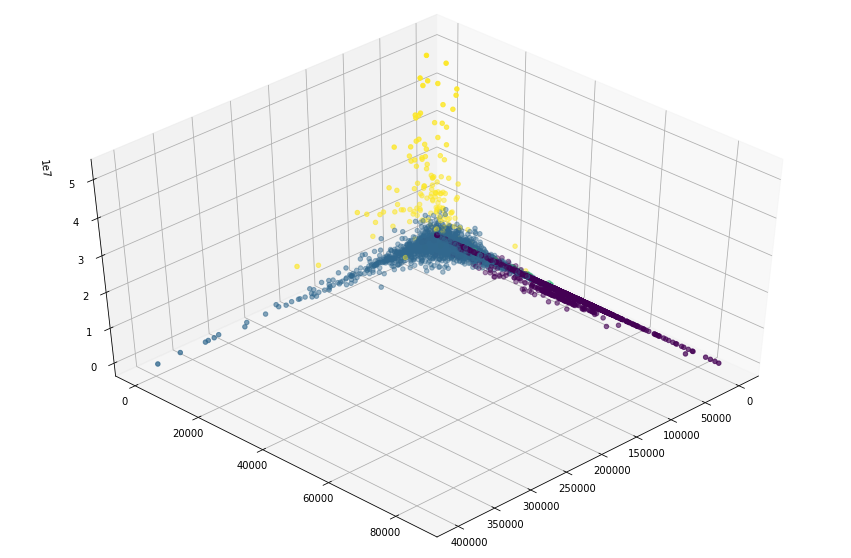

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['statuses_count'], users_full['frequency_mean'], users_full['tot_retweets'], c=kmeans.labels_);
ax.view_init(45, 45)
plt.draw()

We delete only the smallest cluster and keep the others

In [ ]:
for i in range(len(users_full)):
    if kmeans.labels_[i] in {2}:
        min_dist = 1e10
        index = -1
        for j in range(len(centers)):
            if np.linalg.norm(users_full.iloc[i].tolist()-centers[j]) < min_dist:
                min_dist = np.linalg.norm(users_full.iloc[i].tolist()-centers[j])
                index = j
        kmeans.labels_[i] = j

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 3], dtype=int32), array([7054, 4251,  182]))

In [ ]:
centers_list = centers.tolist()

In [ ]:
del centers_list[2]

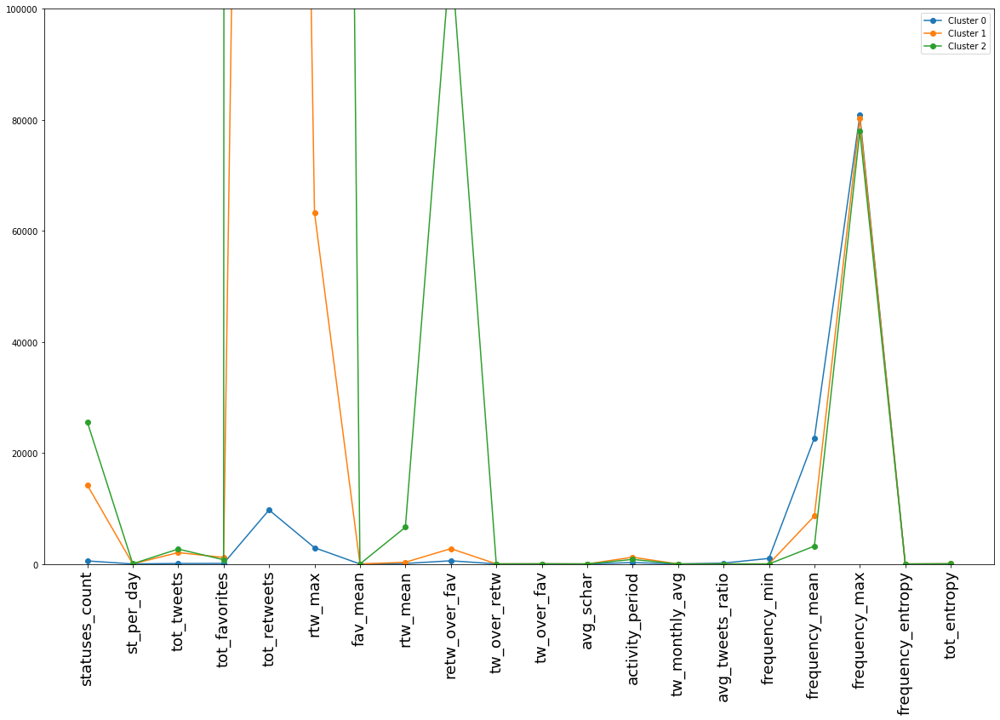

In [ ]:
plt.figure(figsize=(20, 12))
for i in range(0, len(centers_list)):
    plt.plot(centers_list[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(users_full.columns)), users_full.columns, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.ylim(0,100000)
plt.show()
plt.rcParams["text.usetex"] = False

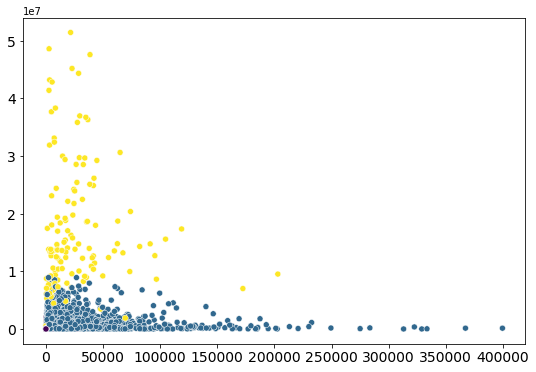

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['tot_retweets'], plot_type='scatter', c=kmeans.labels_) 

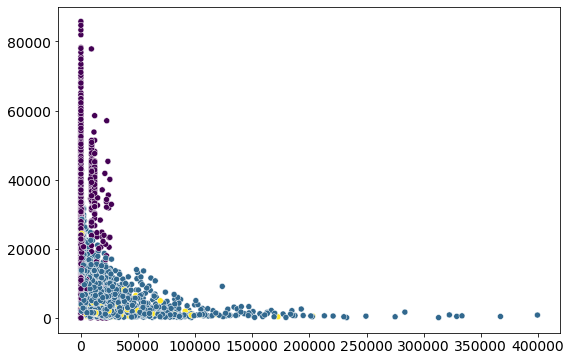

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_)

In [ ]:
from mpl_toolkits import mplot3d

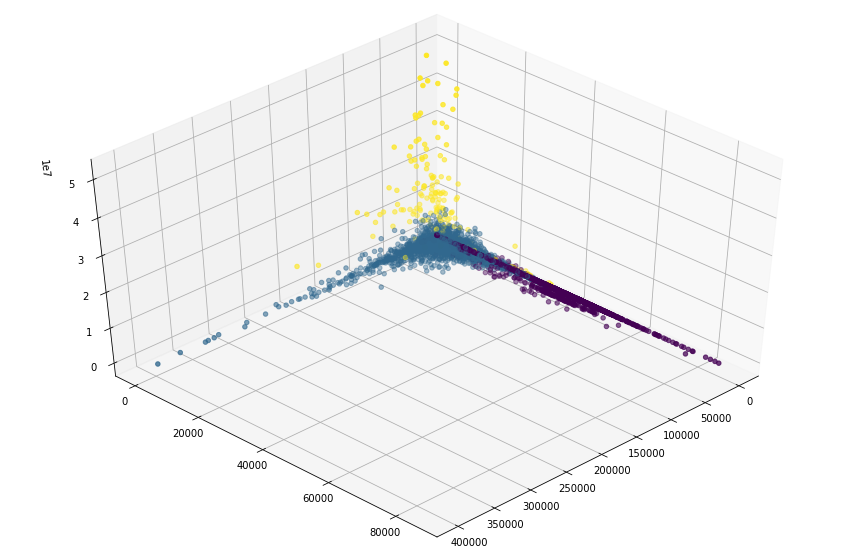

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['statuses_count'], users_full['frequency_mean'], users_full['tot_retweets'], c=kmeans.labels_);
ax.view_init(45, 45)
plt.draw()

This seems different enough from K=9 and K=14, so it's worth to analyze:

In [ ]:
users_full["center"] = kmeans.labels_

In [ ]:
df = users_full

In [ ]:
users_full = pd.read_csv(basepath + '/users_full_1.9.9.csv', lineterminator='\n', index_col=0, parse_dates=['sign_up_date'])

In [ ]:
df = users_full.merge(df, how='left', on='user_id')

We reassign class labels so that the range becomes [0,2]

In [ ]:
df.center.value_counts()

0    7054
1    4251
3     182
Name: center, dtype: int64

In [ ]:
df.center[df.center==3] = 2

<ipython-input-233-a53cea6ae72b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.center[df.center==3] = 2


In [ ]:
df.rename(columns={"center":"cluster_class"}, inplace=True)

Let's now visualize the distribution of users' attributes per cluster

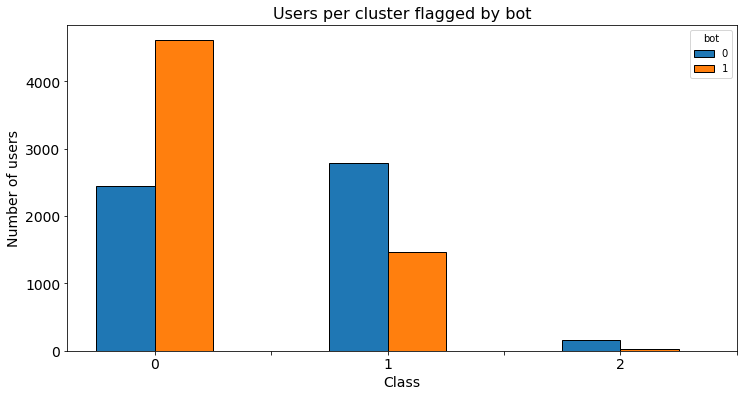

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by bot", plot_type="hist", ax=None, hue=df.bot, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.xticks([0,1,2,3,4,5],['0','','1','','2',''])
plt.show()

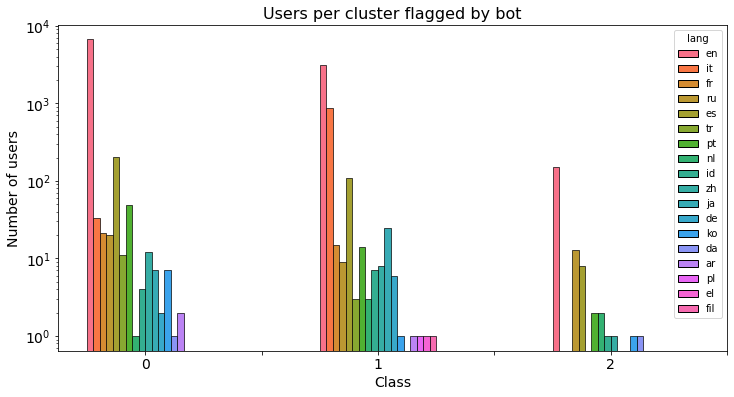

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by bot", plot_type="hist", ax=None, hue=df.lang, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.xticks([0,1,2,3,4,5],['0','','1','','2',''])
plt.yscale('log')
plt.show()

In [ ]:
df["creation_year"]=df.sign_up_date.apply(lambda x: x.year)

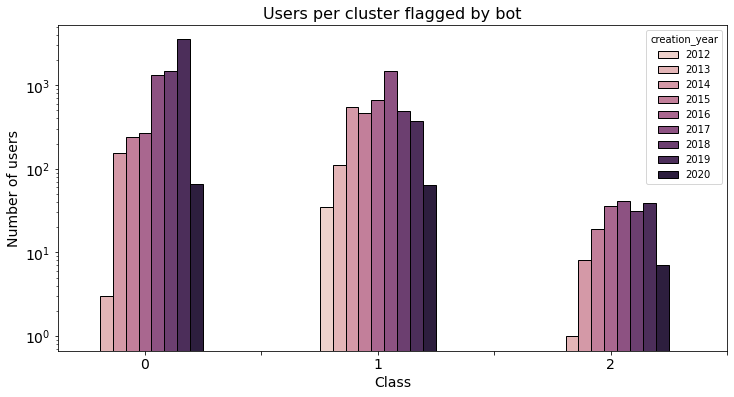

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by bot", plot_type="hist", ax=None, hue=df.creation_year, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.yscale('log')
plt.xticks([0,1,2,3,4,5,],['0','','1','','2',''])
plt.show()

What we can conclude from this analysis is that the clusters we have found seems to be not very good and informative. This is clearly caused by the distribution of our data. The K-means works well with globular clusters, while the shape of our data is everything but globular and we have also long tails.

### 2.2.6 Running K-means (min-max scaler)

In [ ]:
users_full.drop(columns="user_id", inplace=True)

In [ ]:
scaler = MinMaxScaler()
X = scaler.fit_transform(users_full.values)

In [ ]:
sse_list = list()
separations = list()
silouettes_ = list()

max_k = 16
for k in range(1, max_k):
    print(k, end='...') # see working progress
    kmeans = KMeans(n_clusters=k, n_init=100, max_iter=300)
    kmeans.fit(X)
    
    sse = kmeans.inertia_
    sse_list.append(sse)
    if k>1:
      separations.append(davies_bouldin_score(X, kmeans.labels_))
      silouettes_.append(silhouette_score(X, kmeans.labels_))

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...

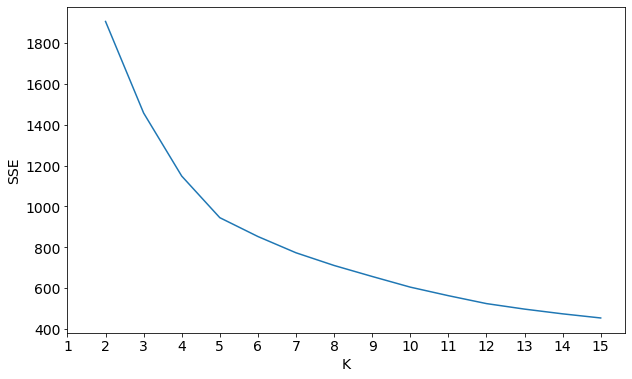

In [ ]:
plt.figure(figsize=(10,6))
clusters_features_plot(sse_list, "SSE")

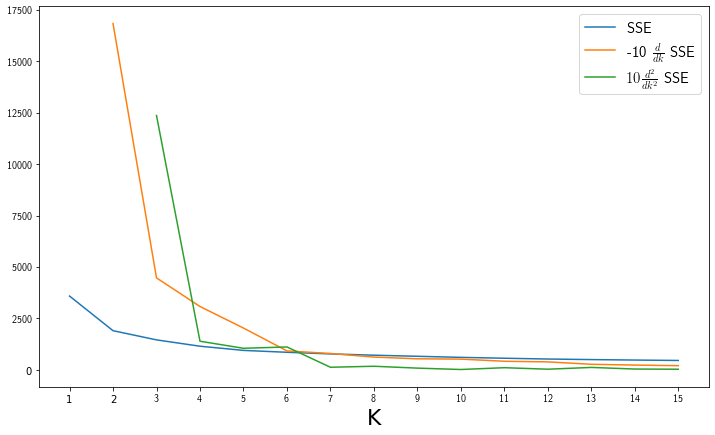

In [ ]:
find_k(sse_list)

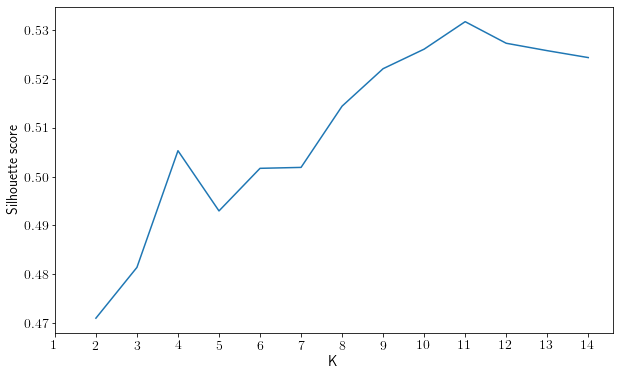

In [ ]:
plt.figure(figsize=(10,6))
clusters_features_plot(silouettes_, "Silhouette score")

Let's take a look at the separation of the clusters:

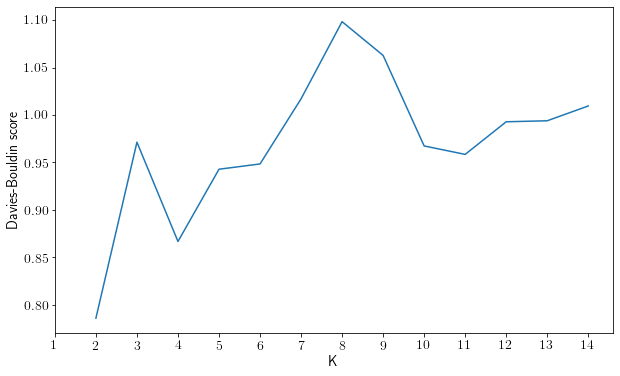

In [ ]:
plt.figure(figsize=(10,6))
clusters_features_plot(separations, "Davies-Bouldin score")

It seems that the most interesting K with Min-Max scaler is K=4. Unfortunately, the Davies-Bouldin score is not good with this kind of scaler (it increases). However, in terms of values, it is perfectly comparable with that of the Standard Scaler, so it's not a real problem

In [ ]:
selected_k = 4

In [ ]:
kmeans = KMeans(n_clusters=selected_k, n_init=100, max_iter=500)
kmeans.fit(X)

KMeans(max_iter=500, n_clusters=4, n_init=100)

In [ ]:
centers = scaler.inverse_transform(kmeans.cluster_centers_)

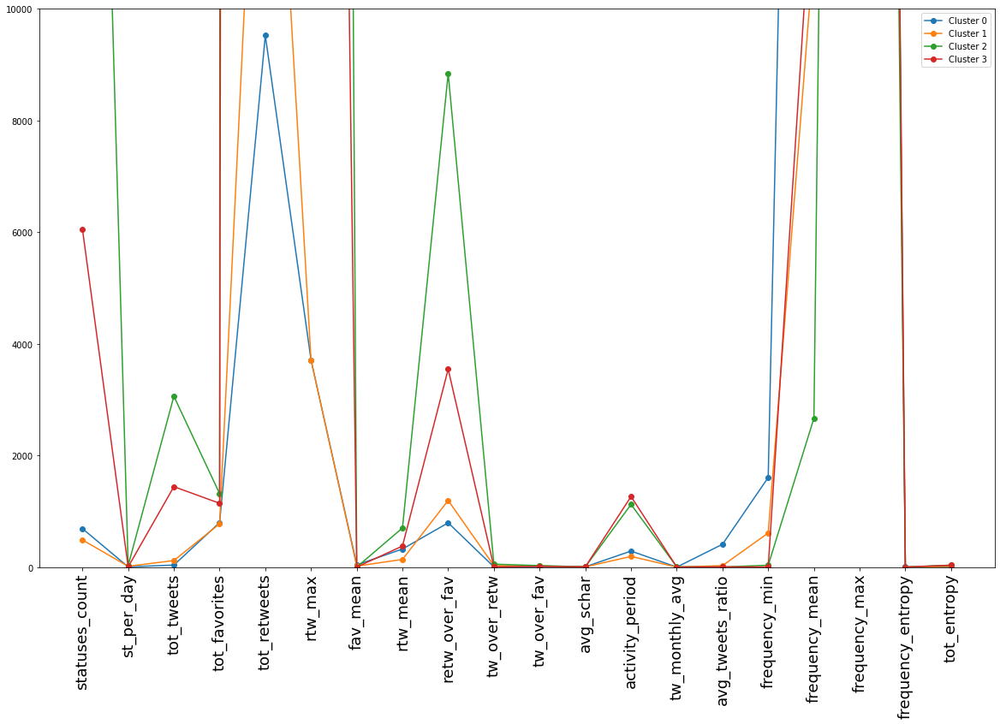

In [ ]:
plt.figure(figsize=(20, 12))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(users_full.columns)), users_full.columns, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.ylim(0,10000)
plt.show()
plt.rcParams["text.usetex"] = False

In [ ]:
np.unique(kmeans.labels_, return_counts=True)

(array([0, 1, 2, 3], dtype=int32), array([2825, 4128, 1619, 2915]))

We can see that the clusters are distributed in a uniform way (no too small clusters)

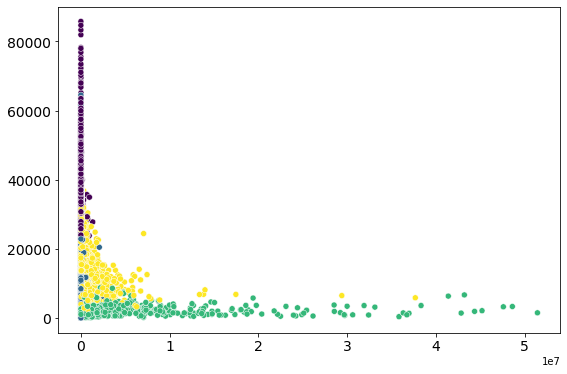

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['tot_retweets'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_) 

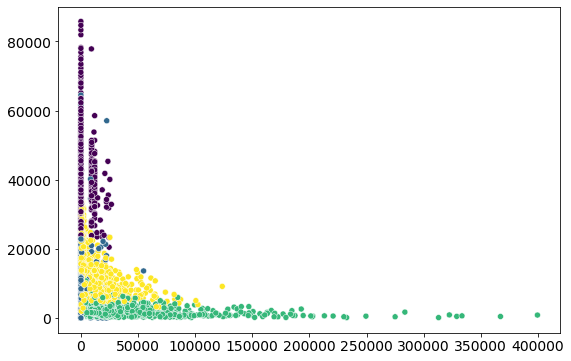

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['statuses_count'], y=users_full['frequency_mean'], plot_type='scatter', c=kmeans.labels_) 

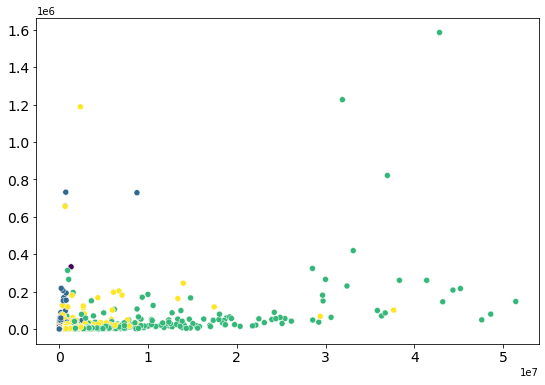

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['tot_retweets'], y=users_full['retw_over_fav'], plot_type='scatter', c=kmeans.labels_)

In [ ]:
from mpl_toolkits import mplot3d

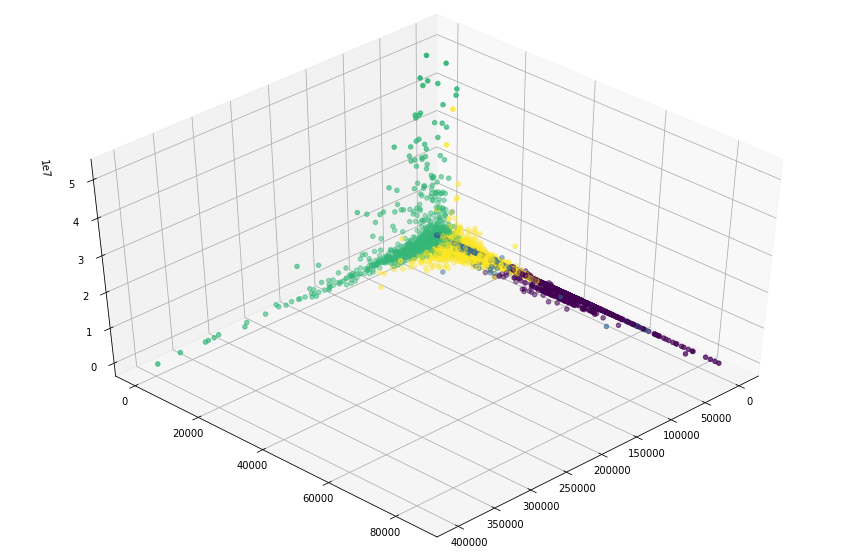

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['statuses_count'], users_full['frequency_mean'], users_full['tot_retweets'], c=kmeans.labels_);
ax.view_init(45, 45)
plt.draw()

We don't have a good visualization, so we try to change features, this time in a more evidence-based way:

In [ ]:
attr_centers = [0 for i in range(len(users_full.columns))]
for i in range(len(users_full.columns)):
      attr_centers[i] = [centers[j][i] for j in range(len(centers))]

In [ ]:
info = [0 for i in range(len(users_full.columns))]
for i in range(len(users_full.columns)):
    info[i] = np.std(attr_centers[i])/np.mean(attr_centers[i]) 
order = np.invert(np.argsort(info))

In [ ]:
users_full.columns.values[order]

array(['tot_tweets', 'retw_over_fav', 'frequency_mean', 'tw_over_retw',
       'activity_period', 'st_per_day', 'statuses_count', 'rtw_mean',
       'frequency_entropy', 'tot_favorites', 'avg_schar', 'tw_over_fav',
       'fav_mean', 'avg_tweets_ratio', 'frequency_max', 'tw_monthly_avg',
       'tot_retweets', 'tot_entropy', 'frequency_min', 'rtw_max'],
      dtype=object)

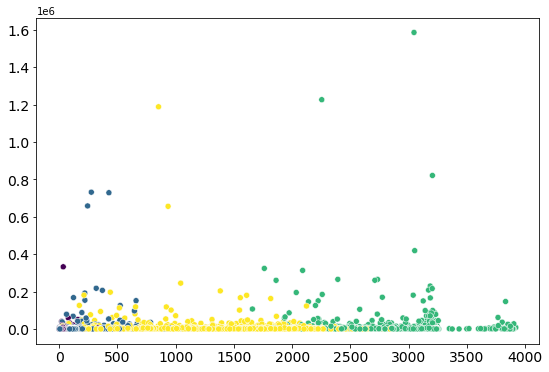

In [ ]:
plt.figure(figsize=(9,6))
visualize(x=users_full['tot_tweets'], y=users_full['retw_over_fav'], plot_type='scatter', c=kmeans.labels_) 

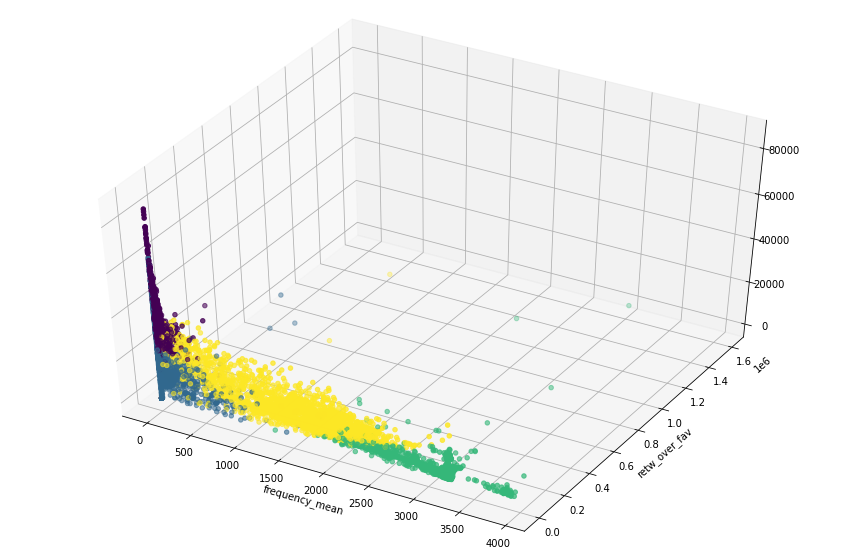

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['tot_tweets'], users_full['retw_over_fav'], users_full['frequency_mean'], c=kmeans.labels_);
ax.view_init(45, -60)
plt.xlabel("tot_tweets")
plt.ylabel("retw_over_fav")
plt.xlabel("frequency_mean")
plt.draw()

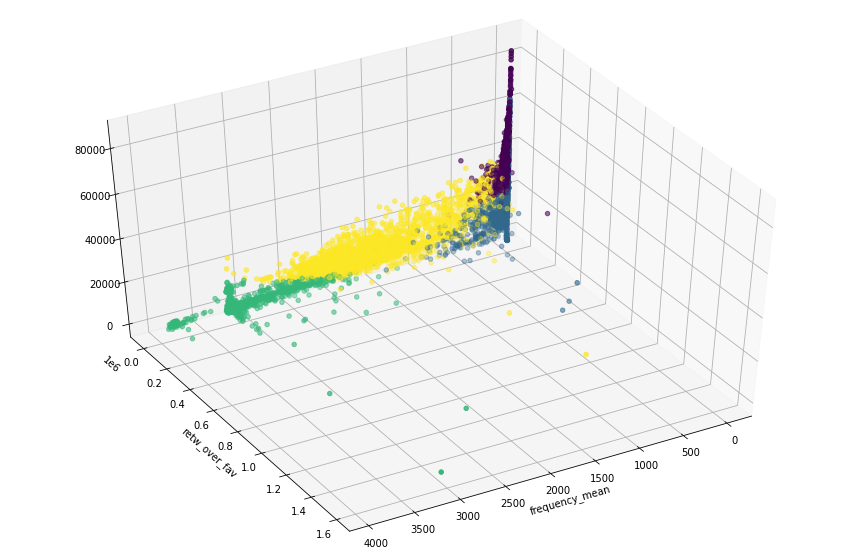

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(users_full['tot_tweets'], users_full['retw_over_fav'], users_full['frequency_mean'], c=kmeans.labels_);
ax.view_init(45, 60)
plt.xlabel("tot_tweets")
plt.ylabel("retw_over_fav")
plt.xlabel("frequency_mean")
plt.draw()

Now, we can see a clear separation between clusters

In [ ]:
users_full["center_class"] = kmeans.labels_

In [ ]:
cluster_df = users_full

In [ ]:
#cluster_df.to_csv(basepath+"/5means_df.csv")

In [ ]:
users_full = pd.read_csv(basepath + '/users_full_1.9.9.csv', lineterminator='\n', index_col=0, parse_dates=['sign_up_date'])

In [ ]:
cluster_df["user_id"] = users_full.index

In [ ]:
df = users_full.merge(cluster_df, how='left', on='user_id')

In [ ]:
df.center.value_counts()

1    4128
3    2915
0    2825
2    1619
Name: center, dtype: int64

Let's now visualize the distribution of users' attributes per cluster

In [ ]:
df.rename(columns={"center_class": "cluster_class"}, inplace=True)

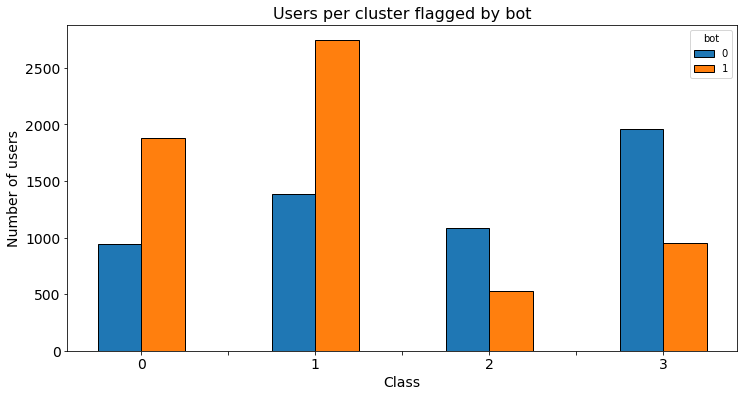

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by bot", plot_type="hist", ax=None, hue=df.bot, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.xticks([0,1,2,3,4,5,6,],['0','','1','','2','','3',''])
plt.show()

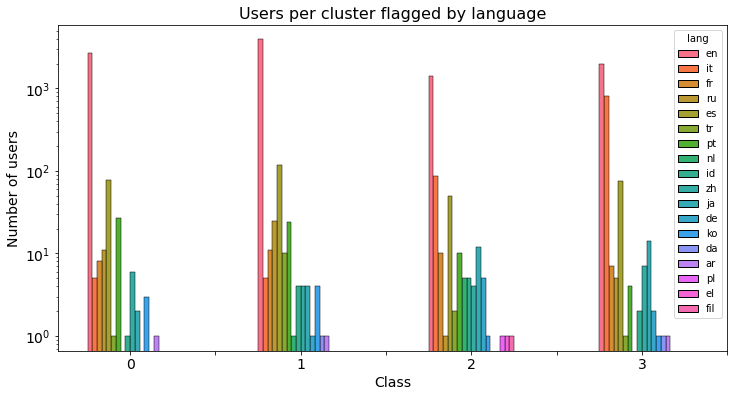

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by language", plot_type="hist", ax=None, hue=df.lang, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.xticks([0,1,2,3,4,5,6,7],['0','','1','','2','','3',''])
plt.yscale('log')
plt.show()

In [ ]:
df["creation_year"]=df.sign_up_date.apply(lambda x: x.year)

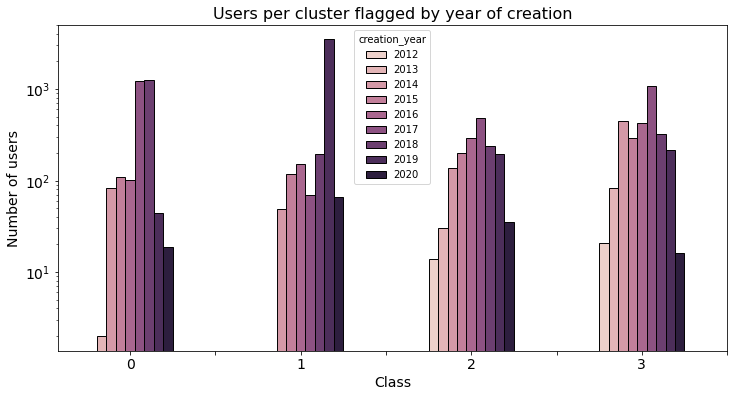

In [ ]:
plt.figure(figsize=(12,6))
visualize(x=2*df.cluster_class, xlabel="Class", ylabel="Number of users", title="Users per cluster flagged by year of creation", plot_type="hist", ax=None, hue=df.creation_year, multiple='dodge', discrete=True,
             edgecolor='black', alpha=1)
plt.yscale('log')
plt.xticks([0,1,2,3,4,5,6,7],['0','','1','','2','','3',''])
plt.show()

## 2.3 DBScan

### 2.3.1 Pre-processing

In [ ]:
users_full = pd.read_csv(basepath + '/pp_users_full.csv')

In [ ]:
users_full.keys()

Index(['user_id', 'statuses_count', 'st_per_day', 'tot_tweets',
       'tot_favorites', 'tot_retweets', 'rtw_max', 'fav_mean', 'rtw_mean',
       'retw_over_fav', 'tw_over_retw', 'tw_over_fav', 'avg_schar',
       'activity_period', 'tw_monthly_avg', 'avg_tweets_ratio',
       'frequency_min', 'frequency_mean', 'frequency_max', 'frequency_entropy',
       'tot_entropy'],
      dtype='object')

In [ ]:
users_full.drop(columns=['user_id'], inplace=True)

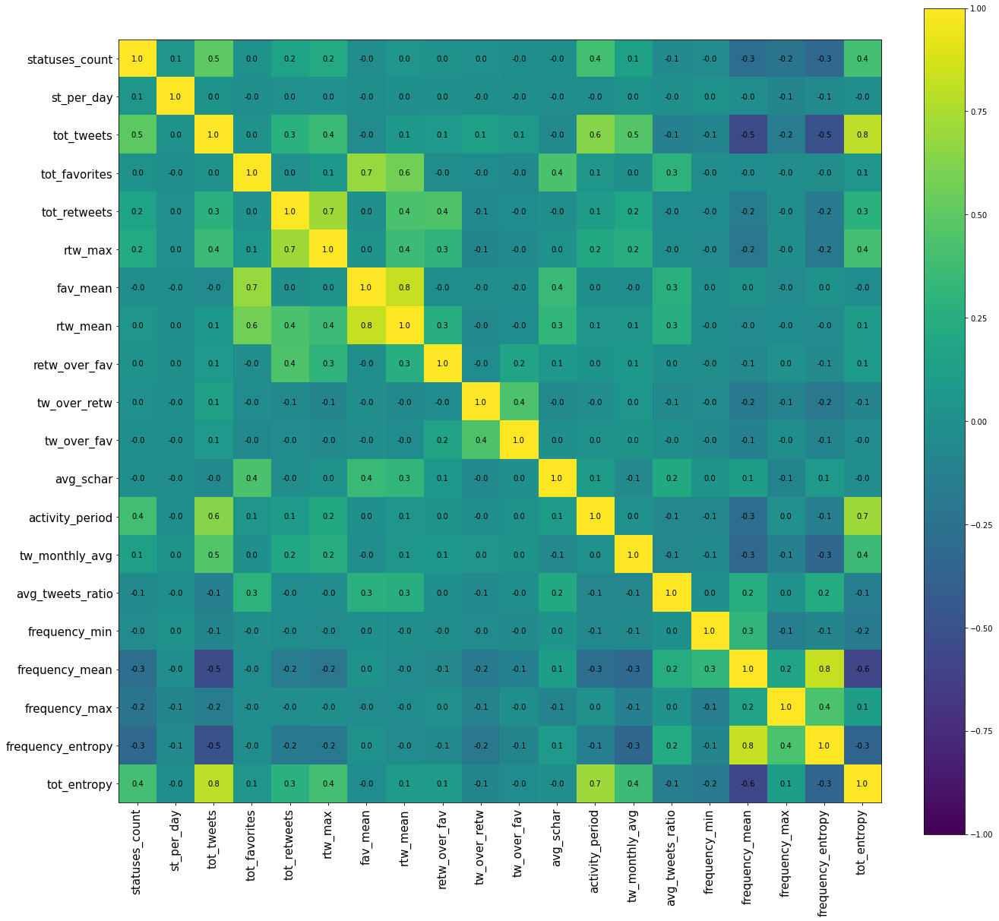

In [ ]:
users_correlation_matrix = Correlation(users_full)
users_correlation_matrix.compute(1)
users_correlation_matrix.heatmap(20)

let's start from this point. 

Those above are the selected features. Let's see how DBscan performs.

Let's standardize the data using Standard Scaler

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [ ]:
scaler = StandardScaler()
X = scaler.fit_transform(users_full.values)

### 2.3.2 DBScan (Standard Scaler)

In [ ]:
!pip install kneed

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from kneed import KneeLocator
from sklearn.metrics import silhouette_score, davies_bouldin_score

let's first tune the right parameter settings.

We're looking for the best eps value

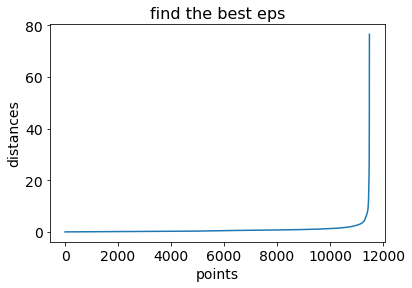

In [ ]:
nearest_neighbors = NearestNeighbors(n_neighbors=11)

neighbors = nearest_neighbors.fit(X)
distances, indices = neighbors.kneighbors(X)
distances = np.sort(distances[:,10], axis=0)

visualize(data=distances, xlabel='points', ylabel='distances', title='find the best eps')
plt.show()

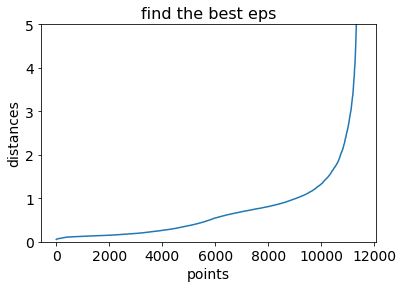

In [ ]:
visualize(data=distances, xlabel='points', ylabel='distances', title='find the best eps')
plt.ylim(0,5)
plt.show()

<Figure size 360x360 with 0 Axes>

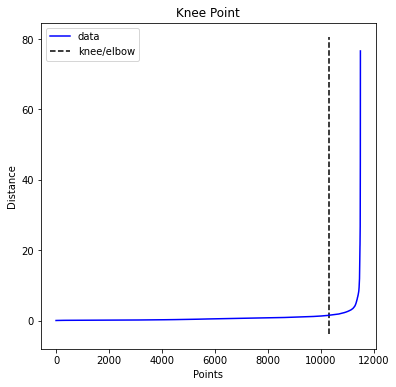

1.5218382155093662


In [ ]:
i = np.arange(len(distances))
knee = KneeLocator(i, distances, S=1, curve='convex', direction='increasing', interp_method='polynomial')

fig = plt.figure(figsize=(5, 5))
knee.plot_knee()
plt.xlabel("Points")
plt.ylabel("Distance")
plt.show()

print(distances[knee.knee])

we found the eps value

In [ ]:
n_features = len(users_full.keys())
dbscan = DBSCAN(eps=1.52, min_samples=n_features)
dbscan.fit(X)

DBSCAN(eps=1.52, min_samples=20)

In [ ]:
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2]), array([ 1005, 10330,    30,   122]))

as we can see, we found 3 clusters, but 2/3 do not seem to be representative

In [ ]:
print("silhouette score: ", silhouette_score(X, dbscan.labels_))
print("davies bouldin score: ", davies_bouldin_score(X, dbscan.labels_))

silhouette score:  0.4838734719078379
davies bouldin score:  2.064232810431971


even though the silhouette score is not looking bad, the clusters meaning is close to none.

We'll try to search into some more dbscan's parameter tuning, to see if it actually gets better

In [ ]:
n_features = len(users_full.keys())
dbscan = DBSCAN(eps=1, min_samples=n_features)
dbscan.fit(X)

DBSCAN(eps=1, min_samples=20)

In [ ]:
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2,  3]), array([2034, 8992,  346,   95,   20]))

In [ ]:
print("silhouette score: ", silhouette_score(X, dbscan.labels_))
print("davies bouldin score: ", davies_bouldin_score(X, dbscan.labels_))

silhouette score:  0.29875261149788573
davies bouldin score:  1.8918608554886422


still meaning-less results

In [ ]:
n_features = len(users_full.keys())
dbscan = DBSCAN(eps=0.5, min_samples=n_features)
dbscan.fit(X)

DBSCAN(min_samples=20)

In [ ]:
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 array([5541, 3380,  701, 1330,   40,   71,  142,   59,   55,   28,   23,
          70,   47]))

In [ ]:
print("silhouette score: ", silhouette_score(X, dbscan.labels_))
print("davies bouldin score: ", davies_bouldin_score(X, dbscan.labels_))

silhouette score:  -0.04512837591705361
davies bouldin score:  1.8308959064228285


In [ ]:
cluster_plots(users_full)

Output hidden; open in https://colab.research.google.com to view.

as we can expect from the dataset, restricting the eps value will create more clusters, but they do not seem to be meaningfull, even this time (we carry more than half dataset as noise points)

In [ ]:
n_features = len(users_full.keys())
dbscan = DBSCAN(eps=1.8, min_samples=n_features)
dbscan.fit(X)

DBSCAN(eps=1.8, min_samples=20)

In [ ]:
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1]), array([  788, 10659,    40]))

In [ ]:
print("silhouette score: ", silhouette_score(X, dbscan.labels_))
print("davies bouldin score: ", davies_bouldin_score(X, dbscan.labels_))

silhouette score:  0.5801803184636205
davies bouldin score:  2.2792062147393675


of course, increasing the eps value will create a bigger first cluster leaving others close to empty

let's try using MinMaxScaler and see if something changes

In [ ]:
scaler = MinMaxScaler()
X = scaler.fit_transform(users_full.values)

### 2.3.2 DBScan (MinMax Scaler)

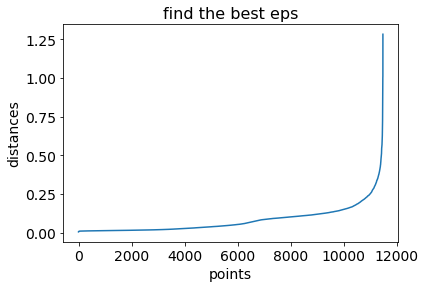

In [ ]:
nearest_neighbors = NearestNeighbors(n_neighbors=11)

neighbors = nearest_neighbors.fit(X)
distances, indices = neighbors.kneighbors(X)
distances = np.sort(distances[:,10], axis=0)

visualize(data=distances, xlabel='points', ylabel='distances', title='find the best eps')
plt.show()

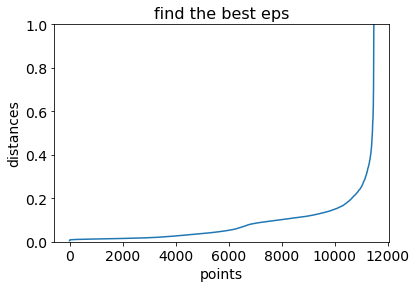

In [ ]:
visualize(data=distances, xlabel='points', ylabel='distances', title='find the best eps')
plt.ylim(0,1)
plt.show()

<Figure size 360x360 with 0 Axes>

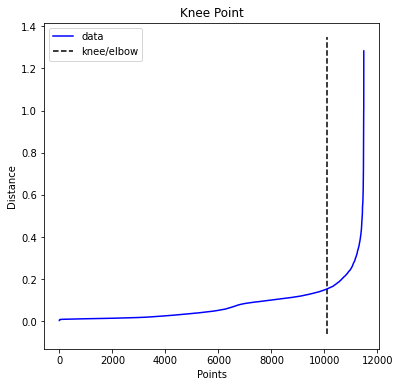

0.15340475972234152


In [ ]:
i = np.arange(len(distances))
knee = KneeLocator(i, distances, S=1, curve='convex', direction='increasing', interp_method='polynomial')

fig = plt.figure(figsize=(5, 5))
knee.plot_knee()
plt.xlabel("Points")
plt.ylabel("Distance")
plt.show()

print(distances[knee.knee])

In [ ]:
n_features = len(users_full.keys())
dbscan = DBSCAN(eps=0.15, min_samples=n_features)
dbscan.fit(X)

DBSCAN(eps=0.15, min_samples=20)

In [ ]:
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2,  3]), array([1164, 9805,   23,  387,  108]))

In [ ]:
print("silhouette score: ", silhouette_score(X, dbscan.labels_))
print("davies bouldin score: ", davies_bouldin_score(X, dbscan.labels_))

silhouette score:  0.2870789112630281
davies bouldin score:  1.7282208189681678


not really an improvement, clusters do not seem appreciable

### Cutting-off dimensions

In [ ]:
users_full.keys()

Index(['statuses_count', 'st_per_day', 'tot_tweets', 'tot_favorites',
       'tot_retweets', 'rtw_max', 'fav_mean', 'rtw_mean', 'retw_over_fav',
       'tw_over_retw', 'tw_over_fav', 'avg_schar', 'activity_period',
       'tw_monthly_avg', 'avg_tweets_ratio', 'frequency_min', 'frequency_mean',
       'frequency_max', 'frequency_entropy', 'tot_entropy'],
      dtype='object')

In [ ]:
users_short = users_full[['statuses_count', 'retw_over_fav', 'tw_over_retw', 'tw_over_fav',
                    'activity_period', 'avg_tweets_ratio', 'tot_entropy']]

In [ ]:
scaler = MinMaxScaler()
X = scaler.fit_transform(users_short.values)

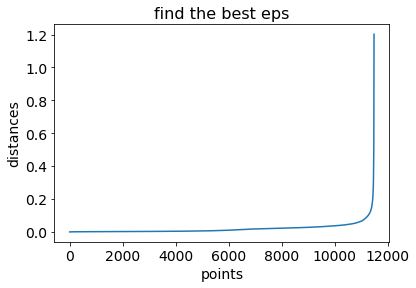

In [ ]:
nearest_neighbors = NearestNeighbors(n_neighbors=11)

neighbors = nearest_neighbors.fit(X)
distances, indices = neighbors.kneighbors(X)
distances = np.sort(distances[:,10], axis=0)

visualize(data=distances, xlabel='points', ylabel='distances', title='find the best eps')
plt.show()

<Figure size 360x360 with 0 Axes>

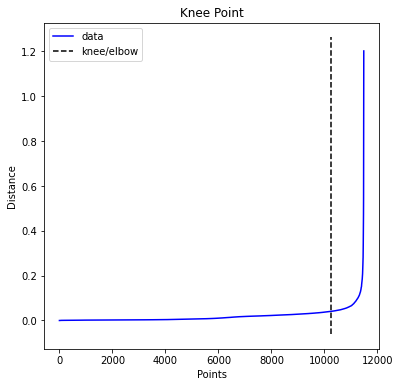

0.04086888437636127


In [ ]:
i = np.arange(len(distances))
knee = KneeLocator(i, distances, S=1, curve='convex', direction='increasing', interp_method='polynomial')

fig = plt.figure(figsize=(5, 5))
knee.plot_knee()
plt.xlabel("Points")
plt.ylabel("Distance")
plt.show()

print(distances[knee.knee])

In [ ]:
n_features = len(users_short.keys())
dbscan = DBSCAN(eps=0.04, min_samples=40)
dbscan.fit(X)

DBSCAN(eps=0.04, min_samples=40)

In [ ]:
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2,  3]), array([2130, 5808, 2967,  245,  337]))

In [ ]:
print("silhouette score: ", silhouette_score(X, dbscan.labels_))
print("davies bouldin score: ", davies_bouldin_score(X, dbscan.labels_))

silhouette score:  0.20572598375083712
davies bouldin score:  2.259303390199977


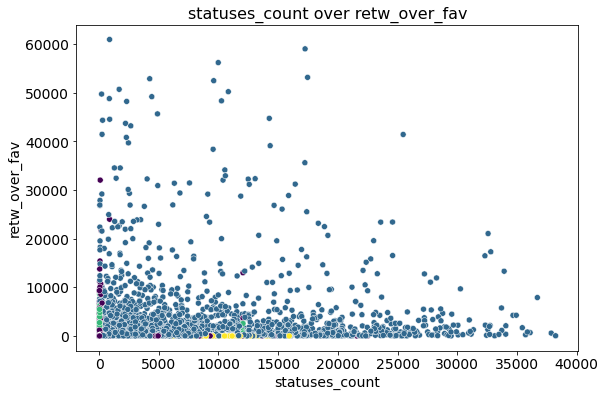

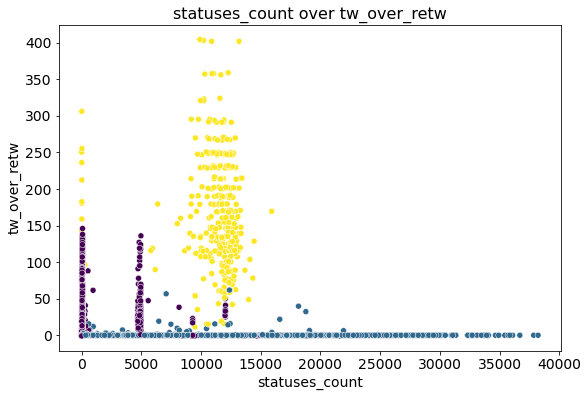

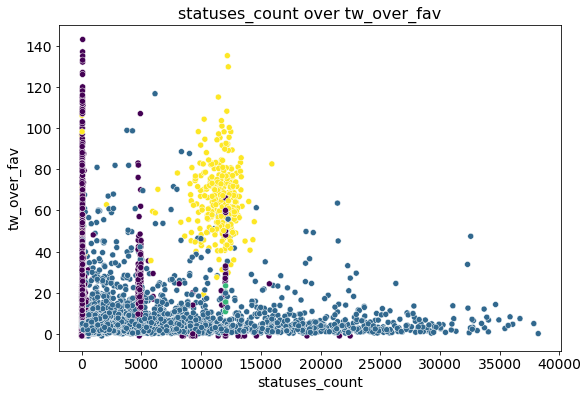

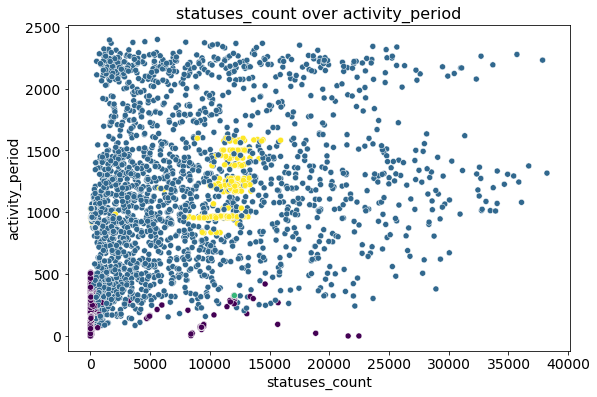

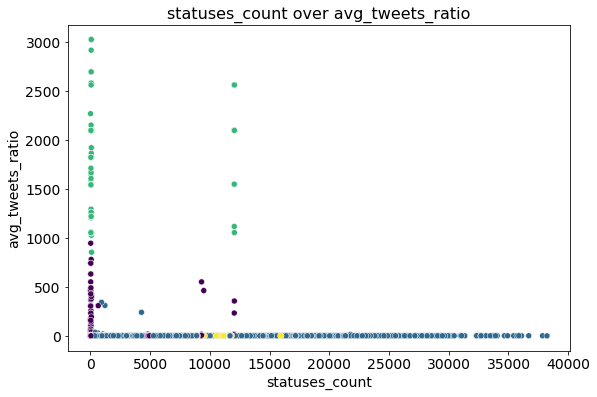

...

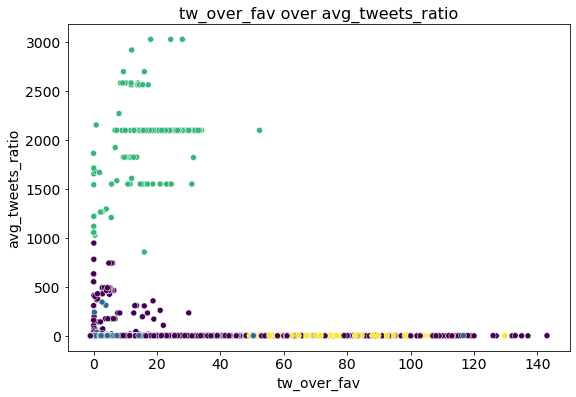

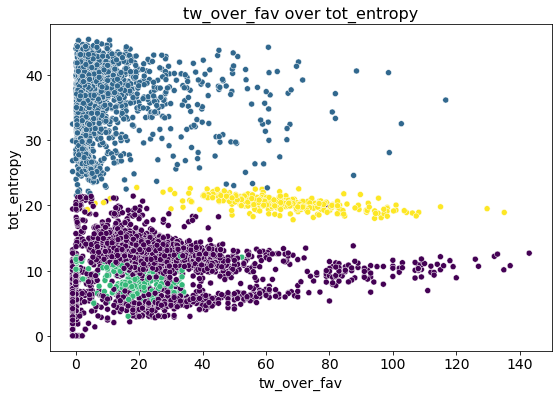

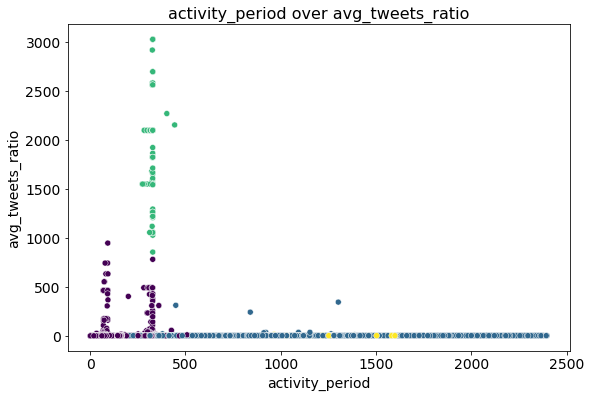

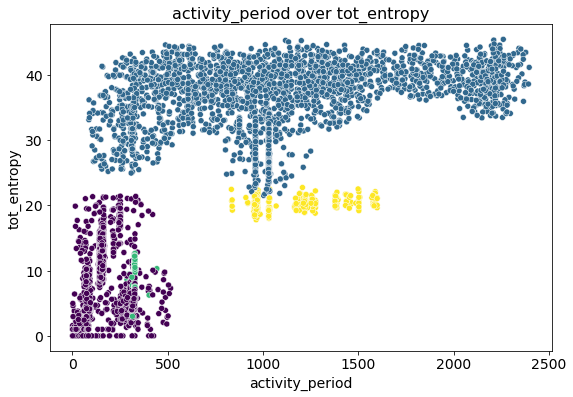

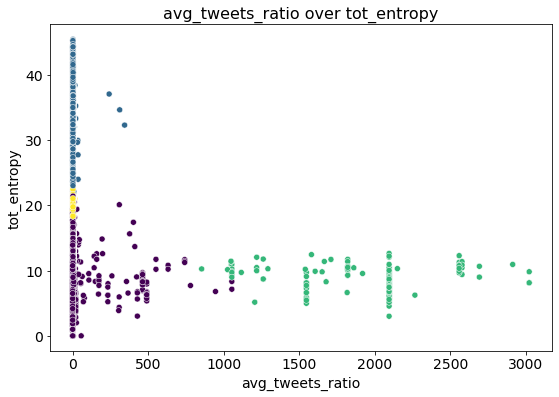

In [ ]:
cluster_plots(users_short)

when cutting off dimensions, it seems that results are quite better.

In [ ]:
scaler = StandardScaler()
X = scaler.fit_transform(users_short.values)

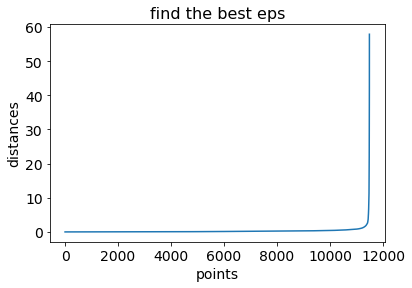

In [ ]:
nearest_neighbors = NearestNeighbors(n_neighbors=11)

neighbors = nearest_neighbors.fit(X)
distances, indices = neighbors.kneighbors(X)
distances = np.sort(distances[:,10], axis=0)

visualize(data=distances, xlabel='points', ylabel='distances', title='find the best eps')
plt.show()

<Figure size 360x360 with 0 Axes>

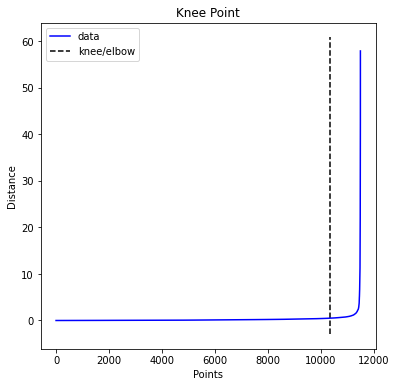

0.4990265567403943


In [ ]:
i = np.arange(len(distances))
knee = KneeLocator(i, distances, S=1, curve='convex', direction='increasing', interp_method='polynomial')

fig = plt.figure(figsize=(5, 5))
knee.plot_knee()
plt.xlabel("Points")
plt.ylabel("Distance")
plt.show()

print(distances[knee.knee])

In [ ]:
n_features = len(users_short.keys())
dbscan = DBSCAN(eps=0.5, min_samples=40)
dbscan.fit(X)

DBSCAN(min_samples=40)

In [ ]:
np.unique(dbscan.labels_, return_counts=True)

(array([-1,  0,  1,  2]), array([1414, 9613,  241,  219]))

In [ ]:
print("silhouette score: ", silhouette_score(X, dbscan.labels_))
print("davies bouldin score: ", davies_bouldin_score(X, dbscan.labels_))

silhouette score:  0.3316365236504667
davies bouldin score:  2.1021154858708577


In [ ]:
cluster_plots(users_short)

Output hidden; open in https://colab.research.google.com to view.

we obtained some kind of results, still this does not seem to be very representative

We can conclude there dbscan is not really appropriate for this type of data

## 2.4 Hierarchical clustering

### 2.4.1 Choosing the features

These are some of the approaches that can used to improve the clusterin by dimensionality reduction:

 1. statical approach: compute statistical metrics and observe data through plots, then choose which dimensions happen to be more interesting for clustering
 2. PCA: drawback we loose the meaning of axes
 3. cohen2015: SVD, ASVD, Random Projection, N-O Random Projection, Random Sampling, Deterministic Sampling
 4. Randomized Dimensionality Reduction for Clustering: see boutsidis2015
 5. marini2010: Particle Swarm Optimization for relevant clustering dimensions

#### 2.4.1.1 Statistical

In [ ]:
users_full = pd.read_csv(basepath + '/users_full_1.9.9.csv', lineterminator='\n', index_col=0)

In [ ]:
#nomalized std = std/mean = spreadness
spread = (users_full.select_dtypes(include=[int,float]).std()/users_full.select_dtypes(include=[int,float]).mean()).sort_values(ascending=False)

In [ ]:
#information = information density
from scipy.stats import entropy
entropy = users_full.select_dtypes(include=[int,float]).apply(lambda x: entropy(x,base=2)).reindex(spread.index)

In [ ]:
#total correlation
cmtr = users_full.select_dtypes(include=[int,float]).corr()
cmtr_values = cmtr.values
np.fill_diagonal(cmtr_values,0)
cmtr['sum']=np.abs(cmtr_values.sum(axis=0))
cmtr = cmtr['sum'].reindex(spread.index)

In [ ]:
spread_norm = spread/spread.max()
entropy_norm = entropy/entropy.max()
independency_norm = 1-(cmtr/cmtr.max())
entropy_norm[~np.isfinite(entropy_norm)] = entropy_norm[np.isfinite(entropy_norm)].mean()

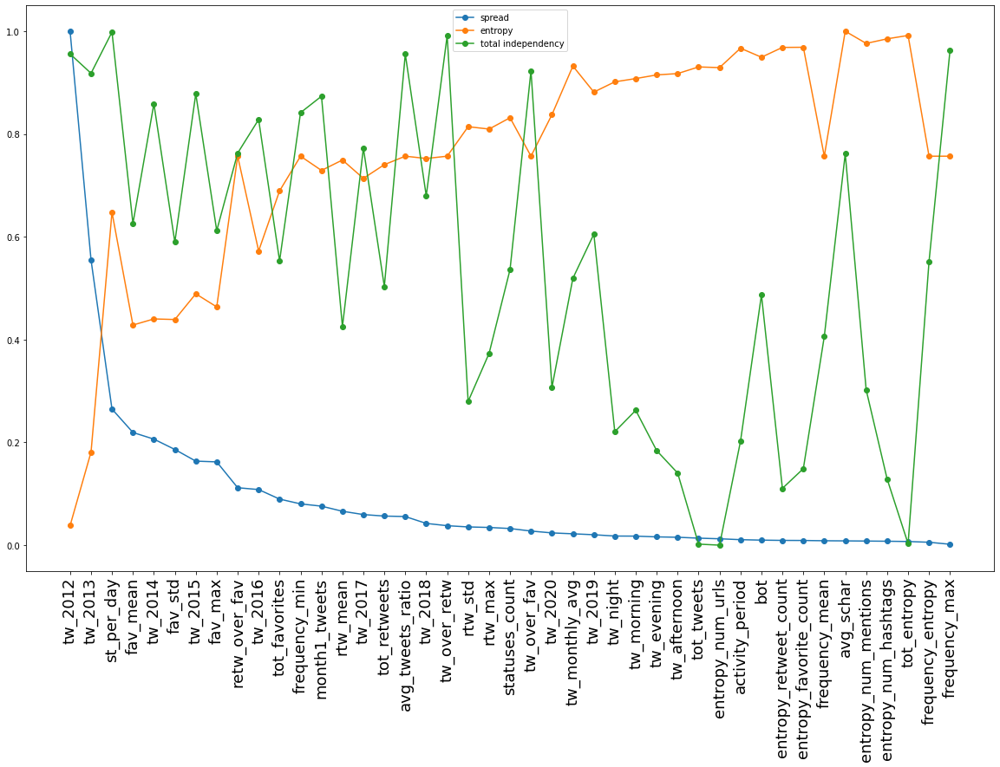

In [ ]:
plt.figure(figsize=(20, 12))
plt.plot(spread_norm, marker='o', label='spread')
plt.plot(entropy_norm, marker='o', label='entropy')
plt.plot(independency_norm, marker='o', label='total independency')
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(spread_norm.index)), spread_norm.index, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.show()

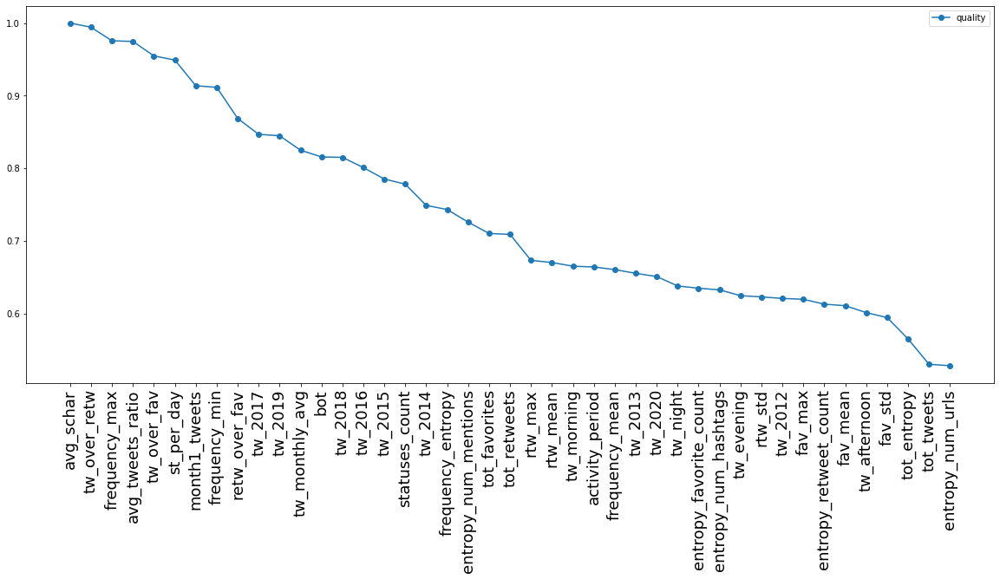

In [ ]:
#pesiamo poco lo spread altrimenti tw 2012 e 2013 finiscono in alto e sappiamo che non ci interessano a priori che hanno pochi dati
quality = (0.1*spread_norm+entropy_norm.replace([-np.inf,np.inf,np.nan],entropy_norm.mean())+independency_norm).sort_values(ascending=False)
quality = quality/quality.max()
plt.figure(figsize=(20, 8))
plt.plot(quality, marker='o', label='quality')
plt.tick_params(axis='both', which='major', labelsize=10)
plt.xticks(range(0, len(quality.index)), quality.index, fontsize=18, rotation=90)
plt.legend(fontsize=10)
plt.show()

In [ ]:
quality[:11]

avg_schar           1.000000
tw_over_retw        0.994183
frequency_max       0.975539
avg_tweets_ratio    0.974634
tw_over_fav         0.954690
st_per_day          0.949039
month1_tweets       0.913580
frequency_min       0.911402
retw_over_fav       0.868585
tw_2017             0.846647
tw_2019             0.844716
dtype: float64

In [ ]:
statistical = users_full[quality[:11].index]

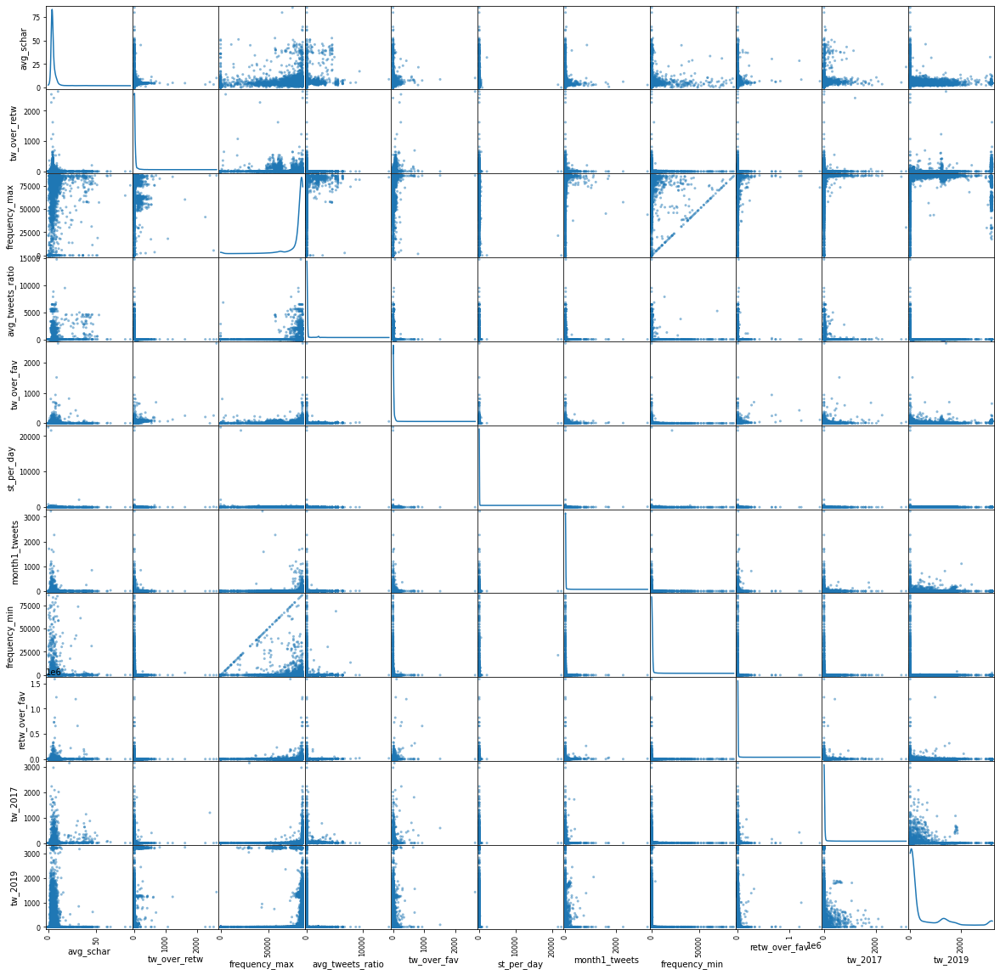

In [ ]:
pd.plotting.scatter_matrix(statistical,figsize=(20,20),diagonal='kde')
plt.show()

#### 2.4.1.2 PCA

[9.98365779e-01 1.33530089e-03 1.35537662e-04 6.98315862e-05
 3.32018597e-05 2.95690476e-05 2.47451767e-05 3.66649688e-06
 1.21489970e-06 4.91141741e-07]
[2.45345329e+08 8.97268704e+06 2.85866290e+06 2.05191282e+06
 1.41486224e+06 1.33521628e+06 1.22145713e+06 4.70174001e+05
 2.70646966e+05 1.72082368e+05]


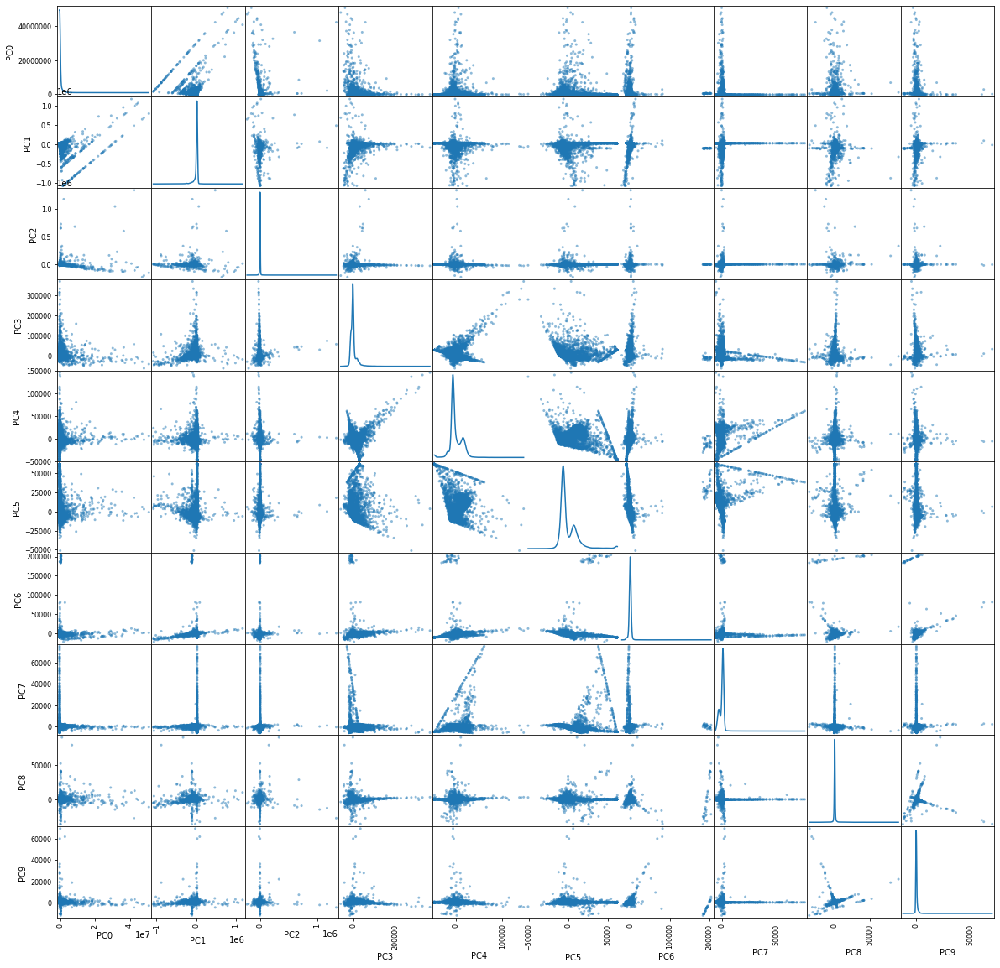

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
pca = PCA(n_components=10)
components = pca.fit(users_full.select_dtypes([int,float]))
print(pca.explained_variance_ratio_)
print(pca.singular_values_)
pca_data = pd.DataFrame(pca.transform(users_full.select_dtypes([int,float])),columns=["PC"+str(i) for i in range(10)])

pd.plotting.scatter_matrix(pca_data,figsize=(20,20),diagonal='kde')
plt.show()

[8.13694461e-01 1.64823682e-01 2.05486993e-02 5.15704929e-04]
[3184923.36620024 1433435.35993069  506128.12979862   80180.53472844]


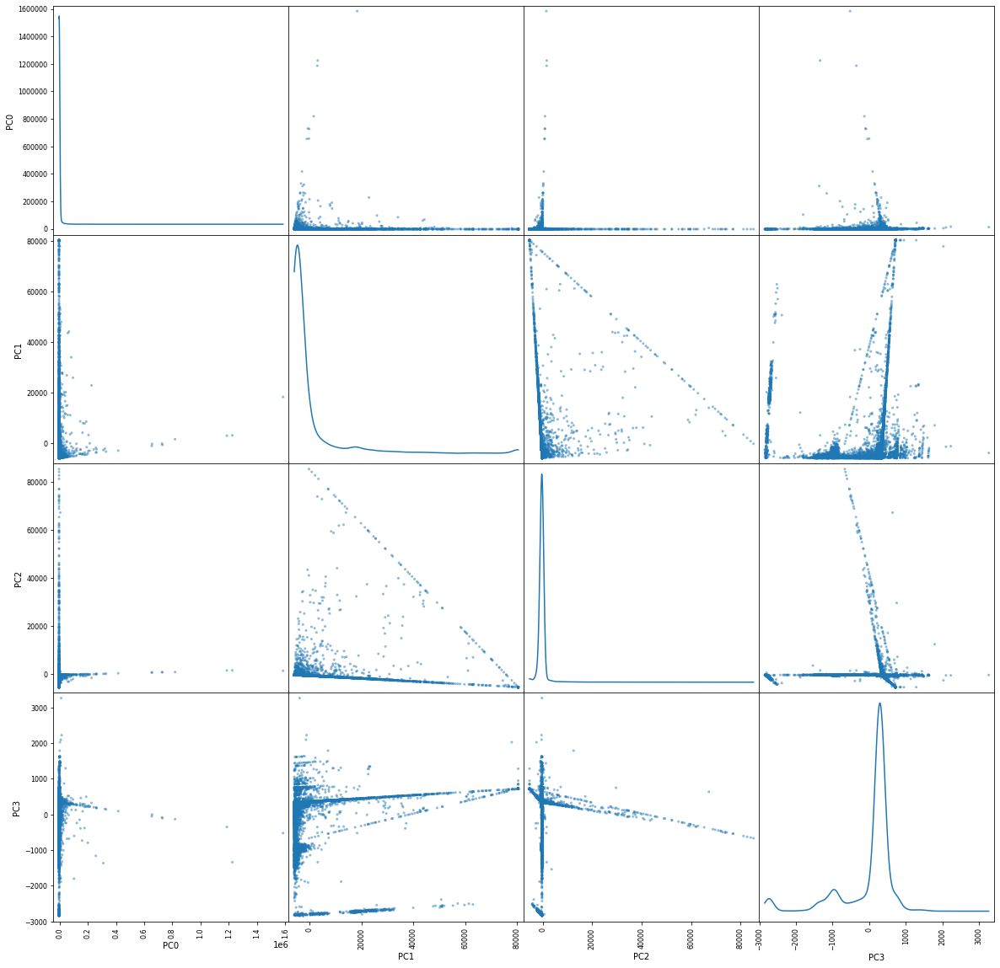

In [ ]:
pca_statistical = PCA(n_components=4)
components_statistical = pca_statistical.fit(statistical)
print(pca_statistical.explained_variance_ratio_)
print(pca_statistical.singular_values_)
pca_statistical_data = pd.DataFrame(pca_statistical.transform(statistical),columns=["PC"+str(i) for i in range(4)])

pd.plotting.scatter_matrix(pca_statistical_data,figsize=(20,20),diagonal='kde')
plt.show()

#### 2.4.1.X Normalizations

In [ ]:
cl_dfs = {
    "statistical(df)":statistical,
    "pca10(df)":pca_data,
    "pca4(statistical(df))":pca_statistical_data,
}

In [ ]:
def apply_transform(dataframes_dict,transform_name,transform):
  return {transform_name+"("+k+")":transform(d) for k,d in dataframes_dict.items()}

In [ ]:
standard_normal = lambda df : (df-df.mean())/df.std()
minmax_normal = lambda df : (df-df.min())/(df.max()-df.min())
log =  lambda df : np.log(0.001+df-df.min(axis=0))

In [ ]:
cl_dfs = {**cl_dfs ,
          **apply_transform(cl_dfs,"std_norm",standard_normal),
          **apply_transform(cl_dfs,"minmax",minmax_normal),
          **apply_transform(cl_dfs,"log",log),
          **apply_transform(apply_transform(cl_dfs,"log",log),"std_norm",standard_normal),
          **apply_transform(apply_transform(cl_dfs,"log",log),"minmax",standard_normal),
          } # concatenating dicts
cl_dfs.keys()
len(cl_dfs)

18

### 2.4.2 Hierarchical clustering algorithms


The main hierarchical cl. alg. are the following:

AGGLOMERATIVE Name [properties] {parameter}
 - Min [less divisive, good for concave shapes] {single}
 - Max [complete linkage, more divisive (good and bad)] {complete}
 - Average [globular biased, less noise susceptible] {average}
 - WARD [increase in squared error, can be used to initialized K-means] {ward}


DIVISIVE
 - bisecting k-means hierarchical clustering


In [ ]:
from scipy.cluster.hierarchy import dendrogram
from sklearn.datasets import load_iris
from sklearn.cluster import AgglomerativeClustering
from scipy import interpolate
from scipy.spatial import ConvexHull
import matplotlib

###### visualization tools

In [ ]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)
    plt.xlabel("(Number of points in node) / index of point")

In [ ]:
def ellipse(points,color="blue",border=1.5):
    gpca = PCA(2)
    gpca.fit(points)
    R=gpca.components_
    #assert 1==round(np.linalg.det(R),1), "Not stable" # this is the rotation that gives us our transformed space
    rotated = np.dot(R.T,points.T).T
    #print(R)
    deltas = (rotated.max(axis=0)-rotated.min(axis=0))
    xy=np.dot(R, (rotated.max(axis=0)-deltas/2).T)
    a=np.degrees(np.arctan(R[1,0]/R[0,0]))
    #print(xy,deltas,a)
    ellipse = matplotlib.patches.Ellipse(xy, *deltas*border, angle=a,facecolor="none",edgecolor=color)
    plt.gca().add_patch(ellipse)

def plot_groups(data,model_labels,dimentions,colors,border=1,mode='ellipse'):
    for i in np.unique(model_labels):
        points = data[model_labels == i][dimentions].values
        if mode == 'ellipse':
            ellipse(points,colors[i],border=border)
        elif mode == 'envelop':
            hull = ConvexHull(points)
            x_hull = np.append(points[hull.vertices,0],
                              points[hull.vertices,0][0])
            y_hull = np.append(points[hull.vertices,1],
                              points[hull.vertices,1][0])
            #without interp:
            plt.fill(x_hull, y_hull, alpha=0.9,facecolor='none',edgecolor=colors[i],linewidth=3)
        else:
            assert False, "invalid mode"

#### 2.4.3.1 Agglomerative

In [ ]:
def my_agg_h_clustering(data=cl_dfs['statistical(df)'],view=["frequency_max","tw_over_retw"],linkage="ward",stages=["dendrogram","highlight","matrixplot"],ax=None,n_clusters=8):
    fig, axs = plt.subplots(1,max(1,len(stages)-1),figsize=(20,6))
    if ax:
        plt.sca(ax)
    else:
        if len(stages)>1:
            plt.sca(axs[0])
        else:
            plt.sca(axs)
    if "dendrogram" in stages:
        model = AgglomerativeClustering(n_clusters=n_clusters,compute_full_tree=True,compute_distances=True, linkage=linkage)
        model = model.fit(data)
        # plot the top three levels of the dendrogram
        plt.title("Hierarchical Clustering Dendrogram")
        plot_dendrogram(model, truncate_mode="level", p=5)
    #------------
    if "highlight" in stages:
        if len(stages)>1:
          plt.sca(axs[1])
        else:
          plt.sca(axs)
        ax=axs[1]
        scatter=True
        color_order=["orange","green","blue"]
        for i,n in enumerate([n_clusters,4,2]):
            model = AgglomerativeClustering(n_clusters=n,compute_full_tree=True,compute_distances=True, linkage=linkage)
            model = model.fit(data)
            
            colors = plt.cm.nipy_spectral(np.linspace(.05,.95,1+max(model.labels_)))
            c=list(map(lambda x: colors[x],model.labels_))
            if scatter==True:
                p = data.plot.scatter(*view,c=c,alpha=.2,ax=ax,)
                scatter=False
            plot_groups(data,model.labels_,view, colors=[color_order[i]]*len(colors), border=1.2)
    if not ax:
        plt.show()
    #------------
    if "matrixplot" in stages:
        model = AgglomerativeClustering(n_clusters=n_clusters,compute_full_tree=True,compute_distances=True, linkage=linkage)
        model = model.fit(data)
        pd.plotting.scatter_matrix(data,figsize=(20,20),c=model.labels_,alpha=.3)
        plt.show()
    return model.labels_

In [ ]:
def my_agg_h_clustering_dendrogram(data=cl_dfs['statistical(df)'],linkage="ward",ax=None):
    plt.sca(ax)
    model = AgglomerativeClustering(n_clusters=8,compute_full_tree=True,compute_distances=True, linkage=linkage)
    model = model.fit(data)
    # plot the top three levels of the dendrogram
    plot_dendrogram(model, truncate_mode="level", p=5)
    plt.gca().get_xaxis().set_visible(False)

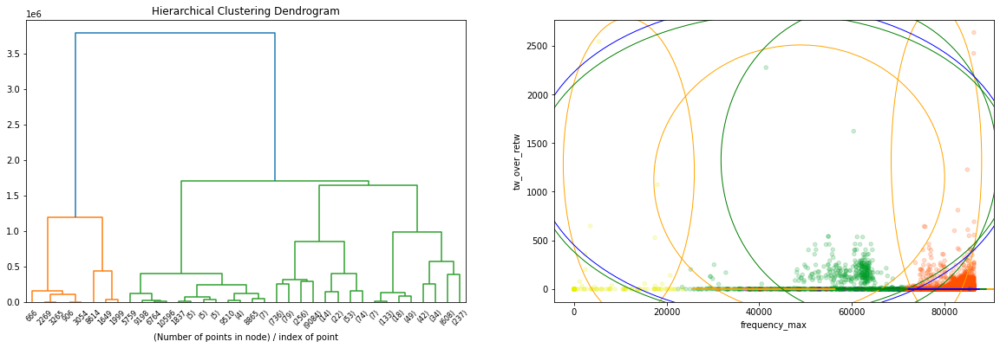

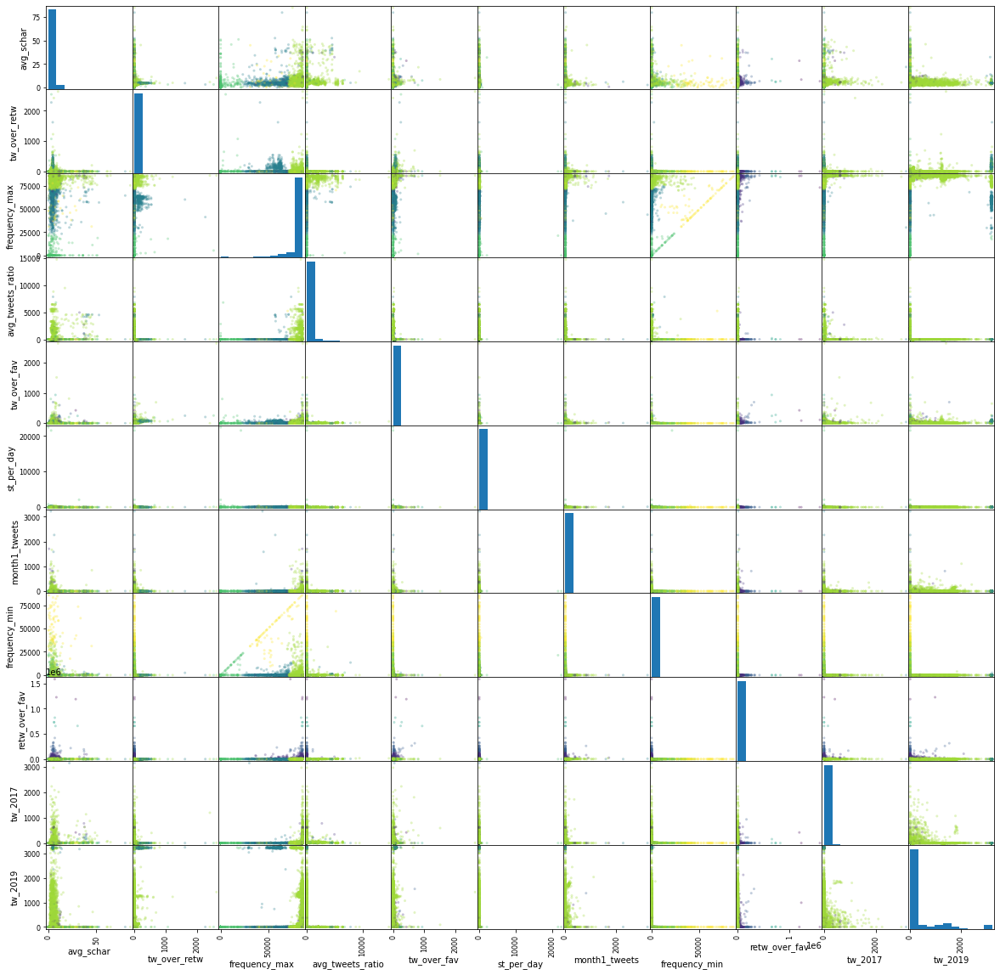

array([6, 6, 3, ..., 6, 6, 6])

In [ ]:
my_agg_h_clustering(data=cl_dfs['statistical(df)'],view=["frequency_max","tw_over_retw"],linkage="ward")

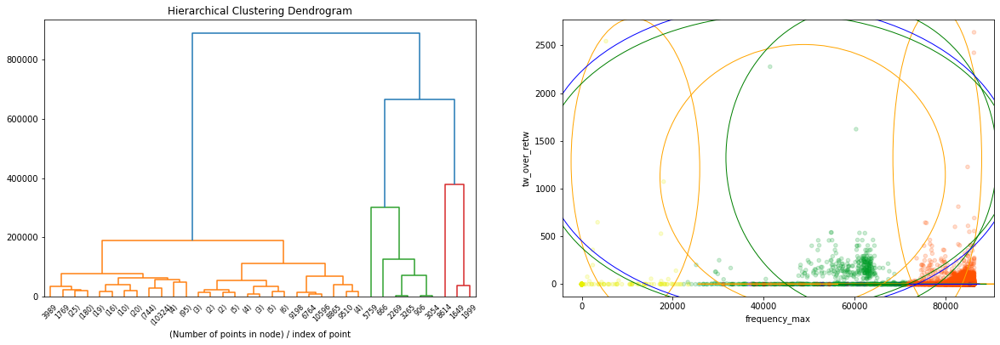

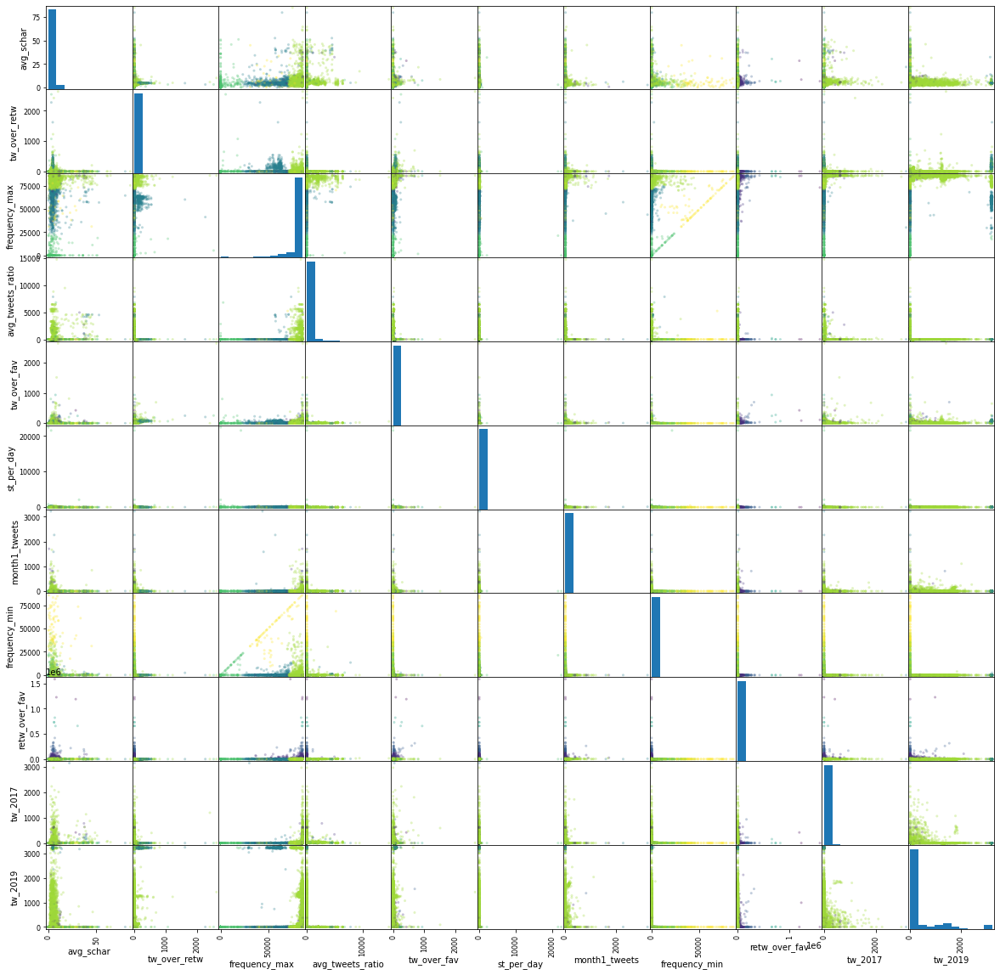

array([6, 6, 3, ..., 6, 6, 6])

In [ ]:
my_agg_h_clustering(data=cl_dfs['statistical(df)'],view=["frequency_max","tw_over_retw"],linkage="average")

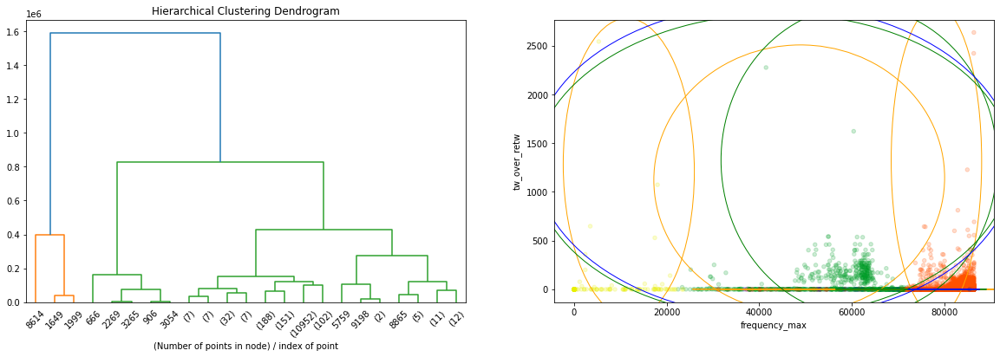

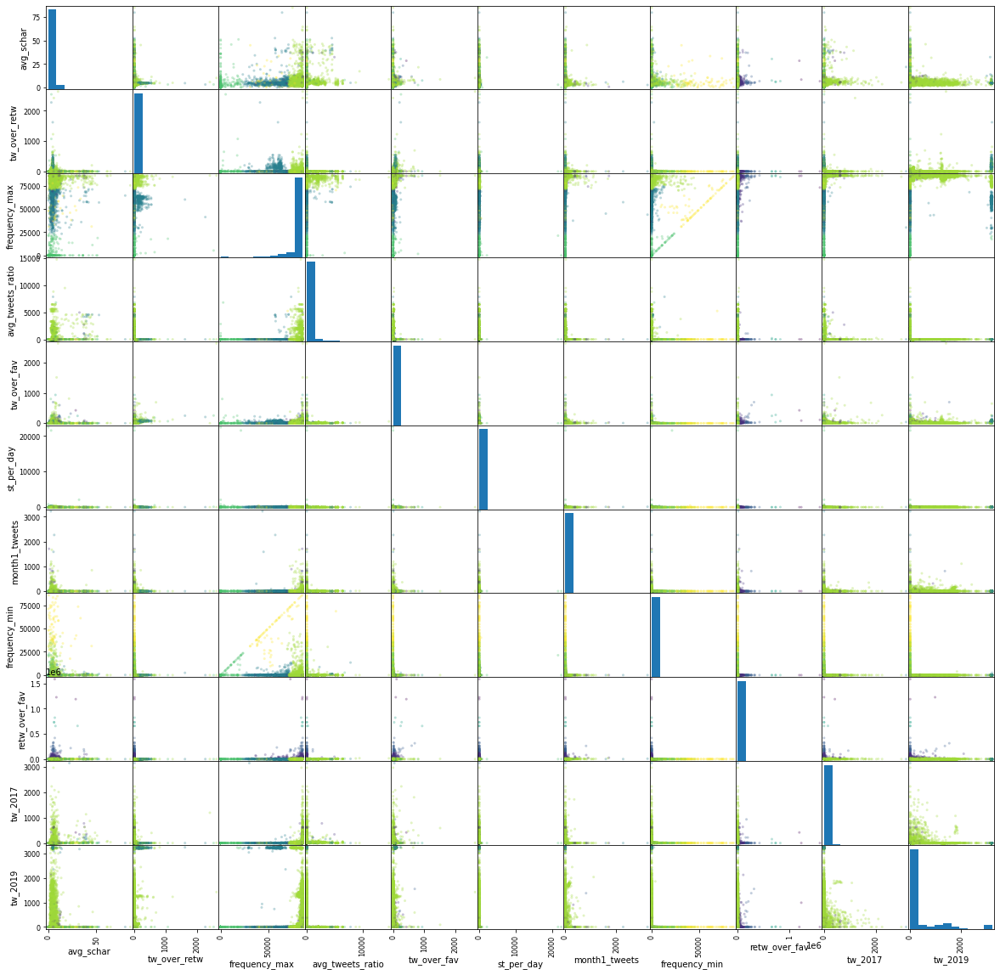

array([6, 6, 3, ..., 6, 6, 6])

In [ ]:
my_agg_h_clustering(data=cl_dfs['statistical(df)'],view=["frequency_max","tw_over_retw"],linkage="complete")

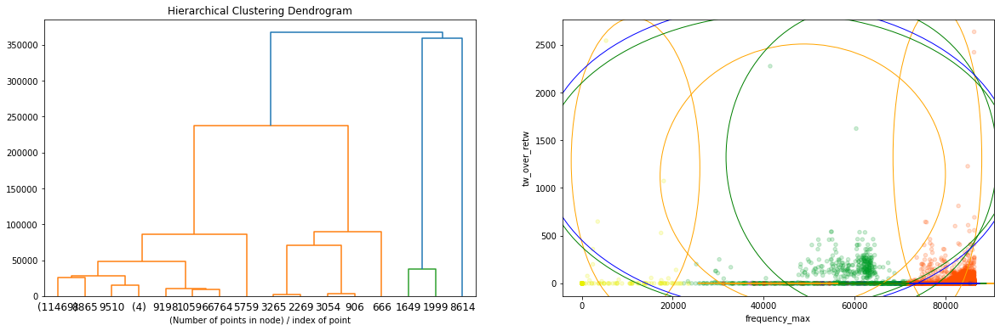

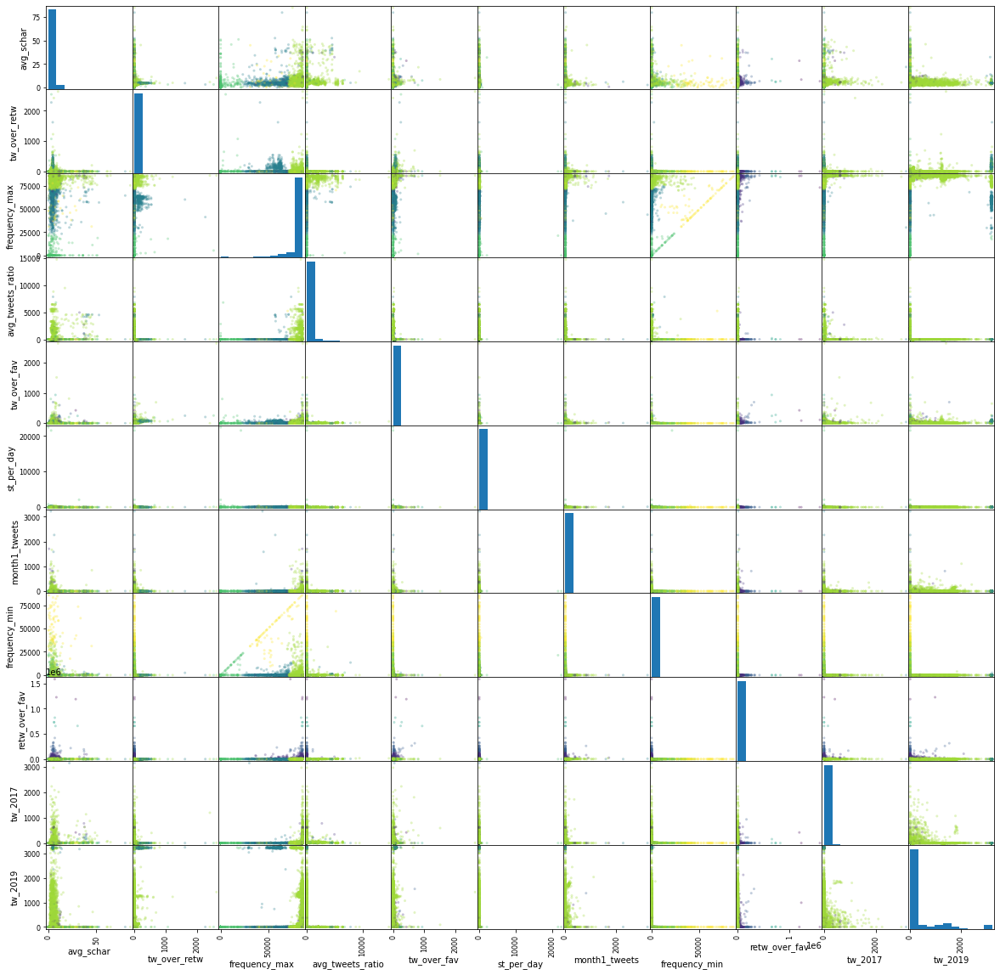

array([6, 6, 3, ..., 6, 6, 6])

In [ ]:
my_agg_h_clustering(data=cl_dfs['statistical(df)'],view=["frequency_max","tw_over_retw"],linkage="single")

the dendrogram of the "complete (max)" linkage shows the best distance between clusters, we will now try it on different datasets ( by dim. reduction and normalization)

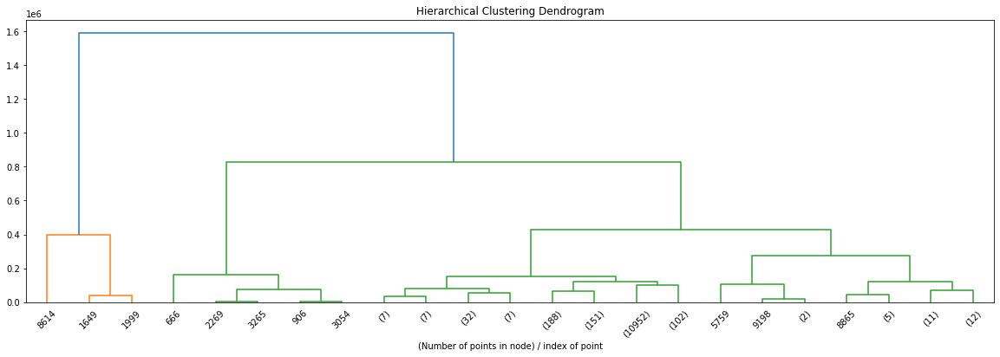

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
my_agg_h_clustering(data=cl_dfs['statistical(df)'],linkage="complete",stages=["dendrogram"])

prepocessing statistical(df) ...
prepocessing pca10(df) ...
prepocessing pca4(statistical(df)) ...
prepocessing std_norm(statistical(df)) ...
prepocessing std_norm(pca10(df)) ...
prepocessing std_norm(pca4(statistical(df))) ...
prepocessing minmax(statistical(df)) ...
prepocessing minmax(pca10(df)) ...
prepocessing minmax(pca4(statistical(df))) ...
prepocessing log(statistical(df)) ...
prepocessing log(pca10(df)) ...
prepocessing log(pca4(statistical(df))) ...
prepocessing std_norm(log(statistical(df))) ...
prepocessing std_norm(log(pca10(df))) ...
prepocessing std_norm(log(pca4(statistical(df)))) ...
prepocessing minmax(log(statistical(df))) ...
prepocessing minmax(log(pca10(df))) ...
prepocessing minmax(log(pca4(statistical(df)))) ...


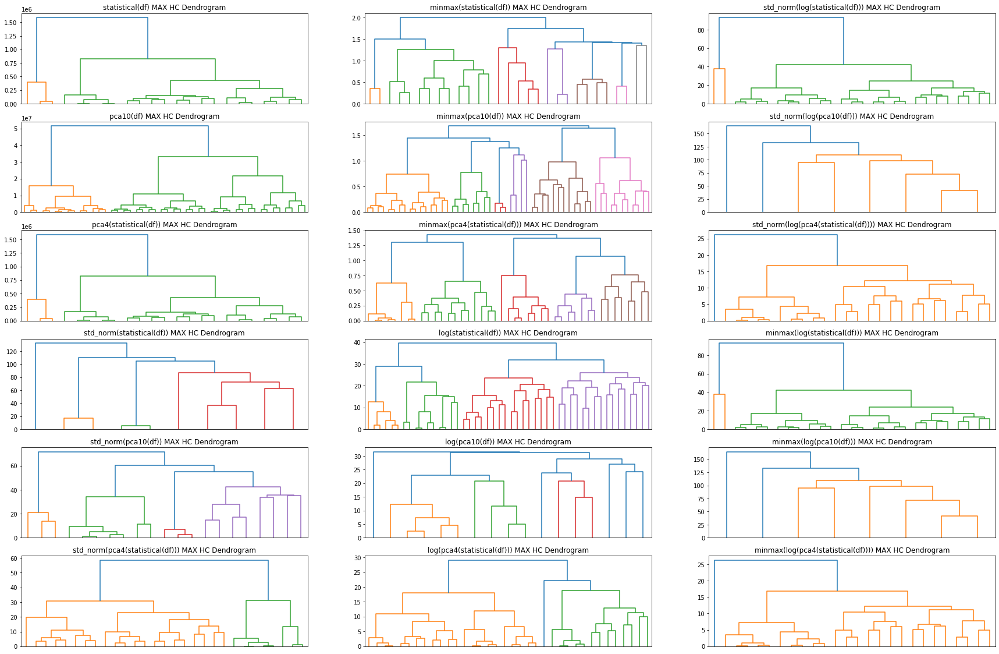

In [ ]:
rows = int(np.ceil(len(cl_dfs)/3))
fig,axs = plt.subplots(rows,3,figsize=(30,20))
data_iterator = iter(cl_dfs.items())
for j in range(3):
  for i in range(rows):
    plt.sca(axs[i,j])
    name,_d = next(data_iterator)
    print(f"prepocessing {name} ...")
    my_agg_h_clustering_dendrogram(data=_d,linkage="complete",ax=axs[i,j])
    plt.title(f"{name} MAX HC Dendrogram")

plt.show()

prepocessing statistical(df) ...
prepocessing pca10(df) ...
prepocessing pca4(statistical(df)) ...
prepocessing std_norm(statistical(df)) ...
prepocessing std_norm(pca10(df)) ...
prepocessing std_norm(pca4(statistical(df))) ...
prepocessing minmax(statistical(df)) ...
prepocessing minmax(pca10(df)) ...
prepocessing minmax(pca4(statistical(df))) ...
prepocessing log(statistical(df)) ...
prepocessing log(pca10(df)) ...
prepocessing log(pca4(statistical(df))) ...
prepocessing std_norm(log(statistical(df))) ...
prepocessing std_norm(log(pca10(df))) ...
prepocessing std_norm(log(pca4(statistical(df)))) ...
prepocessing minmax(log(statistical(df))) ...
prepocessing minmax(log(pca10(df))) ...
prepocessing minmax(log(pca4(statistical(df)))) ...


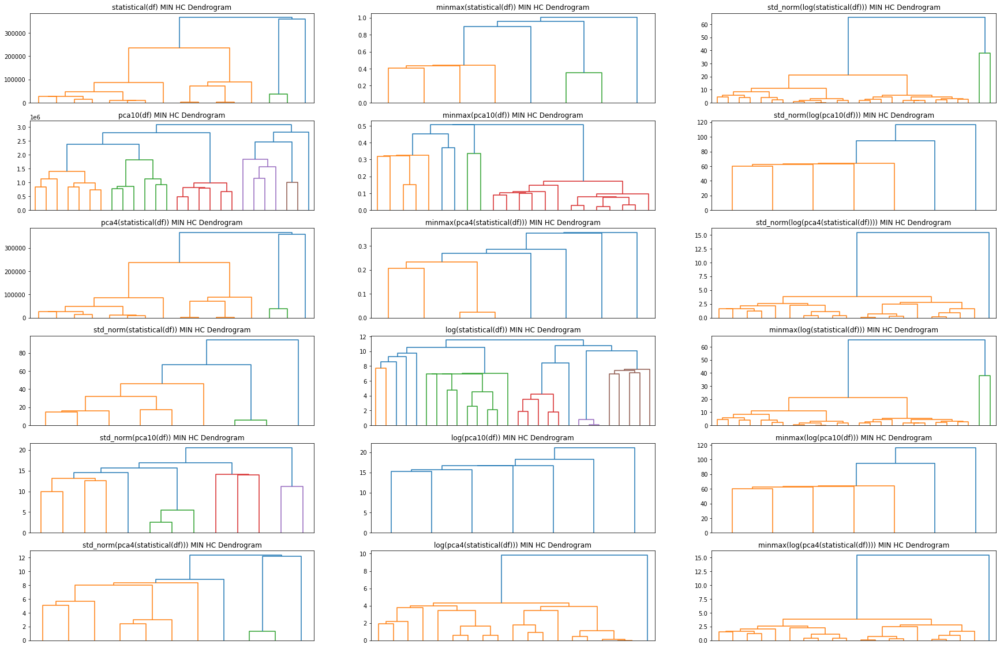

In [ ]:
rows = int(np.ceil(len(cl_dfs)/3))
fig,axs = plt.subplots(rows,3,figsize=(30,20))
data_iterator = iter(cl_dfs.items())
for j in range(3):
  for i in range(rows):
    plt.sca(axs[i,j])
    name,_d = next(data_iterator)
    print(f"prepocessing {name} ...")
    my_agg_h_clustering_dendrogram(data=_d,linkage="single",ax=axs[i,j])
    plt.title(f"{name} MIN HC Dendrogram")

plt.show()

prepocessing statistical(df) ...
prepocessing pca10(df) ...
prepocessing pca4(statistical(df)) ...
prepocessing std_norm(statistical(df)) ...
prepocessing std_norm(pca10(df)) ...
prepocessing std_norm(pca4(statistical(df))) ...
prepocessing minmax(statistical(df)) ...
prepocessing minmax(pca10(df)) ...
prepocessing minmax(pca4(statistical(df))) ...
prepocessing log(statistical(df)) ...
prepocessing log(pca10(df)) ...
prepocessing log(pca4(statistical(df))) ...
prepocessing std_norm(log(statistical(df))) ...
prepocessing std_norm(log(pca10(df))) ...
prepocessing std_norm(log(pca4(statistical(df)))) ...
prepocessing minmax(log(statistical(df))) ...
prepocessing minmax(log(pca10(df))) ...
prepocessing minmax(log(pca4(statistical(df)))) ...


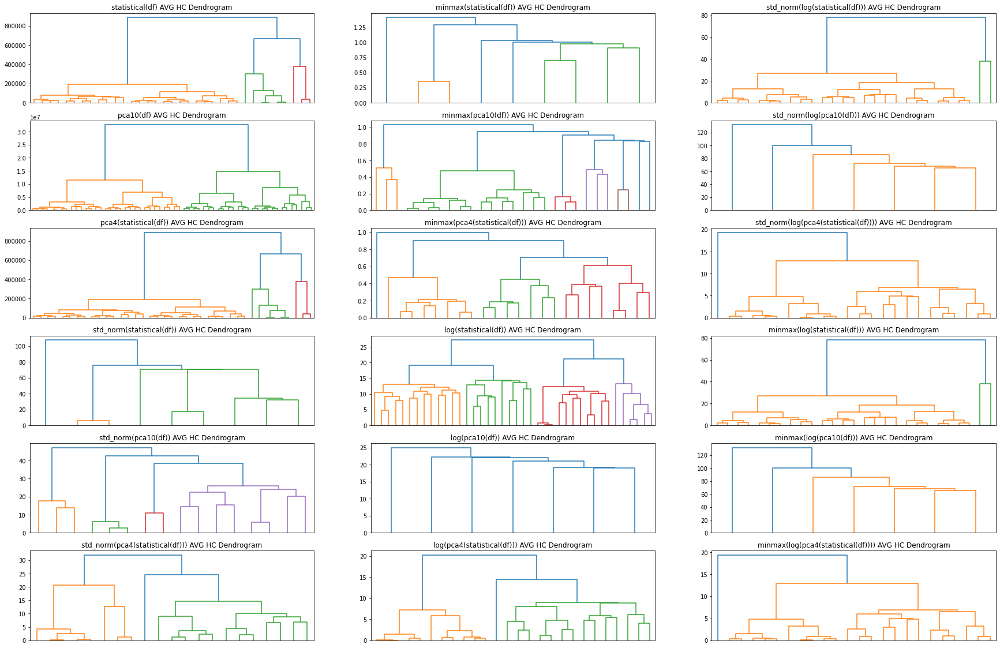

In [ ]:
rows = int(np.ceil(len(cl_dfs)/3))
fig,axs = plt.subplots(rows,3,figsize=(30,20))
data_iterator = iter(cl_dfs.items())
for j in range(3):
  for i in range(rows):
    plt.sca(axs[i,j])
    name,_d = next(data_iterator)
    print(f"prepocessing {name} ...")
    my_agg_h_clustering_dendrogram(data=_d,linkage="average",ax=axs[i,j])
    plt.title(f"{name} AVG HC Dendrogram")

plt.show()

prepocessing statistical(df) ...
prepocessing pca10(df) ...
prepocessing pca4(statistical(df)) ...
prepocessing std_norm(statistical(df)) ...
prepocessing std_norm(pca10(df)) ...
prepocessing std_norm(pca4(statistical(df))) ...
prepocessing minmax(statistical(df)) ...
prepocessing minmax(pca10(df)) ...
prepocessing minmax(pca4(statistical(df))) ...
prepocessing log(statistical(df)) ...
prepocessing log(pca10(df)) ...
prepocessing log(pca4(statistical(df))) ...
prepocessing std_norm(log(statistical(df))) ...
prepocessing std_norm(log(pca10(df))) ...
prepocessing std_norm(log(pca4(statistical(df)))) ...
prepocessing minmax(log(statistical(df))) ...
prepocessing minmax(log(pca10(df))) ...
prepocessing minmax(log(pca4(statistical(df)))) ...


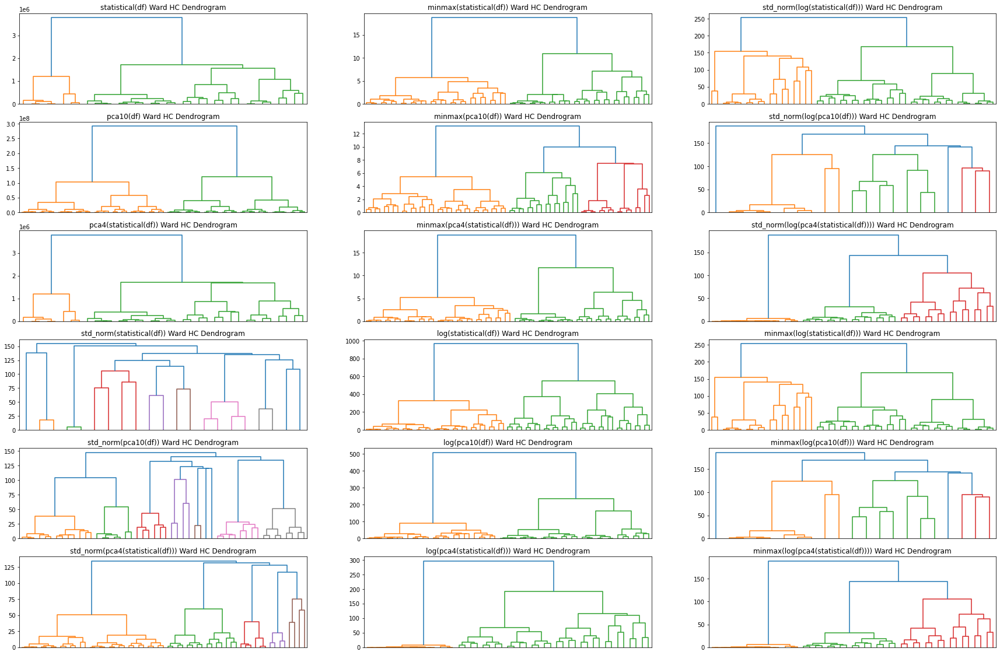

In [ ]:
rows = int(np.ceil(len(cl_dfs)/3))
fig,axs = plt.subplots(rows,3,figsize=(30,20))
data_iterator = iter(cl_dfs.items())
for j in range(3):
  for i in range(rows):
    plt.sca(axs[i,j])
    name,_d = next(data_iterator)
    print(f"prepocessing {name} ...")
    my_agg_h_clustering_dendrogram(data=_d,linkage="ward",ax=axs[i,j])
    plt.title(f"{name} Ward HC Dendrogram")

plt.show()

#### 2.4.3.2 Agglomerative In depth

##### Min, Avg, Ward @  PCA10 - PC: 0,3,4,5

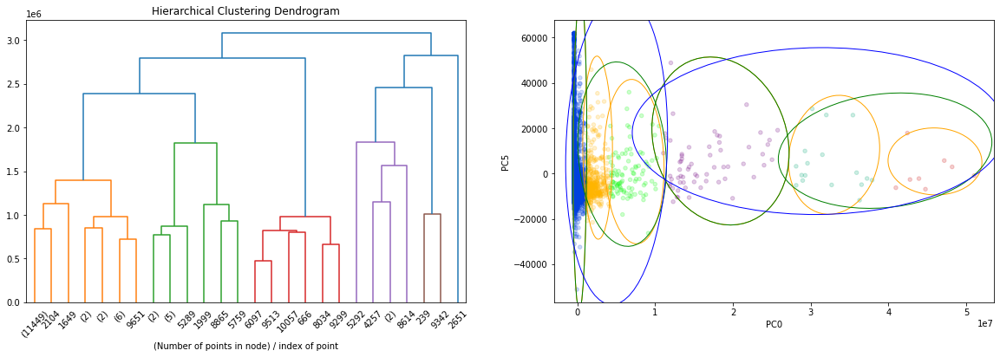

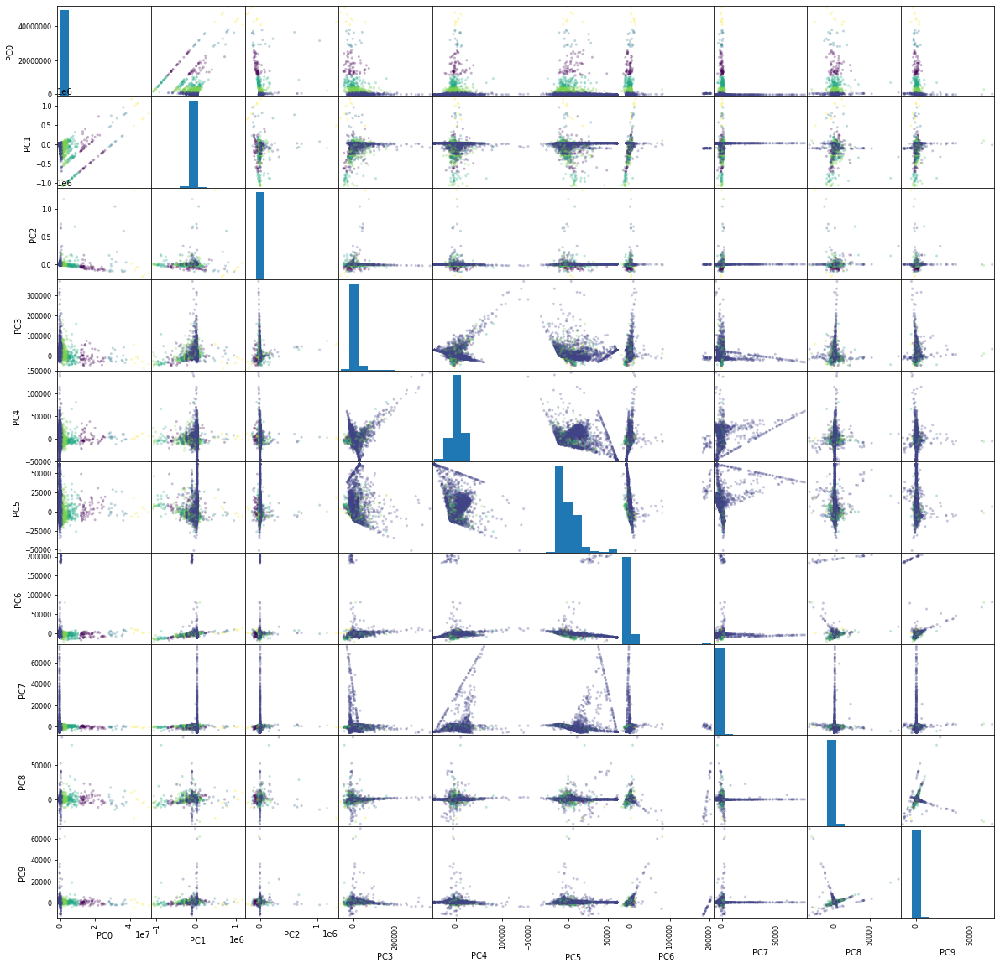

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['pca10(df)'],view=["PC0","PC5"],linkage="single",n_clusters=6)

In [ ]:
cl_dfs['pca10(df)']

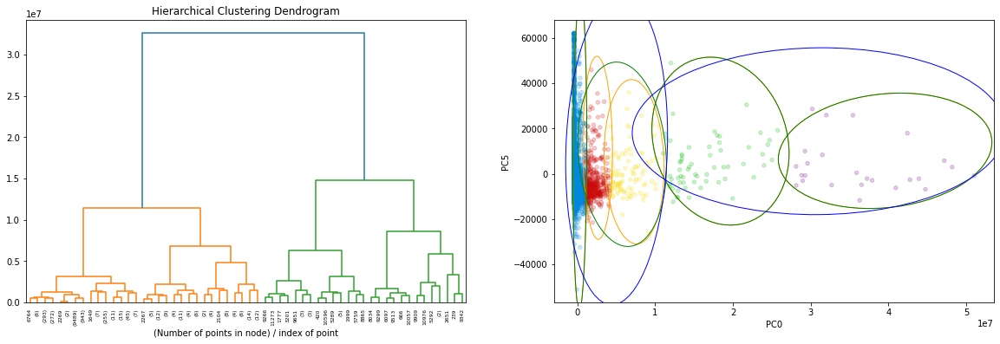

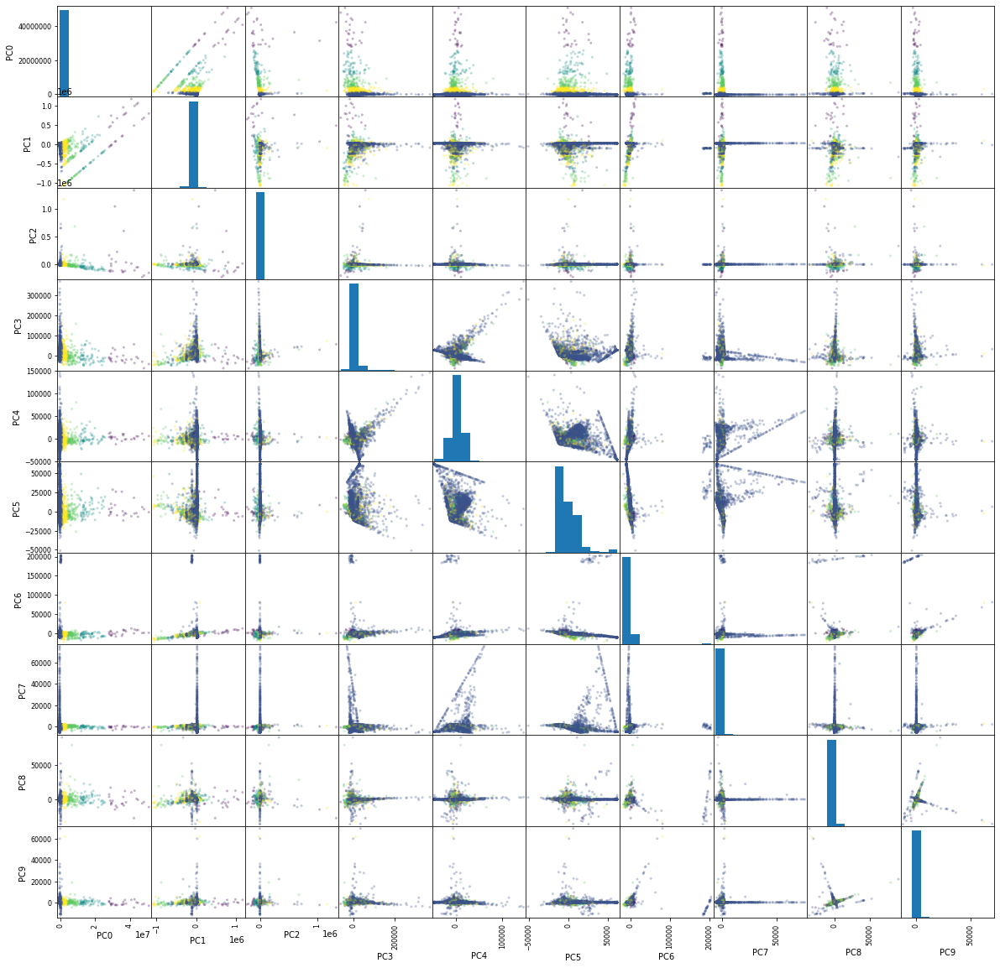

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['pca10(df)'],view=["PC0","PC5"],linkage="average",n_clusters=6)

In [ ]:
# avg linkages improved separation

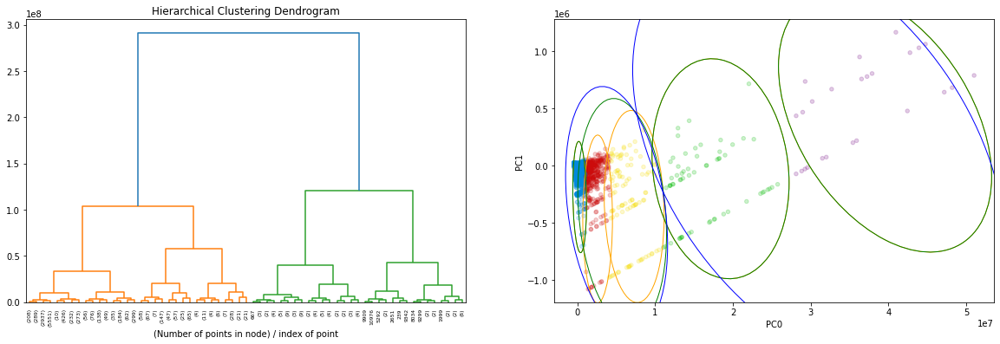

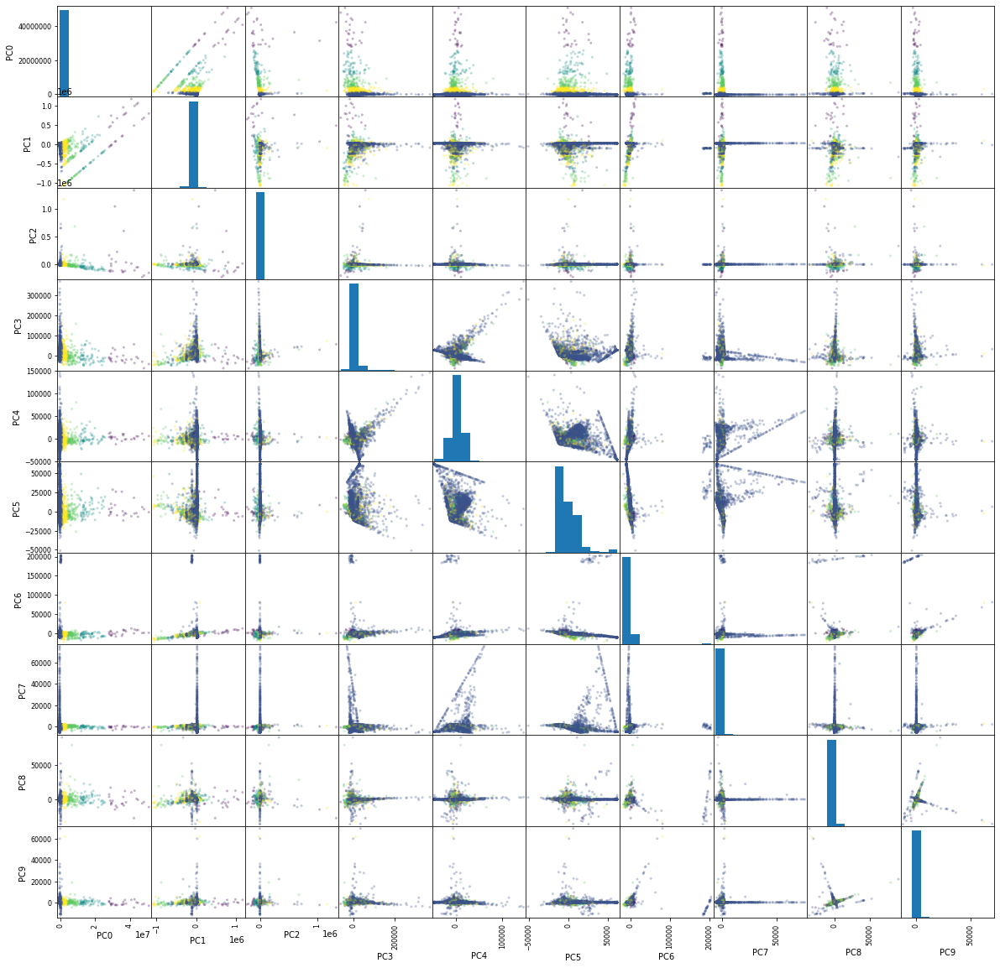

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['pca10(df)'],view=["PC0","PC1"],linkage="ward",n_clusters=5)

In [ ]:
# ward linkage improves separation even more retaining the same cluster structure

##### MinLinkage log(PCA10) - PC 0,7

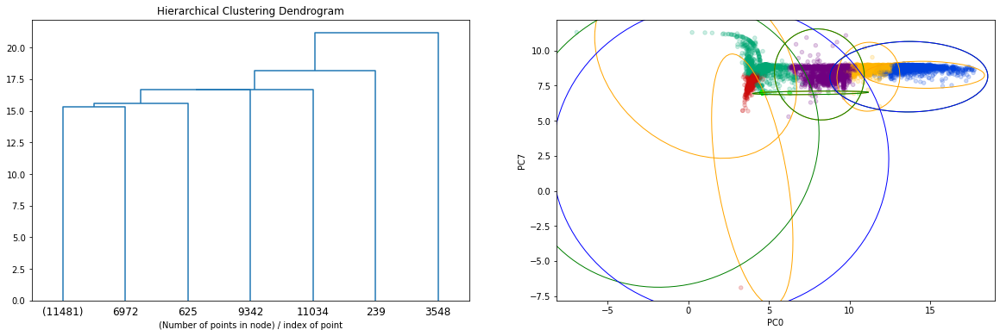

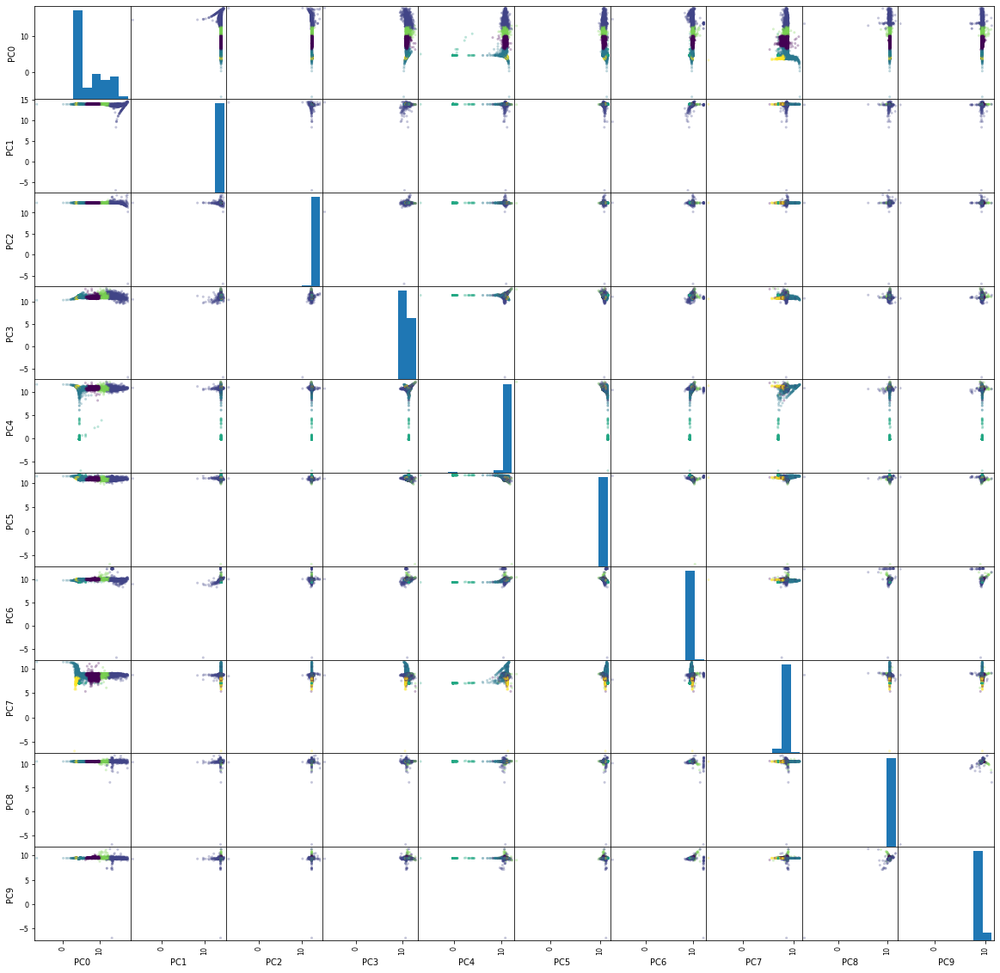

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['log(pca10(df))'],view=["PC0","PC7"],linkage="single",n_clusters=6)

##### MinLinkage log(statistical)

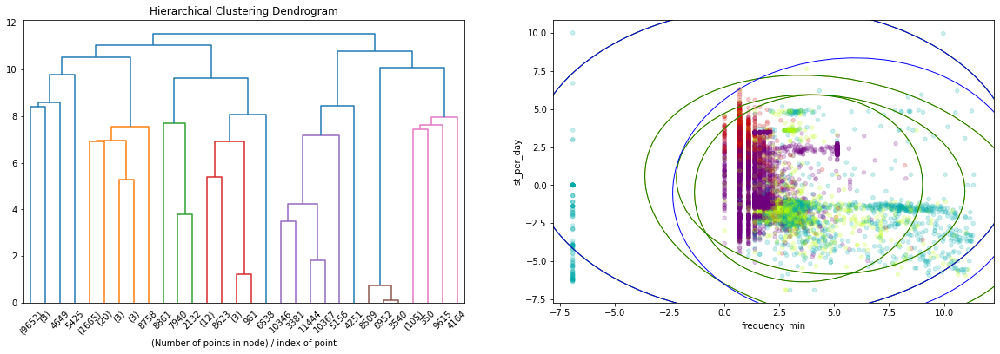

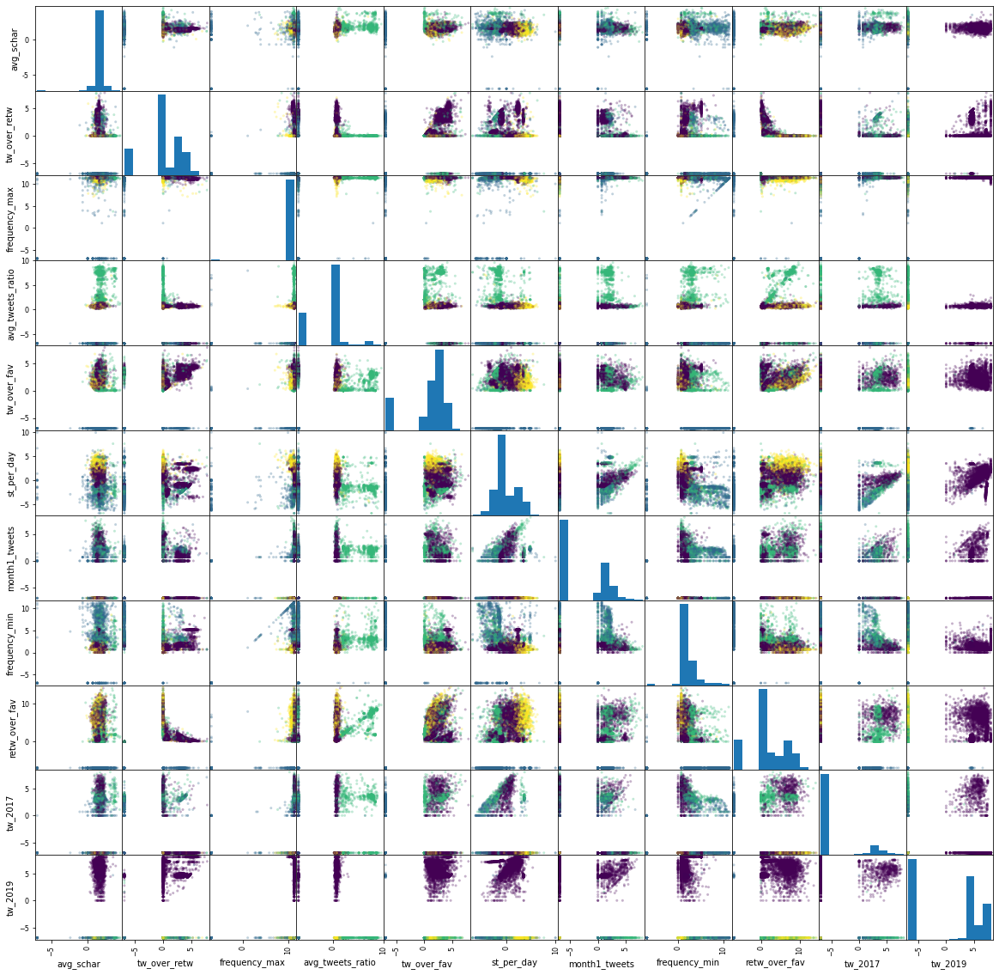

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['log(statistical(df))'],view=["frequency_min","st_per_day"],linkage="single",n_clusters=4)#["avg_tweets_ratio","retw_over_fav"]

In [ ]:
np.unique(labels)

array([0, 1, 2, 3])

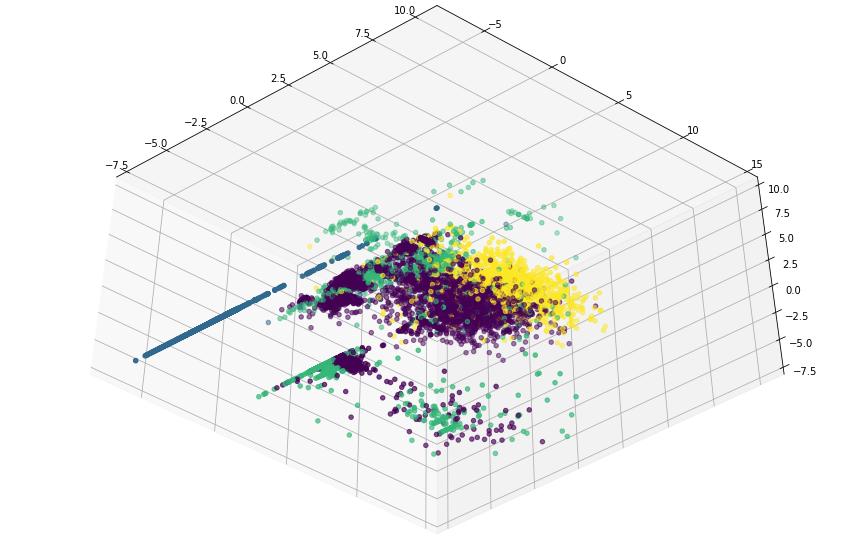

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(cl_dfs['log(statistical(df))'][['st_per_day']], cl_dfs['log(statistical(df))'][['retw_over_fav']], cl_dfs['log(statistical(df))'][['avg_tweets_ratio']], c=labels);
ax.view_init(-50, -45)
plt.draw()

##### AvgLinkage log(statistical)

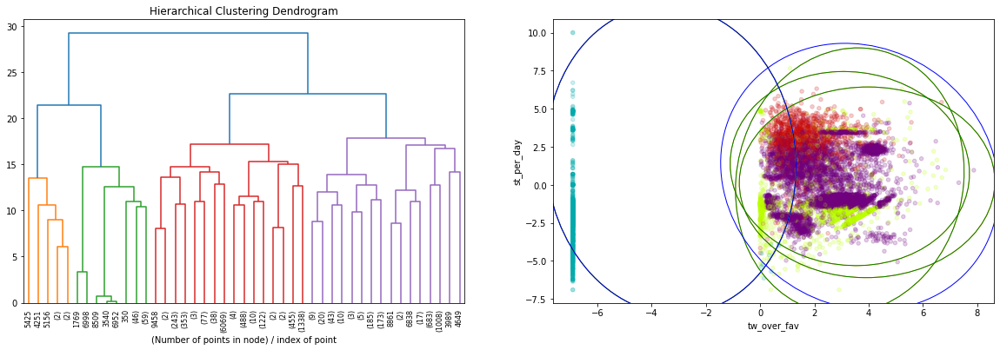

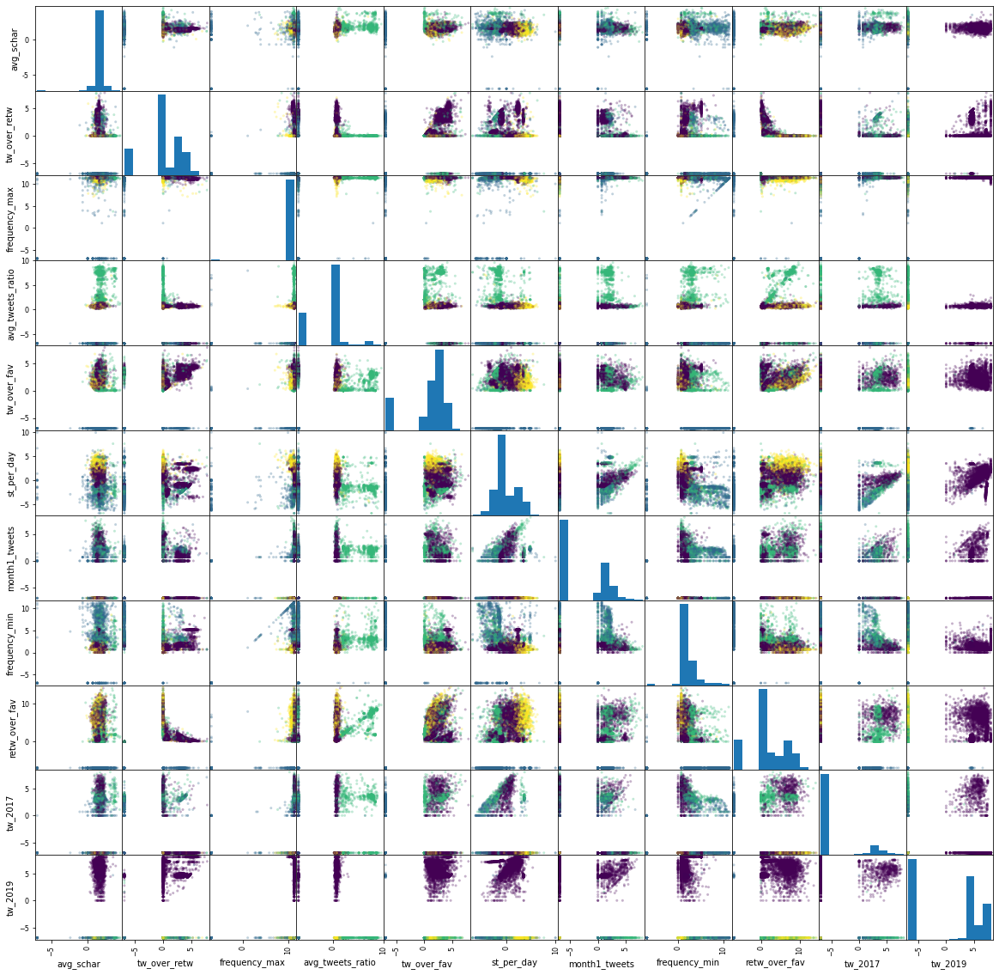

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['log(statistical(df))'],view=["tw_over_fav","st_per_day"],linkage="average",n_clusters=4)#["avg_tweets_ratio","retw_over_fav"]

In [ ]:
np.unique(labels)

array([0, 1, 2, 3])

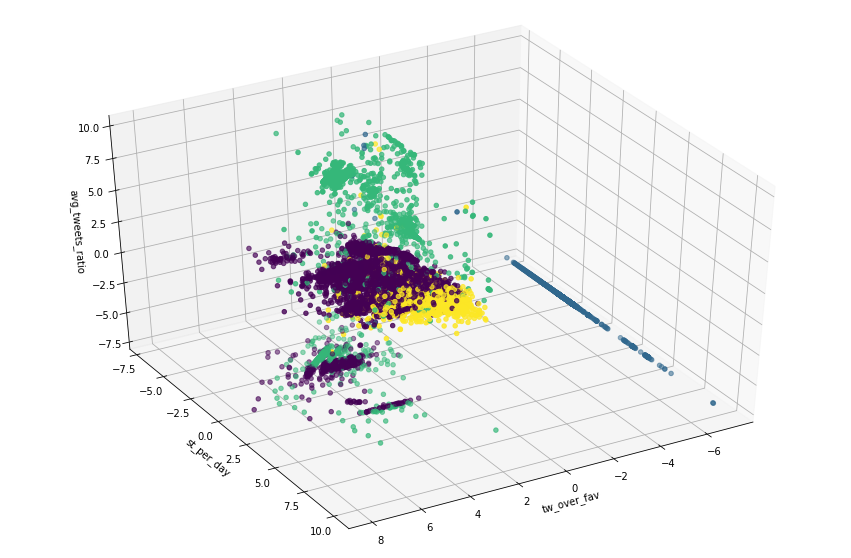

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(cl_dfs['log(statistical(df))'][['tw_over_fav']], cl_dfs['log(statistical(df))'][['st_per_day']], cl_dfs['log(statistical(df))'][['avg_tweets_ratio']], c=labels);
ax.set_xlabel("tw_over_fav")
ax.set_ylabel("st_per_day")
ax.set_zlabel("avg_tweets_ratio")
ax.view_init(40, 60)
plt.draw()

##### avg std_norm(log(statistical))

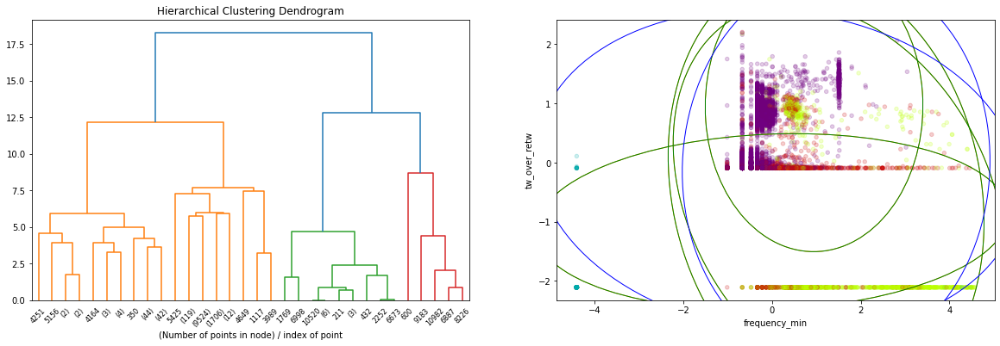

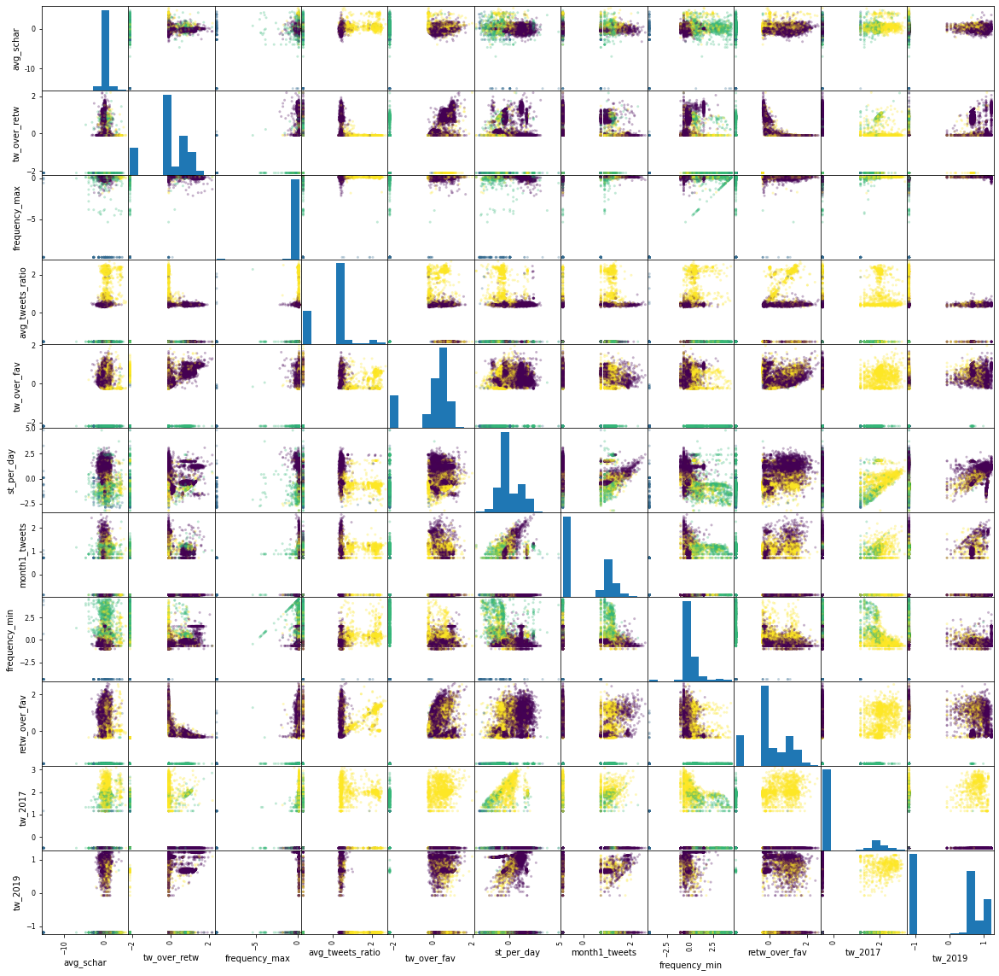

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['std_norm(log(statistical(df)))'],view=["frequency_min","tw_over_retw"],linkage="average",n_clusters=4)#["avg_tweets_ratio","retw_over_fav"]

In [ ]:
np.unique(labels)

array([0, 1, 2, 3])

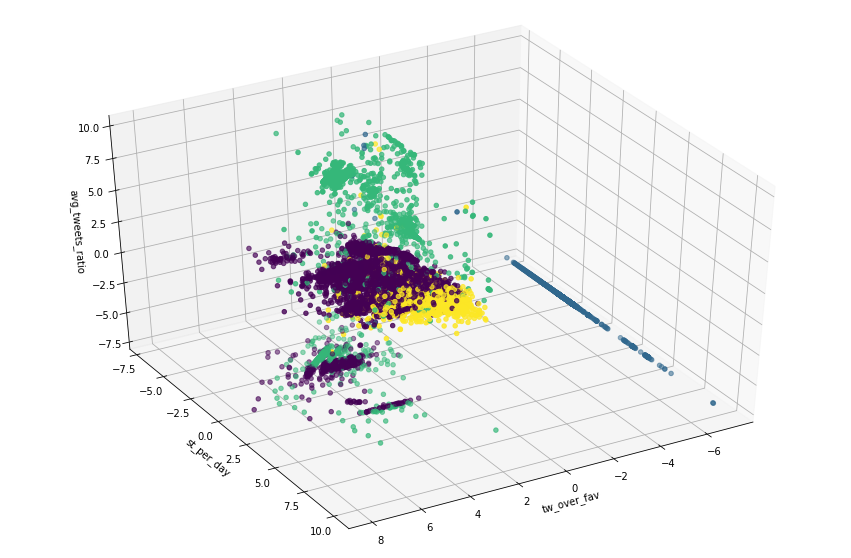

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(cl_dfs['log(statistical(df))'][['tw_over_fav']], cl_dfs['log(statistical(df))'][['st_per_day']], cl_dfs['log(statistical(df))'][['avg_tweets_ratio']], c=labels);
ax.set_xlabel("tw_over_fav")
ax.set_ylabel("st_per_day")
ax.set_zlabel("avg_tweets_ratio")
ax.view_init(40, 60)
plt.draw()

##### minmax(statistical(df))

<ipython-input-25-170b9275dd7c>:10: RuntimeWarning: divide by zero encountered in double_scalars
  a=np.degrees(np.arctan(R[1,0]/R[0,0]))
<ipython-input-25-170b9275dd7c>:10: RuntimeWarning: divide by zero encountered in double_scalars
  a=np.degrees(np.arctan(R[1,0]/R[0,0]))


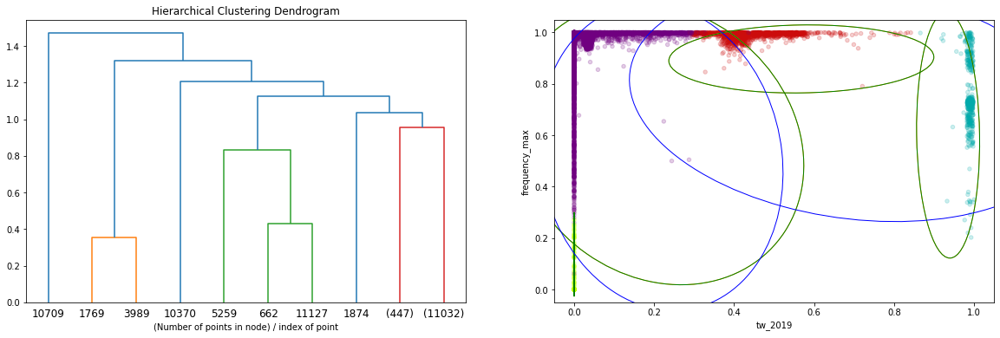

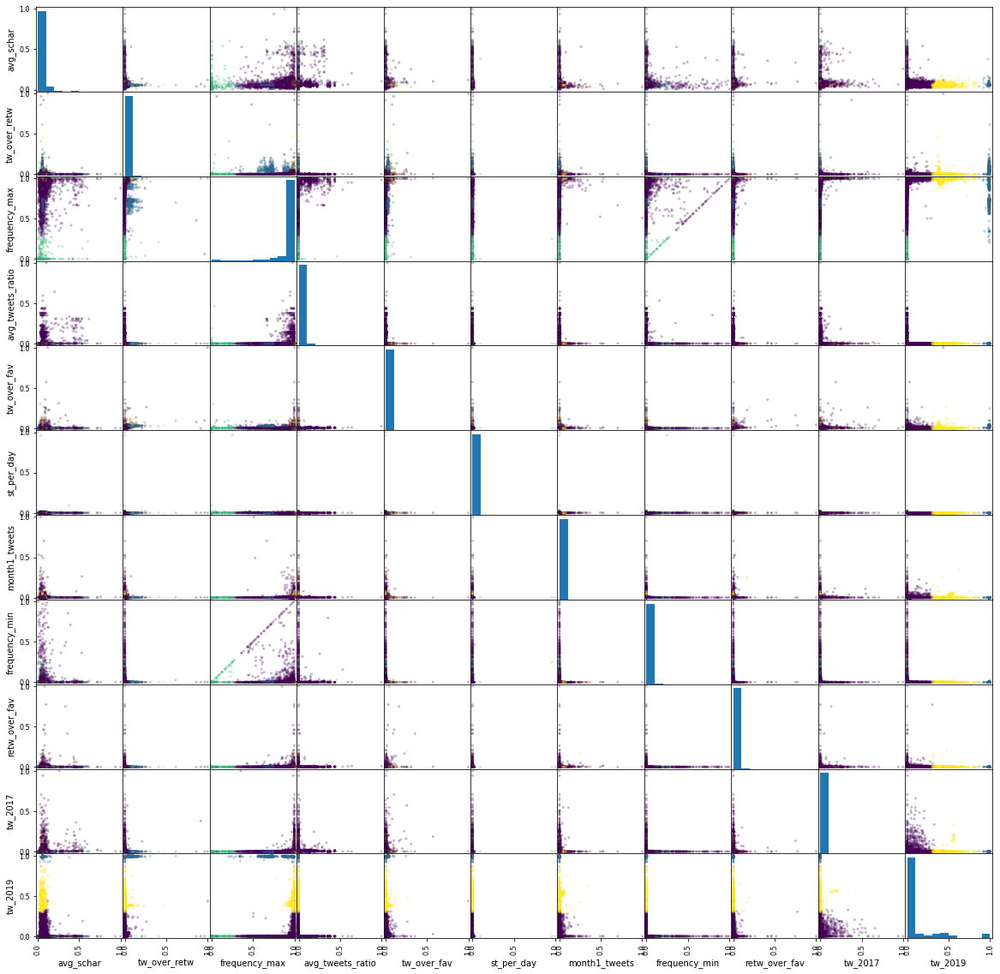

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['minmax(statistical(df))'],view=["tw_2019","frequency_max"],linkage="average",n_clusters=4)#["avg_tweets_ratio","retw_over_fav"]

<ipython-input-25-170b9275dd7c>:10: RuntimeWarning: divide by zero encountered in double_scalars
  a=np.degrees(np.arctan(R[1,0]/R[0,0]))
<ipython-input-25-170b9275dd7c>:10: RuntimeWarning: divide by zero encountered in double_scalars
  a=np.degrees(np.arctan(R[1,0]/R[0,0]))


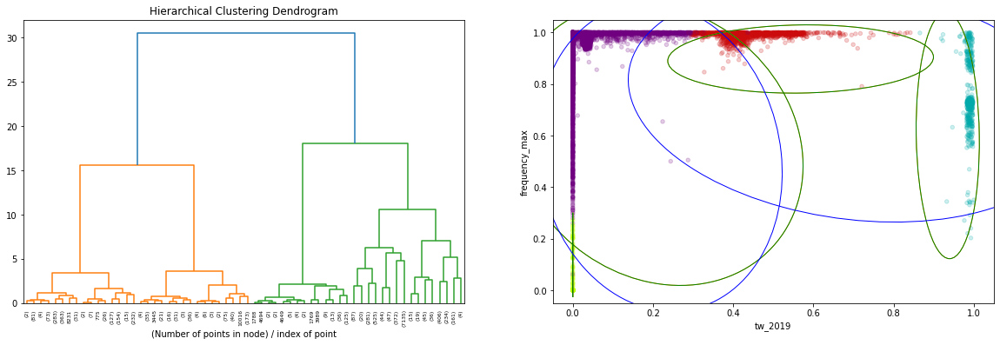

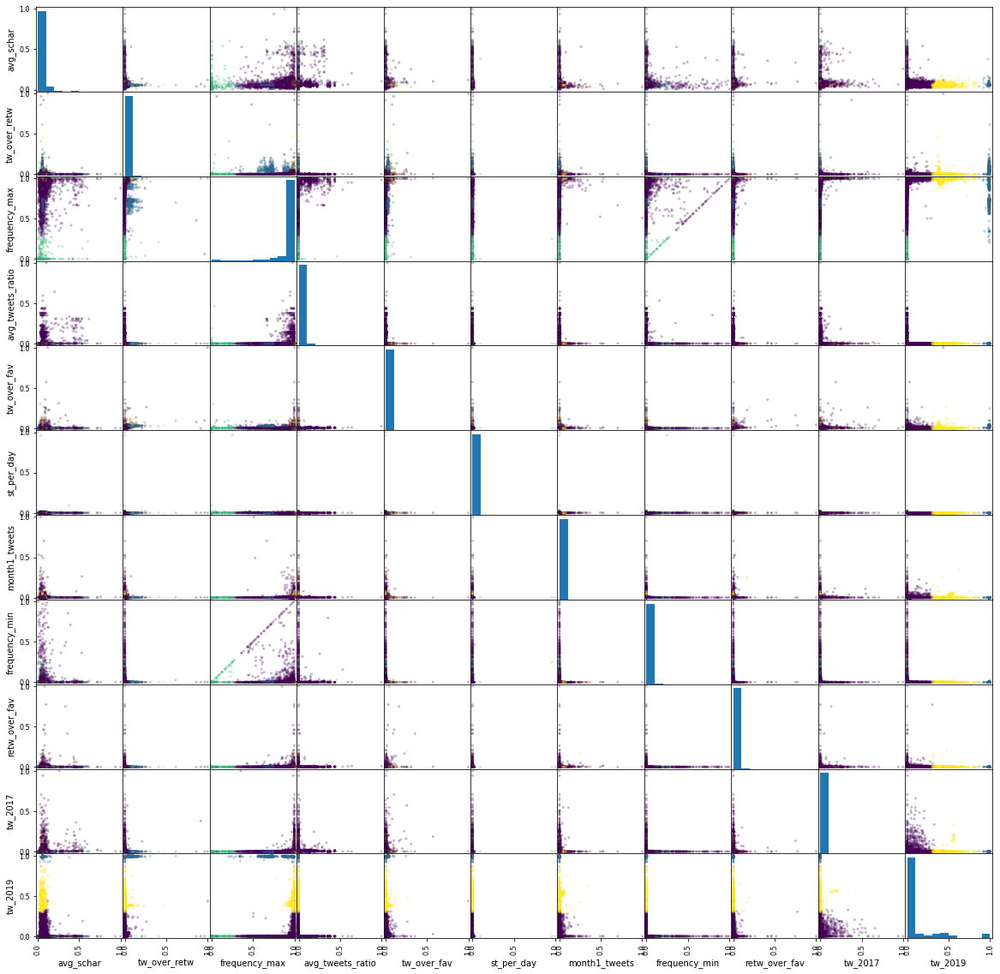

In [ ]:
#avg linkage performs badly, the dendrogram form ward linkage looked better:
labels = my_agg_h_clustering(data=cl_dfs['minmax(statistical(df))'],view=["tw_2019","frequency_max"],linkage="ward",n_clusters=4)#["avg_tweets_ratio","retw_over_fav"]

##### minmax(pca4(statistical(df)))

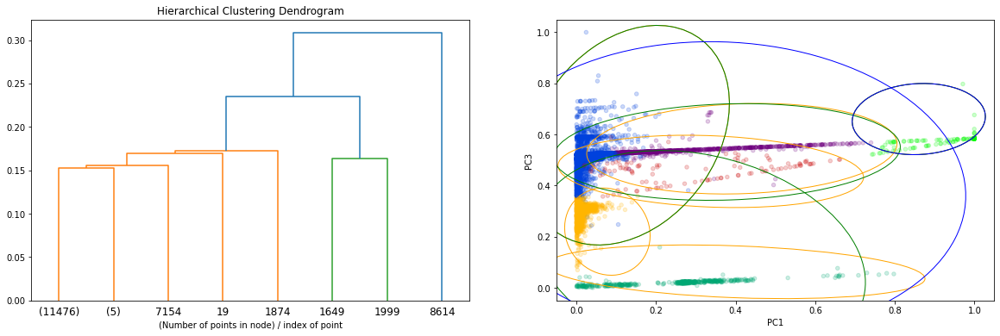

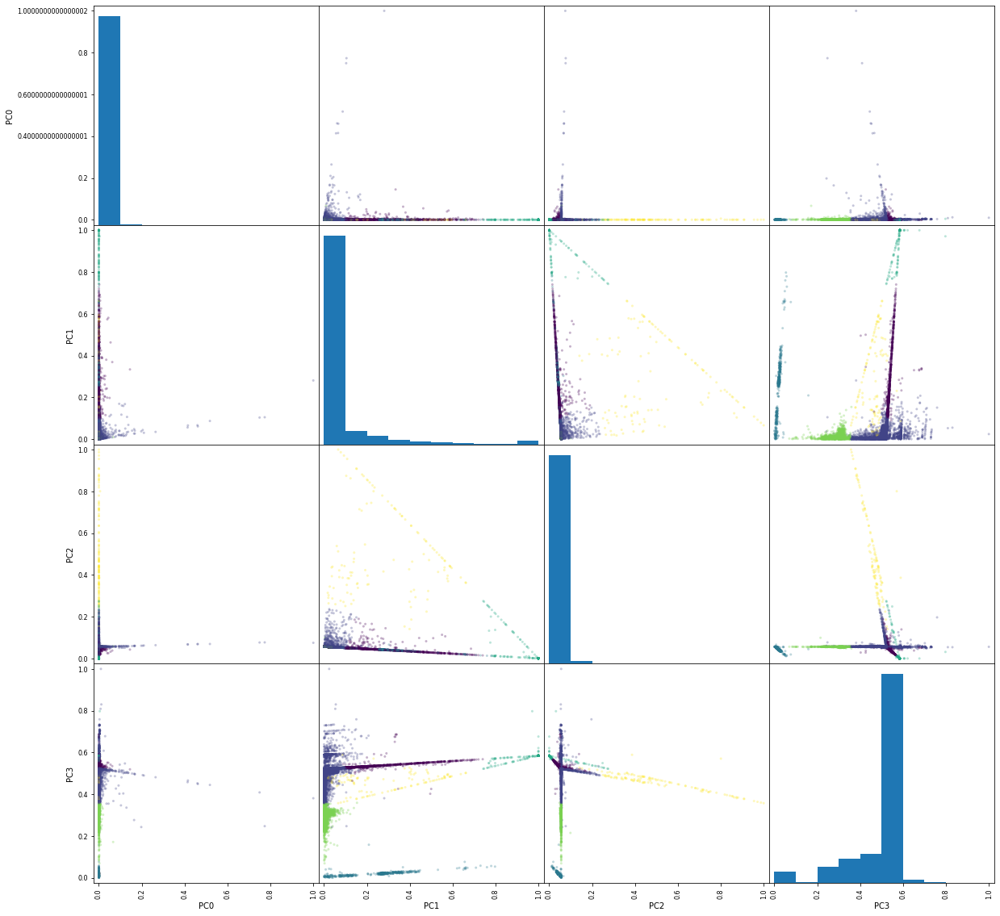

In [ ]:
labels = my_agg_h_clustering(data=cl_dfs['minmax(pca4(statistical(df)))'],view=["PC1","PC3"],linkage="single",n_clusters=6)

In [ ]:
del cl_dfs['minmax(pca4(statistical(df)))']['labels1']

In [ ]:
for i in range(4):
    print(sum(labels==i))

958
8390
451
204


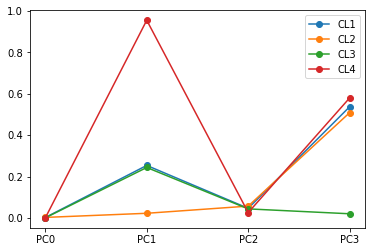

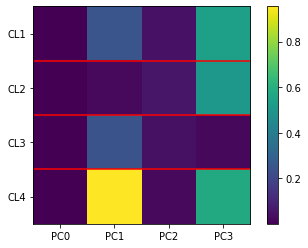

In [ ]:
cluster_names = [f"CL{i}" for i in range(4)]
for lab,i in zip(cluster_names,range(4)):
    plt.plot(cl_dfs['minmax(pca4(statistical(df)))'][labels==i].mean(),'-o',label=lab)
plt.legend()
plt.show()
plt.imshow(np.vstack([cl_dfs['minmax(pca4(statistical(df)))'][labels==i].mean() for i in range(4)]))
for i in range(3):
  plt.axhline(y=0.5+i, color='r', linestyle='-')
plt.gca().set_xticks([0,1,2,3])
plt.gca().set_xticklabels([f"PC{i}" for i in range(4)])
plt.gca().set_yticks([0,1,2,3])
plt.gca().set_yticklabels(cluster_names)
plt.colorbar()
plt.show()

##2.5 X-MEANS (pyclustering)

In [ ]:
users_full = pd.read_csv(basepath + '/pp_users_full.csv')

In [ ]:
!pip install pyclustering

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.6 MB 5.2 MB/s 
  Created wheel for pyclustering: filename=pyclustering-0.10.1.2-py3-none-any.whl size=2395121 sha256=33260aa667f8c35bca82dd717084c2bc72d2ef86d1f7279dd2f7e7084b445d43
  Stored in directory: /root/.cache/pip/wheels/dc/25/8b/072b221a5cff4f04e7999d39ca1b6cb5dad702cc3e1da951d4
Successfully built pyclustering


In [ ]:
users_full.drop(columns=["user_id"], inplace=True)

In [ ]:
from pyclustering.samples.definitions import SIMPLE_SAMPLES, FCPS_SAMPLES

from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer

from pyclustering.cluster import cluster_visualizer, cluster_visualizer_multidim
from pyclustering.cluster.xmeans import xmeans, splitting_type

from pyclustering.utils import read_sample

# sample for cluster analysis (represented by list)
sample = users_full.values

# create object of X-Means algorithm that uses CCORE for processing
# initial centers - optional parameter, if it is None, then random centers will be used by the algorithm.
# let's avoid random initial centers and initialize them using K-Means++ method:
initial_centers = kmeans_plusplus_initializer(sample, 2).initialize()
xmeans_instance = xmeans(sample, initial_centers)

# run cluster analysis
xmeans_instance.process()

# obtain results of clustering
clusters = xmeans_instance.get_clusters()
centroids = xmeans_instance.get_centers()

Let's see how many clusters XMeans algorithm has found:

In [ ]:
len(centroids)

20

How many points in each cluster?

In [ ]:
points_in_clusters = [len(i) for i in clusters]

In [ ]:
points_in_clusters

[8924,
 720,
 362,
 465,
 258,
 216,
 166,
 116,
 70,
 44,
 34,
 24,
 13,
 23,
 16,
 11,
 6,
 11,
 5,
 3]

In [ ]:
round((8924/len(users_full))*100, 3)

77.688

It seems that there is a big cluster with more than 77% of data, while other points are distributed among the other 19 clusters. So, XMeans does not find a good clustering

(0.0, 100.0)

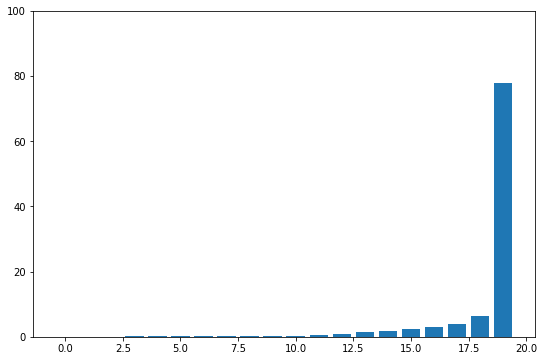

In [ ]:
plt.figure(figsize=(9,6))
plt.bar(range(len(points_in_clusters)), sorted([(x/len(users_full))*100 for x in points_in_clusters]))
plt.ylim(0,100)

We try to visualize the clusters:

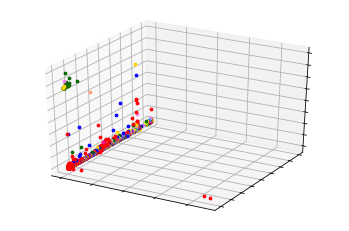

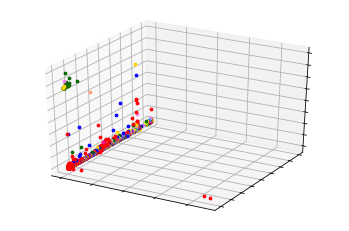

In [ ]:
# display allocated clusters
visualizer = cluster_visualizer()
visualizer.append_clusters(clusters, sample[:,1:4])
# visualizer.append_cluster(clusters.centers, None, marker = '*')
visualizer.show()

We now visualize all the possible combinations of features through the function cluster_visualizer_multidim:

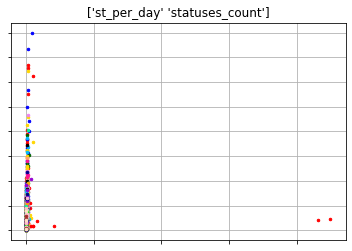

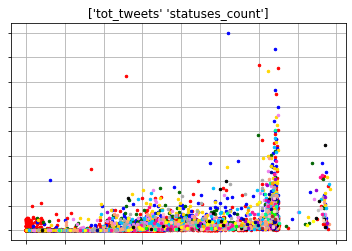

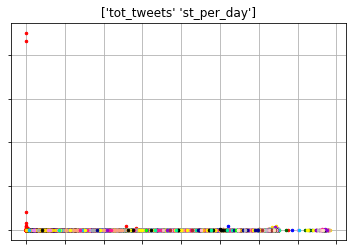

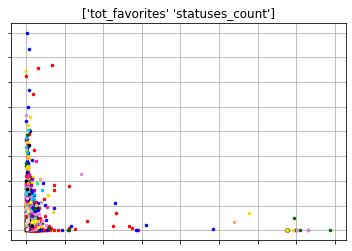

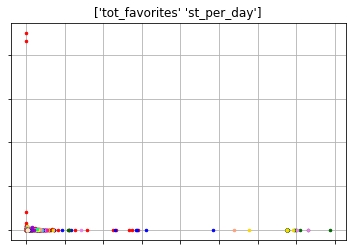

...

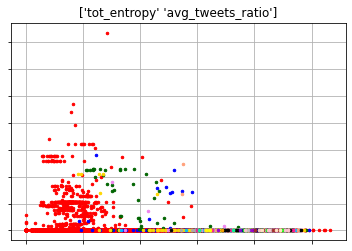

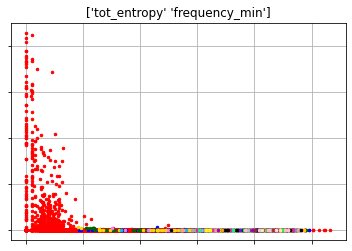

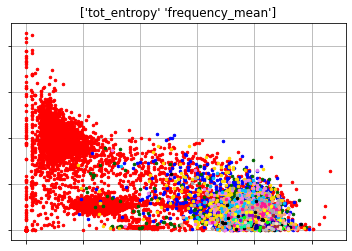

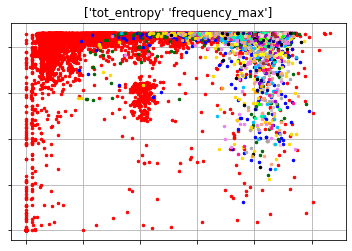

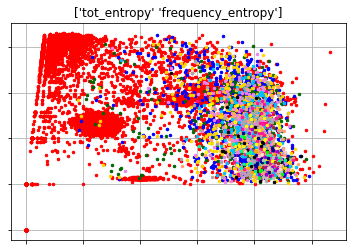

In [ ]:
for i in range(1,len(clusters)):
    for j in range(i):
        visualizer = cluster_visualizer(titles=[str(users_full.keys().values[[i,j]])])
        visualizer.append_clusters(clusters, sample[:,[i,j]].tolist())
        visualizer.show()